# Imports

In [1]:
root_dir = '../'
# root_dir = '/data_clear/alberto/projects/decentralization/decentralization/'

In [2]:
import gzip
import pickle
import json
import platform 
from random import choice
import scipy.stats
import gi
from gi.repository import Gtk, Gdk
import graph_tool.all as gt
import graph_tool as graph_tool
import pandas as pd
import numpy as np
import os
import copy
import time
from sklearn.feature_extraction import text
from nltk.stem import  WordNetLemmatizer
import re
from tqdm.notebook import tqdm
from datetime import datetime

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import random
import seaborn as sn
import networkx as nx
from networkx.drawing.nx_agraph import write_dot, graphviz_layout
from IPython.display import display

# move to repo root folder
os.chdir(root_dir)
import sys
sys.path.insert(0, os.path.join(os.getcwd(),"utils"))
from utils import sbmmultilayer 
# from hsbm.utils.nmi import * 
from utils.doc_clustering import construct_nmi_matrix # *
from hsbm_creation import *
# from hsbm_fit import *
from hsbm_partitions import *
from hsbm_analysis_topics import *
from hsbm_knowledge_flow import *

/tmp/2207198.1.all.q/ipykernel_5963/761216685.py:8: PyGIWarning: Gtk was imported without specifying a version first. Use gi.require_version('Gtk', '3.0') before import to ensure that the right version gets loaded.
  from gi.repository import Gtk, Gdk
[nltk_data] Downloading package wordnet to
[nltk_data]     /data/home/ahw701/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /data/home/ahw701/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
# DEFAULT PARAMETERS IN THE FIGURES TO BE ADJUSTED!!!!

plt.style.use("default")

height_fig = 5
width_fig = 10

params_default = {
    # no upper and right axes
    'axes.spines.right' : False,
    'axes.spines.top' : False,
    # no frame around the legend
    "legend.frameon" : False,

    # dimensions of figures and labels
    # we will play with these once we see how they are rendered in the latex
    'figure.figsize' : (width_fig, height_fig),

    'axes.labelsize' : 22,
    'axes.titlesize' : 25,
    'xtick.labelsize' : 18,
    'ytick.labelsize' : 18,
    'legend.fontsize' : 16,
    
    # no grids (?)
    'axes.grid' : False,

    # the default color(s) for lines in the plots: in order if multiple lines. We can change them or add colors if needed
#     'axes.prop_cycle' : mpl.cycler(color=["#00008B", "#BF0000", "#006400"]), 

    # default quality of the plot. Not too high but neither too low
    "savefig.dpi" : 300,
    "savefig.bbox" : 'tight', 
    
    'mathtext.fontset': 'stix',
    'font.family': 'STIXGeneral',
}

plt.rcParams.update(params_default)

In [4]:
# To make colored prints!
class print_color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

In [5]:
def split_words(string):
    '''
        Get a string and divide into list of words and other characters.
        
        Paramaters
        ----------
            string: string to split (str)
        
        Returns
        ----------
            words: list of words and characters (list of str)
    '''
    words = []
    word_tmp = ""
    for letter in string:
        if letter in "QWERTYUIOPASDFGHJKLZXCVBNMqwertyuiopasdfghjklzxcvbnm":
            word_tmp += letter
        else:
            words.append(word_tmp)
            words.append(letter)
            word_tmp = ""
    if letter in "QWERTYUIOPASDFGHJKLZXCVBNMqwertyuiopasdfghjklzxcvbnm":
        words.append(word_tmp)
    return words

# Loading data

In [6]:
corpus_version = '2022-01-01' # '2021-09-01' '2022-01-01'
all_dataset_path = f"data/{corpus_version}/"
dataset_path = f"data/{corpus_version}/decentralization/"
paper_figures_folder = f"figures/"

In [7]:
filter_label = '' # if you want a specific label to do some testing
min_inCitations = 0
min_word_occurences = 5
use_titles = True

In [8]:
results_folder = os.path.join(dataset_path,f'{min_inCitations}_min_inCitations_{min_word_occurences}_min_word_occurrences/')

chosen_text_attribute = 'paperAbstract'
if use_titles:
    # USE TITLES TEXT INSTEAD OF ABSTRACTS
    print('Using titles text instead of abstracts!', flush=True)
    chosen_text_attribute = 'title'
    results_folder = results_folder[:-1] + '_titles/'
prep_results_folder = results_folder

# results_folder += 'ID_1_no_iterMC_5000/'
results_folder += 'consensus_all_100_iter/'

Using titles text instead of abstracts!


In [9]:
number_iterations_MC_equilibrate = 5000
ID_iteration_list = list(range(1,101))
dir_list = [os.path.join(results_folder, f'ID_{ID_iteration}_no_iterMC_{number_iterations_MC_equilibrate}/') for ID_iteration in ID_iteration_list]

## Load prep files

In [10]:
print('Loading data set')
with gzip.open(f'{dataset_path}papers_dict.pkl.gz', 'rb') as fp:
    all_docs_dict = pickle.load(fp)

print(all_docs_dict[list(all_docs_dict.keys())[0]].keys())

# Check that every doc has the chosen attribute
all_docs_dict = {x:all_docs_dict[x] for x in all_docs_dict if chosen_text_attribute in all_docs_dict[x] and all_docs_dict[x][chosen_text_attribute] is not None and len(all_docs_dict[x][chosen_text_attribute])>0}
print('total number of docs: %d'%(len(all_docs_dict)))

Loading data set
dict_keys(['id', 'title', 'paperAbstract', 'authors', 'inCitations', 'outCitations', 'year', 's2Url', 'sources', 'pdfUrls', 'venue', 'journalName', 'journalVolume', 'journalPages', 'doi', 'doiUrl', 'pmid', 'fieldsOfStudy', 'magId', 's2PdfUrl', 'entities'])
total number of docs: 425144


In [11]:
# tokenized texts
tokenized_texts_dict = load_tokenized_texts_dict(
    all_docs_dict, 
    prep_results_folder, 
    chosen_text_attribute=chosen_text_attribute, 
    file_name = 'tokenized_texts_dict_all.pkl.gz'
)

tokenized_texts_dict loaded from file.


In [12]:
# article category (fields of study)
article_category = load_article_category(
    all_docs_dict, 
    prep_results_folder, 
    file_name = 'article_category_all.pkl.gz'
)

article_category loaded from file.


In [13]:
# citations edgelist (hyperlinks)
sorted_paper_ids_with_texts = list(tokenized_texts_dict.keys())
citations_df = load_citations_edgelist(
    all_docs_dict, 
    sorted_paper_ids_with_texts, 
    prep_results_folder, 
    file_name = 'citations_edgelist_all.csv'
)

citations_edgelist loaded from file.


In [14]:
# FILTER NETWORK
ordered_papers_with_cits, new_filtered_words, IDs, texts, edited_text = filter_dataset(
    all_docs_dict,
    tokenized_texts_dict,
    min_inCitations,
    min_word_occurences,
    prep_results_folder,
    filter_label,
)

original number of docs 425144
original number of different words 173198
filtered number of docs 181605
filtered number of different words 65054
number of doc-doc links: 590215
Number of new filtered words 15381
number of word-doc links: 1396830


In [15]:
# CREATE GT OBJECT
hyperlink_g, hyperlinks = create_hyperlink_g(
    article_category,
    prep_results_folder,
    filter_label
)


Loaded gt object


In [16]:
# ACHTUNG: h_t_doc_consensus is (for some reason) not ordered like edited_text, 
# but with the same order as hyperlink_g.vp['name']... 
ordered_paper_ids = list(hyperlink_g.vp['name'])
all_papers_ids = set(ordered_paper_ids)
# ordered_edited_texts = [edited_text[IDs.index(paper_id)] for paper_id in ordered_paper_ids]

In [17]:
# COMPUTE CENTRALITIES
centralities = load_centralities(
    all_docs_dict,
    citations_df,
    ordered_paper_ids,
    hyperlink_g, 
    prep_results_folder,
    filter_label,
)
print('\nFinished retrieving preparation files.')


Loaded centralities.

Finished retrieving preparation files.


## Retrieve hSBM results

In [18]:
# Retrieve the partitions assigned to the document nodes by examining the highest non-trivial level of the hierarchical degree-corrected SBM.
hyperlink_text_hsbm_partitions, levels = get_highest_level_hsbm_partitions_from_iterations(
    hyperlink_g,
    dir_list, 
    results_folder,
)
print('Highest levels in each state:')
print(levels)

Loaded 100 partitions from data/2022-01-01/decentralization/0_min_inCitations_5_min_word_occurrences_titles/consensus_all_100_iter/
Highest levels in each state:
[5, 5, 5, 5, 6, 5, 6, 5, 4, 5, 5, 7, 5, 5, 6, 5, 5, 7, 5, 5, 6, 5, 6, 5, 6, 5, 6, 7, 5, 5, 6, 5, 5, 6, 5, 6, 6, 5, 6, 8, 5, 5, 6, 6, 5, 6, 5, 6, 5, 5, 5, 7, 6, 5, 6, 5, 4, 6, 5, 5, 6, 5, 6, 6, 5, 5, 6, 5, 5, 5, 5, 6, 6, 4, 6, 5, 5, 6, 4, 7, 5, 5, 5, 7, 6, 4, 5, 7, 5, 7, 6, 5, 6, 6, 5, 5, 5, 7, 7, 7]


In [19]:
# Compute the consensus partition assignment to document nodes over all the runs.
hyperlink_text_hsbm_partitions_by_level,duration = get_hsbm_partitions_from_iterations(
    hyperlink_g,
    dir_list, 
    levels,
    results_folder,
)

Loaded partitions from data/2022-01-01/decentralization/0_min_inCitations_5_min_word_occurrences_titles/consensus_all_100_iter/


In [20]:
H_T_word_hsbm_partitions_by_level, H_T_word_hsbm_num_groups_by_level = get_hsbm_word_partitions_from_iterations(
    hyperlink_g,
    dir_list, 
    levels,
    results_folder,
    IDs
)

Loaded word partitions from data/2022-01-01/decentralization/0_min_inCitations_5_min_word_occurrences_titles/consensus_all_100_iter/


In [21]:
h_t_doc_consensus_by_level, h_t_word_consensus_by_level, h_t_consensus_summary_by_level = get_consensus(
    dir_list,
    hyperlink_text_hsbm_partitions_by_level,
    H_T_word_hsbm_partitions_by_level,
    ordered_paper_ids,
    results_folder,
    filter_label = ''
)

Loaded consensus from file


In [22]:
# We can now retrieve the top 10 words associated to topics associated to the consensus partition thanks to topics_df_by_level
topics_df_by_level, mixture_proportion_by_level, normalized_mixture_proportion_by_level, avg_topic_frequency_by_level = get_mixture_proportion(
    h_t_doc_consensus_by_level = h_t_doc_consensus_by_level, 
    results_folder = results_folder,
    ordered_edited_texts = None,
    dict_groups_by_level = None, 
    topics_df_by_level = None,
    filter_label = ''
)

Loaded mixture proportion from file


In [23]:
highest_non_trivial_level = sorted(topics_df_by_level.keys())[-1]
highest_non_trivial_level

6

In [24]:
# let's also take the mixture proportion from one cluster at one level to another topic at any other level
mixture_proportion_by_level_partition_by_level_topics, normalized_mixture_proportion_by_level_partition_by_level_topics, avg_topic_frequency_by_level_partition_by_level_topics = get_mixture_proportion_by_level(
    h_t_doc_consensus_by_level = h_t_doc_consensus_by_level, 
    dict_groups_by_level = None, 
    ordered_edited_texts = None,
    topics_df_by_level = None,
    highest_non_trivial_level = highest_non_trivial_level,
    results_folder = results_folder,
    filter_label = ''
)

Loaded mixture proportion by level from file


In [25]:
# Hierarchy dictionary, to see which clusters at one level below belong to a certain cluster
hierarchy_docs,hierarchy_words = get_hierarchy(
    highest_non_trivial_level = highest_non_trivial_level,
    h_t_doc_consensus_by_level = h_t_doc_consensus_by_level,
    h_t_word_consensus_by_level = h_t_word_consensus_by_level,
    results_folder = results_folder,
    filter_label = filter_label,
)

Loaded hierarchy from file


### name2partition

In [26]:
# WORKS WITH MORE THAN 1 ITERATION (in teoria va bene sempre...)
name2partition_by_level = {max(list(h_t_doc_consensus_by_level.keys()))+1 : {x:0 for x in ordered_paper_ids}}

for level in h_t_doc_consensus_by_level.keys():
    name2partition_by_level[level] = {}
    for i,paper_id in enumerate(list(hyperlink_g.vp["name"])):
        name2partition_by_level[level][paper_id] = h_t_doc_consensus_by_level[level][i]

In [27]:
doc_partition_remapping_by_level = {}
doc_partition_remapping_by_level_inverse = {}
for level in name2partition_by_level:
    if level != max(list(h_t_doc_consensus_by_level.keys()))+1:
        # level = 3
        doc_partition_remapping_by_level[level] = {}
        doc_partition_remapping_by_level_inverse[level] = {}
        lista1 = []
        for paper in ordered_paper_ids:
            lista1.append(name2partition_by_level[level][paper])
    #     lista2 = hyperlink_text_consensus_partitions_by_level[level]
        lista2 = h_t_doc_consensus_by_level[level]
    #     print(set(list(zip(lista1,lista2))))
        for part1, part2 in set(list(zip(lista1,lista2))):
            if part1 in doc_partition_remapping_by_level[level]:
                print("THERE ARE MULTIPLE INSTANCES... ERROR")
                break
            else:
                doc_partition_remapping_by_level[level][part1] = part2  
                doc_partition_remapping_by_level_inverse[level][part2] = part1

### KF

In [28]:
knowledge_flow_normalized_per_field_per_time_window_to_future_by_level = {}
for lev in [2,3]:
    with gzip.open(f"{results_folder}knowledge_flow_normalized_per_cluster_per_time_window_to_future_df_gt_partition_lev_{lev}.pkl.gz","rb") as fp:
        knowledge_flow_normalized_per_field_per_time_window_to_future_by_level[lev] = pickle.load(fp)

In [29]:
gt_partition_level = 2
all_docs_dict, assigned_cluster_dict, all_clusters = assign_partition(
    h_t_doc_consensus_by_level,
    hyperlink_g,
    gt_partition_level,
    all_docs_dict,
)

# Analysis of topics

## Normalized mixture proportion between topics and clusters

In [30]:
l = highest_non_trivial_level - 2

topic_doc_df = pd.DataFrame(normalized_mixture_proportion_by_level[l])

def _color_red_or_green(val, t = 0.1):
    if val < -t:
        color = 'red'
    elif val > t:
        color = 'green'
    else:
        color = 'grey'
    
    return 'color: %s' % color

topic_doc_df.style.applymap(_color_red_or_green,t=0.1)

,doc_group 0,doc_group 1,doc_group 2,doc_group 3,doc_group 4,doc_group 5,doc_group 6,doc_group 7,doc_group 8
topic 0,0.101889,0.212701,-0.237352,-0.252851,0.175418,0.288686,-0.075801,0.113666,0.460222
topic 1,-0.066884,-0.165462,0.339121,0.106141,-0.039313,-0.162551,-0.382945,0.066621,-0.300451
topic 2,-0.299015,-0.325709,-0.441748,0.915676,-0.803044,-0.782698,2.478026,-0.934741,-0.949212
topic 3,0.265795,0.076180,-0.059471,-0.278729,0.170655,0.157410,-0.263621,-0.021734,0.087624
topic 4,0.101127,0.378951,-0.426471,-0.147729,0.016548,0.660770,-0.223536,-1.000000,-1.000000


## Check hierarchy topics

In [31]:
l = highest_non_trivial_level - 1

for i in range(len(hierarchy_words[l])):
    m = min(hierarchy_words[l])
    m2 = min(hierarchy_words[l-1])

    print(f"LEVEL {l} -- TOPIC {i}")
    print(topics_df_by_level[l][i].iloc[:20],flush=True)#[range(0,15)]
    print(f"\n\nLEVEL {l-1}")
    print(topics_df_by_level[l-1][np.array(list(hierarchy_words[l][i+m])) - m2].iloc[:20],flush=True)#[range(0,15)]
    print("\n\n\n---------------------------------------------------------------------------------------\n\n\n")

LEVEL 5 -- TOPIC 0
0        decentralized
1               system
2                based
3              control
4              network
5          distributed
6           management
7             networks
8                using
9                multi
10             systems
11    decentralization
12               power
13                data
14            approach
15            analysis
16              energy
17               model
18          blockchain
19         centralized
Name: 0, dtype: object


LEVEL 4
                0                 1                  2               3
0   decentralized             based         technology             new
1          system        management               flow          demand
2         control  decentralization  descentralización             key
3         network             local                 em       evolution
4     distributed             study   décentralisation        autonomy
5        networks           service       technologies        

# Analysis of docs

In [32]:
year_cluster_field_no_papers_df_by_level = {}
for level in tqdm(name2partition_by_level.keys()):
    dict_nested = {}
    for paper_id,cluster in name2partition_by_level[level].items():
        paper = all_docs_dict[paper_id]
        year = paper["year"]
        if year is not None:
            for field in paper["fieldsOfStudy"]:
                dict_nested.setdefault(field,{}).setdefault(cluster,{y:0 for y in range(1950,2022)})
                dict_nested[field][cluster].setdefault(year,0) 
                dict_nested[field][cluster][year] += 1./len(paper["fieldsOfStudy"])

    dict_for_df = {"year":[], "cluster":[], "field":[], "no_papers":[]}
    for field,_ in dict_nested.items():
        for cluster,_2 in _.items():
            for year,no_papers in _2.items():
                dict_for_df["year"].append(int(year))
                dict_for_df["cluster"].append(cluster)
                dict_for_df["field"].append(field)
                dict_for_df["no_papers"].append(no_papers)
    year_cluster_field_no_papers_df_by_level[level] = pd.DataFrame(dict_for_df)    

  0%|          | 0/8 [00:00<?, ?it/s]

## Functions

In [33]:
def get_most_represented_topic(level_partition, partition, level_topic):
    if level_topic >= max(list(hierarchy_words.keys())):
        return 0
    else:
        p = partition
        p_remapped = doc_partition_remapping_by_level[level_partition][p]
    #     print(print_color.UNDERLINE + print_color.BOLD + print_color.RED + "PARTITION %d\n"%(p_remapped) + print_color.END)
        tmp = pd.Series({key:value for key,value in normalized_mixture_proportion_by_level_partition_by_level_topics[level_partition][level_topic]["doc_group %d"%p_remapped].items() if topics_df_by_level[level_topic][int(key[6:])].notna().sum()>0}).sort_values(ascending=False)

        return int(tmp.index[0][6:])

In [34]:
def name_node(level, index, list_labels = [], num_spaces = 200):
    if len(list_labels) == 0:
        return f"{level}_{index}"
    else:
        string = f"" # f"{level}_{index}"
        for _ in list_labels:
            string += "\n" + " "*num_spaces + "%s"%_ + " "*num_spaces
        return string

In [35]:
def topic_mixture_proportion(dict_groups,edited_text, document_partitions):

    topics = dict_groups.keys()
    partitions = np.unique(document_partitions)

    avg_topic_frequency = {}
    mixture_proportion = {}
    normalized_mixture_proportion = {}

    doc_texts = np.array(edited_text, dtype=object)

    n_i_t = {}

    topic_doc_group_words = {}

    for doc_group in partitions:
        topic_doc_group_words[doc_group] = set()
        for i,doc_group_membership in enumerate(document_partitions):
            if doc_group_membership != doc_group:
                continue
            topic_doc_group_words[doc_group] = topic_doc_group_words[doc_group].union(set(edited_text[i]))

    for topic in topics:
        topic_words = set([x[0] for x in dict_groups[topic]])
        n_i_t[topic] = {}

        for doc_group in partitions:
            n_i_t[topic][doc_group] = len(topic_words.intersection(topic_doc_group_words[doc_group]))

    for doc_group in partitions:
        mixture_proportion[f"doc_group {doc_group}"] = {}
        for topic in topics:
            mixture_proportion[f"doc_group {doc_group}"][f"topic {topic}"] = n_i_t[topic][doc_group] / np.sum([n_i_t[topic_j][doc_group] for topic_j in topics])

    S = np.sum([n_i_t[topic_j][doc_group] for doc_group in partitions for topic_j in topics])
    for topic in topics:
        avg_topic_frequency[f"topic {topic}"] = np.sum([n_i_t[topic][doc_group] for doc_group in partitions]) / S

    for doc_group in partitions:
        normalized_mixture_proportion[f"doc_group {doc_group}"] = {}
        for topic in topics:
            normalized_mixture_proportion[f"doc_group {doc_group}"][f"topic {topic}"] = ( mixture_proportion[f"doc_group {doc_group}"][f"topic {topic}"] - avg_topic_frequency[f"topic {topic}"] ) / avg_topic_frequency[f"topic {topic}"]

    return mixture_proportion, normalized_mixture_proportion, avg_topic_frequency

In [36]:
def get_mixture_proportion_between_cluster_and_topic(level_partition, partition, level_topic, topic):
    if level_topic >= max(list(hierarchy_words.keys())):
        m2 = min(hierarchy_words[max(list(hierarchy_words.keys()))][0])
        return np.max([get_mixture_proportion_between_cluster_and_topic(level_partition, partition, max(list(hierarchy_words.keys()))-1, t-m2) for t in hierarchy_words[max(list(hierarchy_words.keys()))][0]])
    p_remapped = doc_partition_remapping_by_level[level_partition][partition]
    if topics_df_by_level[level_topic][topic].notna().sum() < 10:
        mixture_proportion = -1
    else:
        mixture_proportion = normalized_mixture_proportion_by_level_partition_by_level_topics[level_partition][level_topic][f"doc_group {p_remapped}"][f"topic {topic}"]
    return mixture_proportion

In [37]:
def topics_to_print(level_partition,partition,top_level_topics, bottom_level_topics, max_num_topics_to_represent):
    
    node_size = {}
    root = get_most_represented_topic(level_partition, partition, top_level_topics)
    root_name = name_node(top_level_topics,root)
    node_size[root_name] = get_mixture_proportion_between_cluster_and_topic(level_partition, partition, top_level_topics, root)
            

    # this is just to remember which nodes have been selected at each level
    selected_nodes_by_level = {top_level_topics:[root]}
    
    # Let's add all the children until bottom_level from root, saving node_size of each node as the normalized mixture proportion
    # ACHTUNG: All names are of the type level_index, then they will be changed!
    for l in range(top_level_topics, bottom_level_topics,-1):
        selected_nodes_by_level[l-1] = []
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_words[l])
            m2 = min(hierarchy_words[l-1])
            
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_words[l][i+m])) - m2
            selected_nodes_by_level[l-1] += list(children)
            
            for child in children:
                child_name = name_node(l-1,child)
                node_size[child_name] = get_mixture_proportion_between_cluster_and_topic(level_partition, partition, l-1, child)
    
    # There are nodes with negative node_size, so in order to display all of them correctly let's subtract the minimum
    min_node_size_old = min(list(node_size.values()))
    max_node_size_old = max(list(node_size.values()))
    node_size_old = node_size.copy()
    node_size = {x:y - min_node_size_old  for x,y in node_size.items()}
    min_node_size = min(list(node_size.values()))
    max_node_size = max(list(node_size.values()))
    
    
    edge_size_sum = {}
    node_colors = {}
    
    # Let's highlight the top 10 topics at the bottom level, changing their names to the list of words in their topic
    
    l = bottom_level_topics + 1
    leaves = {}
    for i in selected_nodes_by_level[l]:
        m = min(hierarchy_words[l])
        m2 = min(hierarchy_words[l-1])
        # topics at lower level in the hierarchy from the superior node
        children = np.array(list(hierarchy_words[l][i+m])) - m2
        for child in children:
            child_name = name_node(l-1,child)
            if node_size_old[child_name] > 0:
                leaves[child_name] = node_size_old[child_name]
    leaves = pd.Series(leaves)
    highlighted_leaves = list(leaves.loc[leaves>0].sort_values(ascending=False).iloc[:max_num_topics_to_represent].index.values)
        
    return [int(x[2:]) for x in highlighted_leaves]

In [38]:
def sample_knowledge_flow(level,cluster,threshold, time_window, num_papers_to_show, most_frequent_words):
    """ 
        selecting the best paper(s) contributing to the knowledge flow between cluster and cluster2 from the time_period to the future        
    """
        
    knowl_flow_tmp = knowledge_flow_normalized_per_field_per_time_window_to_future_by_level[level][time_window]
    knowl_flow_tmp = knowl_flow_tmp.loc[knowl_flow_tmp.cluster_from==cluster]
    time_periods_from = list(knowl_flow_tmp[f'time_window_{time_window}_years_from'].unique())

    for time_period_from in time_periods_from[-1:]:
        range_time_period = range(time_period_from,time_period_from+time_window+1)
        set_papers_study = set([x for x in ordered_paper_ids if cluster in all_docs_dict[x]['assigned_cluster_list'] and all_docs_dict[x]['year'] in range_time_period])
        papers_in_study_dict = {}

        for paper_id in set_papers_study:
            paper = all_docs_dict[paper_id]
            papers_in_study_dict[paper_id] = {"no_citations_all":len(paper["inCitations"]), "no_knowledge_units_all":len(paper["inCitations"])/len(paper['assigned_cluster_list']), 
                                             "no_citations":len(set(paper["inCitations"]).intersection(all_papers_ids)), "no_knowledge_units":len(set(paper["inCitations"]).intersection(all_papers_ids))/len(paper['assigned_cluster_list']) }
            tmp_count = {field:0 for field in all_clusters}
            for citing_paper_id in set(paper["inCitations"]).intersection(all_papers_ids):
                citing_paper = all_docs_dict[citing_paper_id]
                for chosen_edge_field in citing_paper['assigned_cluster_list']:
                    tmp_count[chosen_edge_field] += 1/len(paper['assigned_cluster_list'])/len(citing_paper['assigned_cluster_list'])
            for field in all_clusters:
                papers_in_study_dict[paper_id][field] = tmp_count[field]
        if len(set_papers_study) != 0:
            papers_in_study_df = pd.DataFrame(papers_in_study_dict).transpose()
            knowledge_flows = knowl_flow_tmp.loc[knowl_flow_tmp[f'time_window_{time_window}_years_from']==time_period_from]
            knowledge_flows = knowledge_flows.loc[knowledge_flows.significant_kf > threshold]
            z_scores = list(knowledge_flows.significant_kf)
            clusters2 = list(knowledge_flows.cluster_to)

            for i in range(len(z_scores)):
                z_score = z_scores[i]
                cluster2 = clusters2[i]
                if z_score > threshold:
                    selected_papers = papers_in_study_df[cluster2].sort_values(ascending=False).iloc[:num_papers_to_show].index.values

                    for paper in selected_papers:

                        print(f"({time_period_from} to {time_period_from+time_window-1} : {z_score} to {cluster2} - {papers_in_study_df[cluster2].loc[paper]} cits)",end = " ")
                        if all_docs_dict[paper]["year"] != None:
                            print("y=%d"%all_docs_dict[paper]["year"],end = " ")
                        print("FoS=[",end = "")
                        for field in all_docs_dict[paper]["fieldsOfStudy"]:
                            print("%s"%field,end = ", ")
                        if len(all_docs_dict[paper]["fieldsOfStudy"]) == 0:
                            print("None",end = ", ")
                        print("] - ", end = "")
                        for word in split_words(all_docs_dict[paper]['title']):
                            if pd.notna(word):
                                if word.lower() in most_frequent_words:
                                    print(print_color.BOLD + print_color.RED + word + print_color.END, end="")
                                else:
                                    print(word,end="")
                        print(f" --> {all_docs_dict[paper]['doiUrl']}")

### def create_hierarchy_network_topics

In [39]:
def create_hierarchy_network_topics(level_partition, partition, top_level_topics, bottom_level_topics, 
                             max_num_topics_to_represent, num_words_to_represent, ax,
                             multiplicator_size_nodes=1, multiplicator_size_edges=1,
                             multiplicator_ypos=0.1,
                             fontsize = 10):
    if level_partition > max(list(hierarchy_words.keys())):
        level_partition = max(list(hierarchy_words.keys())) + 1
    cmap = matplotlib.cm.get_cmap('coolwarm')#('winter') coolwarm
    # Let's create a tree undirected network
    G = nx.DiGraph()
    # this is just for drawing
    node_size = {} # key is node name
    edge_size = {} # key is tuple of source,target
    
    # let's find the root at the top_level of topics as the one with highest normalized mixture proportion with the chosen cluster
    root = get_most_represented_topic(level_partition, partition, top_level_topics)
    root_name = name_node(top_level_topics,root)
    node_size[root_name] = get_mixture_proportion_between_cluster_and_topic(level_partition, partition, top_level_topics, root) * multiplicator_size_nodes
    G.add_node(root_name)
    
            

    # this is just to remember which nodes have been selected at each level
    selected_nodes_by_level = {top_level_topics:[root]}
    
    # Let's add all the children until bottom_level from root, saving node_size of each node as the normalized mixture proportion
    # ACHTUNG: All names are of the type level_index, then they will be changed!
    for l in range(top_level_topics, bottom_level_topics,-1):
        selected_nodes_by_level[l-1] = []
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_words[l])
            m2 = min(hierarchy_words[l-1])
            
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_words[l][i+m])) - m2
            selected_nodes_by_level[l-1] += list(children)
            
            for child in children:
                child_name = name_node(l-1,child)
                node_size[child_name] = get_mixture_proportion_between_cluster_and_topic(level_partition, partition, l-1, child) * multiplicator_size_nodes
    
    # There are nodes with negative node_size, so in order to display all of them correctly let's subtract the minimum
    min_node_size_old = min(list(node_size.values()))
    max_node_size_old = max(list(node_size.values()))
    node_size_old = node_size.copy()
    node_size = {x:y - min_node_size_old + multiplicator_size_nodes*0.05 for x,y in node_size.items()}
    min_node_size = min(list(node_size.values()))
    max_node_size = max(list(node_size.values()))
    
    
    edge_size_sum = {}
    edge_counter = {}
    node_colors = {}
    for l in range(bottom_level_topics+1,top_level_topics+1):
        # Let's highlight the top 10 topics at the bottom level, changing their names to the list of words in their topic
        if l-1 == bottom_level_topics:
            leaves = {}
            for i in selected_nodes_by_level[l]:
                m = min(hierarchy_words[l])
                m2 = min(hierarchy_words[l-1])
                # topics at lower level in the hierarchy from the superior node
                children = np.array(list(hierarchy_words[l][i+m])) - m2
                for child in children:
                    child_name = name_node(l-1,child)
                    if node_size_old[child_name] > 0:
                        leaves[child_name] = node_size_old[child_name]
            leaves = pd.Series(leaves)
            highlighted_leaves = set(leaves.loc[leaves>0].sort_values(ascending=False).iloc[:max_num_topics_to_represent].index.values)
            
        # Let's add all of these nodes in the Graph, using their new names
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_words[l])
            m2 = min(hierarchy_words[l-1])
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_words[l][i+m])) - m2
            sum_weights_children = 0
            # Let's add the nodes
            child_names = []
            father_name = name_node(l,i)
            for child in children:    
                child_name = name_node(l-1,child)
                if l-1 == bottom_level_topics:
                    if child_name in highlighted_leaves:
                        # let's substitute the name of the nodes
                        significant_string = ""
                        for _ in range(min(4,int(node_size_old[child_name]/multiplicator_size_nodes))):
                            significant_string += "*"
                        list_labels = [significant_string] + list(topics_df_by_level[l-1][child].iloc[:num_words_to_represent].values)
                        new_child_name = name_node(l-1,child, list_labels = list_labels)
                        node_size[new_child_name] = node_size[child_name]
                        del node_size[child_name]
                        highlighted_leaves.remove(child_name)
                        highlighted_leaves.add(new_child_name)
                        child_name = new_child_name
                    node_colors[child_name] = (node_size[child_name]-min_node_size)/(max_node_size-min_node_size)
                child_names.append(child_name)
                sum_weights_children += node_size[child_name]
                G.add_node(child_name)
            node_colors[father_name] = np.sum([node_colors[child_name]*node_size[child_name] for child_name in child_names])/sum_weights_children
            
                
            # Let's add the edges
            edge_size_sum[father_name] = 0
            edge_counter[father_name] = 0
            for child_name in child_names:
                if l == bottom_level_topics+1:
                    edge_size[(father_name,child_name)] = node_size[child_name] * multiplicator_size_edges
                else:
                    edge_size[(father_name,child_name)] = edge_size_sum[child_name] / edge_counter[child_name]
                edge_size_sum[father_name] += edge_size[(father_name,child_name)]
                edge_counter[father_name] += 1
                G.add_edge(father_name,child_name)
            
    
    # DRAWING
    pos = graphviz_layout(G, prog='dot')#{"fontsize":fontsize, "labelfontsize":fontsize})
    y_pos = sorted(list(set([_[1] for _ in list(pos.values())])))

    y_pos_max = y_pos[-1]
    y_pos_min = y_pos[0]
    y_pos_min_new = y_pos_min + (y_pos_max-y_pos_min)*multiplicator_ypos
    y_pos_dict = {y_pos_min:y_pos_min_new, y_pos_max:y_pos_max}
    no_mid_y = len(y_pos[1:-1])
    for index,y in enumerate(y_pos[1:-1]):
        y_pos_dict[y] = y_pos_min_new + (y_pos_max - y_pos_min_new)/(no_mid_y+1)*(index+1)
    for k,v in pos.items():
        pos[k] = (v[0],y_pos_dict[v[1]])
    nx.draw_networkx_nodes(G,pos,node_size=[node_size[node] for node in pos.keys()],ax=ax,node_color=[cmap(node_colors[node]) for node in pos.keys()])
    l = nx.draw_networkx_labels(G,pos,font_size=fontsize, font_color = 'black', font_family="STIXGeneral", labels={x:x.replace(" nan ","").replace(" ","") if len(x)>10 else "" for x in pos.keys()}, verticalalignment="top",  ax=ax)

    for i,edge in enumerate(G.edges()):
        nx.draw_networkx_edges(G, pos, edgelist=[edge], width=edge_size[edge], arrowsize=edge_size[edge]*5,edge_color = cmap(node_colors[edge[1]]),ax=ax)#arrowstyle='fancy')

    ax.axis('off')
    pos_y_values = [_[1] for _ in pos.values()]
    ax.set_ylim([min(pos_y_values)*0,max(pos_y_values)*1.05])
    return cmap, min_node_size_old/multiplicator_size_nodes, max_node_size_old/multiplicator_size_nodes

### def heatmap

In [40]:
def heatmap(df,fixed_labels, x_label, y_label, values_label,costrains_equal={}, 
            fig=None,ax=None,ax_cmap=None,subplot_spec=None,subplot_spec_heatmap=None,figsize=(12,6),
            filename="",
            ordered_cluster_labels = [],
            ordered_cluster_groups = [],
            bottom_level = 2,
            top_level = 6,
            linewidth=1,
            use_keywords=True,
            cut_small_clusters = False,
            threshold_num_papers = 1,
            do_barplot = True,
            vmax = None,
            colorbar_log = False,
            linelength = 100
           ):
    '''
        - fixed_labels_and_values_dict is a dict with the key of df to fix and his values to select!
        - If subplot_spec is not None, it must be a valid subplot_spec from gridspec, to position correctly the heatmap in the bigger picture. If this is provided, a fig must be provided to put it there.
        - if cut_small_clusters == True, remember to change threshold_num_papers
        - ACHTUNG! use cut_small_clusters and threshold_num_papers only when clusters are on y_axis
    '''
    class SeabornFig2Grid():

        def __init__(self, seaborngrid, fig,  subplot_spec):
            self.fig = fig
            self.sg = seaborngrid
            self.subplot = subplot_spec
            if isinstance(self.sg, sn.axisgrid.FacetGrid) or \
                isinstance(self.sg, sn.axisgrid.PairGrid):
                self._movegrid()
            elif isinstance(self.sg, sn.axisgrid.JointGrid):
                self._movejointgrid()
            self._finalize()

        def _movegrid(self):
            """ Move PairGrid or Facetgrid """
            self._resize()
            n = self.sg.axes.shape[0]
            m = self.sg.axes.shape[1]
            self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
            for i in range(n):
                for j in range(m):
                    self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

        def _movejointgrid(self):
            """ Move Jointgrid """
            h= self.sg.ax_joint.get_position().height
            h2= self.sg.ax_marg_x.get_position().height
            r = int(np.round(h/h2))
            self._resize()
            self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

            self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
            self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
            self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

        def _moveaxes(self, ax, gs):
            #https://stackoverflow.com/a/46906599/4124317
            ax.remove()
            ax.figure=self.fig
            self.fig.axes.append(ax)
            self.fig.add_axes(ax)
            ax._subplotspec = gs
            ax.set_position(gs.get_position(self.fig))
            ax.set_subplotspec(gs)

        def _finalize(self):
            plt.close(self.sg.fig)
            self.fig.canvas.mpl_connect("resize_event", self._resize)
            self.fig.canvas.draw()

        def _resize(self, evt=None):
            self.sg.fig.set_size_inches(self.fig.get_size_inches())

    if use_keywords == True:
        keywords_clusters = annotated_keyword_clusters(threshold_num_papers=1)
        keywords_clusters = get_keywords_hierachy(keywords_clusters, top_level, 0, hierarchy_docs, no_words=20,threshold_num_papers = 1)
        if cut_small_clusters:
            keywords_clusters = annotated_keyword_clusters(threshold_num_papers=threshold_num_papers)
            keywords_clusters = get_keywords_hierachy(keywords_clusters, top_level, 0, hierarchy_docs, no_words=20,threshold_num_papers = threshold_num_papers)

    ordered_hierarchy_lev = {x:[] for x in range(bottom_level,top_level)}
    ordered_hierarchy_lev[bottom_level] = [(x,()) for x in ordered_cluster_labels]
    for l in range(bottom_level+1,top_level):
        for c in [x[0] for x in ordered_hierarchy_lev[l-1]]:
            for c3 in hierarchy_docs[l].keys():
                if c in hierarchy_docs[l][c3] and c3 not in [x[0] for x in ordered_hierarchy_lev[l]]:
                    ordered_hierarchy_lev[l].append((c3,hierarchy_docs[l][c3]))

    for l in range(bottom_level+2,top_level):
        lev2_children = {x:[] for x in hierarchy_docs[l].keys()}
        for c,children in ordered_hierarchy_lev[l]:
            for child in children:
                for tmp in ordered_hierarchy_lev[l-1]:
                    if tmp[0] == child:
                        lev2_children[c] += list(tmp[1])
        ordered_hierarchy_lev[l] = [(x,lev2_children[x]) for x in [t[0] for t in ordered_hierarchy_lev[l]]]  
    
    df_costrained_equal = df.copy()
    for key,value in costrains_equal.items():
        df_costrained_equal = df_costrained_equal.loc[df_costrained_equal[key].isin(value)]
    df_costrained_equal = df_costrained_equal.groupby([x_label,y_label],as_index=False)[values_label].sum()
    df_tmp = df_costrained_equal[[x_label, y_label, values_label]]
    matrix = df_tmp.pivot(index=y_label, columns=x_label, values=values_label).fillna(0)
    
    if len(ordered_cluster_labels)>0 and y_label in ["cluster","cluster_from", "cluster_to"]:
        matrix = matrix.loc[ordered_cluster_labels]
        if x_label in ["cluster","cluster_from", "cluster_to"]:
            matrix = matrix[ordered_cluster_labels]
    if use_keywords == True and cut_small_clusters and y_label in ["cluster","cluster_from", "cluster_to"]:
        matrix = matrix.loc[np.array([True if len(keywords_clusters[bottom_level][x]) > 0 else False for x in matrix.index.values])].copy()
        if x_label in ["cluster","cluster_from", "cluster_to"]:
            matrix = matrix[np.array([x for x in matrix.columns if len(keywords_clusters[bottom_level][x]) > 0])].copy()
        
    if cut_small_clusters:
        width_figsize = figsize[0]
        height_figsize = figsize[1]
        n = len(matrix)
        figsize = (width_figsize, 2 + n/40 * (height_figsize - 2))
        if x_label in ["cluster","cluster_from", "cluster_to"] and y_label in ["cluster","cluster_from", "cluster_to"]:
            figsize = (3 + n/40 * (width_figsize-3), 2 + n/40 * (height_figsize - 2))
        
    if fig is None:
        fig = plt.figure(figsize = figsize)
        ax = plt.gca()
        sn.despine(left=True,bottom=True,ax=ax)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
        if subplot_spec is None:
            subplot_spec = gridspec.GridSpec(nrows=1, ncols=2,wspace=.03,width_ratios=[20,1])
            subplot_spec_heatmap = subplot_spec[0]
        if do_barplot:
            ax = plt.Subplot(fig, subplot_spec[0])
            ax_cmap = plt.Subplot(fig, subplot_spec[1])
    else:
        if subplot_spec_heatmap is None:
            subplot_spec = gridspec.GridSpec(nrows=1, ncols=2,wspace=.03,width_ratios=[20,1])
            subplot_spec_heatmap = subplot_spec[0]
        if ax is None:
            ax = plt.Subplot(fig, subplot_spec[0])
        if ax_cmap is None:
            ax_cmap= plt.Subplot(fig, subplot_spec[1])

    D = len(matrix.columns.values)
    H = len(matrix.index.values)
    vmin = matrix.min().min()
    if vmax is None:
        vmax = matrix.max().max()
    if do_barplot:
        g = sn.jointplot(data=df_tmp, ax=ax,
                     x=x_label, y=y_label, kind="hist")
        g.ax_marg_y.cla()
        g.ax_marg_x.cla()
        sn.despine(left=True,bottom=True,ax=ax_cmap)
        ax_cmap.get_xaxis().set_visible(False)
        ax_cmap.get_yaxis().set_visible(False)
        ax_joint = g.ax_joint
        g.ax_marg_y.barh(np.arange(0.5, H), matrix.sum(axis=1).to_numpy(), color='navy')
        g.ax_marg_x.bar(np.arange(0.5, D), matrix.sum(axis=0).to_numpy(), color='navy')
    else:
        ax_joint = ax
        if x_label in ["cluster","cluster_from", "cluster_to"] and y_label in ["cluster","cluster_from", "cluster_to"]:
            vmin = 0
            vmax = vmax

    if colorbar_log == False:
        sn.heatmap(data=matrix, ax=ax_joint, cmap="magma",cbar=False,vmin=vmin,vmax=vmax,rasterized=True)#, cmap='Blues')
    else:
        matrix = matrix.applymap(lambda x: np.log(max(1,x)))
        vmin_log = matrix.min().min()
        vmax_log = matrix.max().max()
        sn.heatmap(data=matrix, ax=ax_joint, cmap="magma",cbar=False,vmin=vmin_log,vmax=vmax_log,rasterized=True)#, cmap='Blues')
    if do_barplot:
        if colorbar_log == False:
            cb = fig.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.Normalize(vmin=vmin,vmax=vmax), cmap=plt.get_cmap("magma")), ax=ax_cmap,shrink=0.5,pad=0., fraction=1)
        else:
            vmin = max(vmin,1)
            cb = fig.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.LogNorm(vmin=vmin,vmax=vmax), cmap=plt.get_cmap("magma")), ax=ax_cmap,shrink=0.5,pad=0., fraction=1)

    
    if x_label in ["cluster","cluster_from", "cluster_to"] and y_label in ["cluster","cluster_from", "cluster_to"]:
        ax_joint.set_xticks(np.arange(0.5, D))
        ax_joint.set_xticklabels(matrix.columns, rotation=0)
    ax_joint.set_yticks(np.arange(0.5, H))
    ax_joint.set_yticklabels(matrix.index.values, rotation=0)
    ax_joint.set_xlabel("")
    ax_joint.set_ylabel("")

    if do_barplot:
        # remove ticks between heatmap and histograms
        g.ax_marg_x.tick_params(axis='x', bottom=False, labelbottom=False)
        g.ax_marg_y.tick_params(axis='y', left=False, labelleft=False)
        # remove ticks showing the heights of the histograms
        g.ax_marg_x.tick_params(axis='y', left=False, labelleft=False)
        g.ax_marg_y.tick_params(axis='x', bottom=False, labelbottom=False)

        # remove ticks in the histograms
        g.ax_marg_x.get_xaxis().set_visible(False)
        g.ax_marg_x.get_yaxis().set_visible(False)
        g.ax_marg_y.get_xaxis().set_visible(False)
        g.ax_marg_y.get_yaxis().set_visible(False)
    
    if do_barplot:
        mg0 = SeabornFig2Grid(g, fig, subplot_spec_heatmap)
        ax_joint = mg0.sg.ax_joint
        
    line_color = {3:"white",4:"white",5:"red"}
    line_width = {3:linewidth,4:linewidth+2,5:linewidth+3}
    line_style = {3:"--",4:"-",5:"-"}
        
    print_level = bottom_level
    if bottom_level == 2:
        print_level = 3
        
    if x_label in ["cluster","cluster_from", "cluster_to"] and y_label in ["cluster","cluster_from", "cluster_to"]:
        for lev in range(bottom_level+1,top_level):
            y_h = 0
            filtered_ordered_cluster_groups = ordered_hierarchy_lev[lev].copy()
            if len(filtered_ordered_cluster_groups)>0:
                for j,g in enumerate(filtered_ordered_cluster_groups[:]): 
                    tmp = g[1]
                    if use_keywords == True and cut_small_clusters:
                        tmp = [x for x in g[1] if len(keywords_clusters[bottom_level][x]) > 0]
                    if use_keywords == True and len(keywords_clusters[lev][g[0]]) == 0:
                        continue
                    if y_h != 0 and len(tmp) != 0:
                        ax_joint.plot([y_h,y_h+len(tmp)],[y_h,y_h],zorder=10000,
                                           color=line_color[lev],lw=line_width[lev],linestyle=line_style[lev])
                        ax_joint.plot([y_h,y_h],[y_h,y_h+len(tmp)],zorder=10000,
                                           color=line_color[lev],lw=line_width[lev],linestyle=line_style[lev])
                    ax_joint.plot([y_h,y_h+len(tmp)],[y_h+len(tmp),y_h+len(tmp)],zorder=10000,
                                           color=line_color[lev],lw=line_width[lev],linestyle=line_style[lev])
                    ax_joint.plot([y_h+len(tmp),y_h+len(tmp)],[y_h,y_h+len(tmp)],zorder=10000,
                                           color=line_color[lev],lw=line_width[lev],linestyle=line_style[lev])
                    y_h += len(tmp)#/len(ordered_cluster_labels)

        
#         # Uncomment if you want ticks on the right as well.
#         # ACHTUNG: They don't move with the rect of tight_layout, so it must be manually set with a precise rect
#         ax2 = mg0.sg.ax_joint.twinx()
#         ax2.grid(visible=False)
#         sn.despine(left=True,bottom=True,ax=ax2)
#         ax2.get_xaxis().set_visible(False)
#         ax2.yaxis.set_label_position("right")
#         ax2.yaxis.tick_right()
#         ax2.set_yticks(np.arange(H-0.5, 0,-1))
#         ax2.set_ylim(0,H)
#         ax2.set_yticklabels(matrix.index.values, rotation=0)



    elif y_label=="cluster" or y_label=="cluster_from" or y_label=="cluster_to":
        for lev in range(print_level,top_level):
            y_h = 0
            filtered_ordered_cluster_groups = ordered_hierarchy_lev[lev].copy()
            if use_keywords == True and len(filtered_ordered_cluster_groups)>0:
                for j,g in enumerate(filtered_ordered_cluster_groups[:]): 
                    tmp = g[1]
                    if cut_small_clusters:
                        tmp = [x for x in g[1] if len(keywords_clusters[bottom_level][x]) > 0]
                    if len(keywords_clusters[lev][g[0]]) == 0:
                        continue
                    if y_h != 0 and len(tmp)!=0:
                        ax_joint.axhline(y_h,zorder=10000,
                                           color=line_color[lev],lw=line_width[lev],linestyle=line_style[lev])
                    if (lev == print_level):
                        delta_y = 0.5
                        if bottom_level == 2:
                            delta_y = len(tmp)/2
                            
                        txt = keywords_clusters[print_level][g[0]]
                        
                        words = txt.split("\n")
                        txt = ""
                        flag = False
                        for i,word in enumerate(words):
                            if len(txt+word)>linelength:
                                txt+="\n"
                                break
                            txt += word + u' \u2212 '
                        if i<len(words)-1:
                            for word in words[i:]:
                                txt += word + u' \u2212 '
                        txt = txt[:-3]
                                    
                        ax_joint.text(1,y_h+delta_y,txt,color='white',verticalalignment = 'center', fontsize = 15,alpha=.8)
                    if lev == print_level:
                        y_h += delta_y * 2#/len(ordered_cluster_labels)
                    else:
                        y_h += len(tmp)
    rect = (0,0,1,1)
    
                                                        
    
    if do_barplot:
        if (x_label=="year" and y_label=="cluster") or (x_label=="year_from" and y_label=="cluster_from") or (x_label=="year_from" and y_label=="cluster_to"):
            n = len(matrix)
            y_min =  -0.025/21 * n + 0.09 # 0.04 : 40 , 0.065 : 19
            rect = (0.015,y_min,1,1)
        elif (x_label=="year" and y_label=="field") :
            rect=(0.115,0.065,1,1)
        elif (x_label=="year_from" and y_label=="from_to"):
            rect=(0.05,0.04,1,1)
        if x_label=="cluster" and y_label=="field":
            ax_joint.set_xticks(np.array(df_tmp[x_label].unique())+0.5)
            ax_joint.set_xticklabels(df_tmp[x_label].unique())
            rect=(0.115,0.025,1,1)
        if x_label in ["cluster","cluster_from", "cluster_to"] and y_label in ["cluster","cluster_from", "cluster_to"]:
            rect=(0.0135,0.013,1,1)
        fig.tight_layout(rect=rect)
    else:
        fig.tight_layout()
    
    if len(filename)>0:
        os.makedirs(os.path.dirname(filename),exist_ok=True)
        fig.savefig(filename,bbox_inches=None,)#,bbox_inches = matplotlib.transforms.Bbox.from_extents(*rect))#
        
    if do_barplot:
        return fig
    else:
        fig.add_subplot(ax)
        return fig,ax

### def analyse_cluster

In [41]:
def analyse_cluster(lev = 3, top_level_topics=6, bottom_level_topics=2, cluster=0, centralities_to_print=[],
                             num_most_frequent_words = 100, num_papers_to_show = 3, max_num_topics_to_represent = 5,
                             threshold = 1, time_window = 10, remove_duplicates = False, do_sample_knowledge_flow = True,
                             multiplicator_size_nodes=50, multiplicator_size_edges=0.05, multiplicator_ypos=0.1, fontsize_graph=10,
                             colorbar_log_heatmap=True):
    """ADDED HEATMAP INSTEAD OF BARPLOT OF FIELDS REPRESENTATION
    TWO DIFFERENT FIGURES"""

    p = cluster
    partition = cluster
    p_remapped = doc_partition_remapping_by_level[lev][p]
    print(print_color.UNDERLINE + print_color.BOLD + print_color.RED + "LEVEL %d - CLUSTER %d\n"%(lev,p_remapped) + print_color.END)

    tmp_topics = topics_to_print(level_partition=lev,partition=partition,top_level_topics=top_level_topics,bottom_level_topics=bottom_level_topics,max_num_topics_to_represent=max_num_topics_to_represent)
    papers = [x for x in name2partition_by_level[lev].keys() if name2partition_by_level[lev][x]==p]
    
    fig_heatmap = heatmap(df=year_cluster_field_no_papers_df_by_level[lev], fixed_labels=["cluster"], x_label="year", y_label="field", values_label="no_papers", 
            costrains_equal={"cluster":set([partition]), "year":set(range(1950,2022))},figsize=(21,8), colorbar_log = colorbar_log_heatmap, use_keywords=False)
    fig_heatmap.text(0.02, 0.82, "(a)", fontsize=42, transform=fig_heatmap.transFigure,color="black")
    
    fig_network = plt.figure(figsize = (21,9))
    ax = plt.gca()
    cmap, vmin, vmax = create_hierarchy_network_topics(level_partition=lev, partition=partition, top_level_topics=top_level_topics, bottom_level_topics=2, 
                             max_num_topics_to_represent=max_num_topics_to_represent, num_words_to_represent=20, 
                             multiplicator_size_nodes=multiplicator_size_nodes, multiplicator_size_edges=multiplicator_size_edges, 
                             multiplicator_ypos=multiplicator_ypos, fontsize = fontsize_graph, ax=ax)
    fig_network.text(0.02, 0.94, "(b)", fontsize=32, transform=ax.transAxes)
    fig_network.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.Normalize(vmin=vmin,vmax=vmax), cmap=cmap), ax=ax,shrink=0.5,pad=0.)
    
    # TOPICS REPRESENTATION
    word_freq_cluster = pd.Series([tokenized_texts_dict[paper_id] for paper_id in papers]).explode().value_counts().sort_values(ascending=False)
    most_frequent_words_tmp = list(word_freq_cluster.iloc[:10*num_most_frequent_words].index)
    most_frequent_words_list = []
    for word in most_frequent_words_tmp:
        for topic in tmp_topics:
            if word in topics_df_by_level[bottom_level_topics][topic].values:
                most_frequent_words_list.append(word)
    try:
        most_frequent_words_list.remove("com")
    except:
        pass
    most_frequent_words_set = set()
    last_index = num_most_frequent_words-1
    while len(most_frequent_words_set) < num_most_frequent_words:
        most_frequent_words_set = set(most_frequent_words_list[:last_index+1])
        if len(most_frequent_words_set) < num_most_frequent_words:
            last_index += 1
        if last_index >= len(most_frequent_words_list)-1:
            break
    most_frequent_words = []
    for index,word in enumerate(most_frequent_words_list[:last_index+1]):
        if word not in most_frequent_words:
            most_frequent_words.append(word)
    print("%d MOST FREQUENT WORDS IN THE TOPICS ---->"%(num_most_frequent_words),most_frequent_words, "\n")

    for topic in tmp_topics:
        print("---> TOPIC %d"%topic, 
             "normalized mixture proportion = %.4f"%normalized_mixture_proportion_by_level_partition_by_level_topics[lev][bottom_level_topics]["doc_group %d"%p_remapped]["topic %d"%topic],
             "mixture proportion = %.4f"%mixture_proportion_by_level_partition_by_level_topics[lev][bottom_level_topics]["doc_group %d"%p_remapped]["topic %d"%topic],sep='\t\t')
        print("\t%d WORDS"%topics_df_by_level[bottom_level_topics][topic].notna().sum(),end=" ")
        for word in topics_df_by_level[bottom_level_topics][topic].iloc[:20]:
            if pd.notna(word):
                if word in most_frequent_words:
                    print(print_color.BOLD + print_color.RED + "- "+word + print_color.END, end=" ")
                else:
                    print("- "+word,end=" ")
        print("\n")

    # SAMPLING OF PAPERS
    chosen_level = bottom_level_topics
    print("--- %d PAPERS at level %d  ---\n"%(len(papers),chosen_level))

    selected_nodes_by_level = {lev:[partition]}
    # Let's add all the children until bottom_level from root, saving node_size of each node as the normalized mixture proportion
    # ACHTUNG: All names are of the type level_index, then they will be changed!
    for l in range(lev, bottom_level_topics,-1):
        selected_nodes_by_level[l-1] = []
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_docs[l])
            m2 = min(hierarchy_docs[l-1])
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_docs[l][i+m])) - m2
            selected_nodes_by_level[l-1] += list(children)
        
    
    papers_tmp = papers.copy()
    for cluster in selected_nodes_by_level[chosen_level]:
        print("Chosen level %d: Cluster %d"%(chosen_level,cluster),end = "\n")
        papers_cluster = [x for x in name2partition_by_level[lev].keys() if name2partition_by_level[chosen_level][x]==cluster]
        for centrality in centralities_to_print:
            # ACHTUNG! we sample articoles at level bottom_level_topics, but we can do it at whatever level lower or equal than lev
            
            if not remove_duplicates:
                papers_cluster = [x for x in name2partition_by_level[lev].keys() if name2partition_by_level[chosen_level][x]==cluster]
                
            for __ in range(num_papers_to_show):
                
                centrality_values = centralities[centrality][np.isin(ordered_paper_ids,papers_cluster)]
                centrality_values_tmp = list(centrality_values.copy())
                
                paper = np.array(ordered_paper_ids)[np.isin(ordered_paper_ids,papers_cluster)][np.nanargmax(centrality_values)]

                papers_cluster.remove(paper)
                centrality_max=np.nanmax(centrality_values_tmp)
                centrality_values_tmp.remove(centrality_max)

                
                print("(%s %s)"%(centrality,"%s"%(str(np.round(centrality_max,6)))),end = " ")
                if all_docs_dict[paper]["year"] != None:
                    print("y=%d"%all_docs_dict[paper]["year"],end = " ")
                print("FoS=[",end = "")
                for field in all_docs_dict[paper]["fieldsOfStudy"]:
                    print("%s"%field,end = ", ")
                if len(all_docs_dict[paper]["fieldsOfStudy"]) == 0:
                    print("None",end = ", ")
                print("] - ", end = "")
                for word in split_words(all_docs_dict[paper]['title']):
                    if pd.notna(word):
                        if word.lower() in most_frequent_words:
                            print(print_color.BOLD + print_color.RED + word + print_color.END, end="")
                        else:
                            print(word,end="")
                print(f" --> {all_docs_dict[paper]['doiUrl']}")
        if do_sample_knowledge_flow:
            sample_knowledge_flow(bottom_level_topics,cluster-min(hierarchy_docs[bottom_level_topics].keys()),threshold=threshold,
                              time_window=time_window, num_papers_to_show=num_papers_to_show, most_frequent_words=most_frequent_words)
        print("")

    display(fig_heatmap)
    display(fig_network)
    os.makedirs(paper_figures_folder+"cluster_analysis/",exist_ok=True)
    fig_network.savefig(paper_figures_folder + "cluster_analysis/topics_level_%d_num_%d.pdf"%(lev,partition))
    fig_heatmap.savefig(paper_figures_folder + "cluster_analysis/fields_level_%d_num_%d.pdf"%(lev,partition))
    plt.close(fig_network)
    plt.close(fig_heatmap)

## Annotate keywords 
### Print all at level 3 and 2







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 0



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['agent', 'learning', 'manufacturing', 'swarm', 'market', 'self', 'communication', 'architecture', 'inspired', 'multiagent', 'ant', 'deep', 'pricing', 'markets', 'decentralised', 'agents', 'supply', 'holonic', 'data', 'behavior', 'robotics', 'assembly', 'interaction', 'colony', 'structure', 'shop', 'product', 'locomotion', 'price', 'logistics', 'task', 'chain', 'equilibrium', 'mobile', 'swarms', 'bio', 'factory', 'additive', 'oriented', 'walking', 'foraging', 'distribution', 'global', 'emergent', 'nash', 'bandwidth', 'bee', 'floor', 'part', 'insect'] 

---> TOPIC 103		normalized mixture proportion = 1.3262		mixture proportion = 0.0393
	229 WORDS - supply - chain - market - manufacturing - pricing - product - price - markets - inventory - object - transportation - part - logistics - chains - assembly - degree - handling - retailer - operations - echelon 

---> TOPIC 31		normalized mixture proportion = 1.0609		mixture proportion = 0.0051
	29 WOR

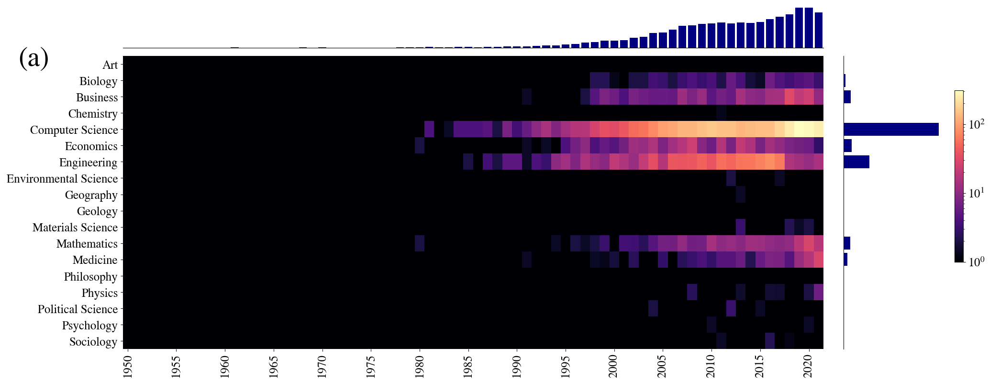

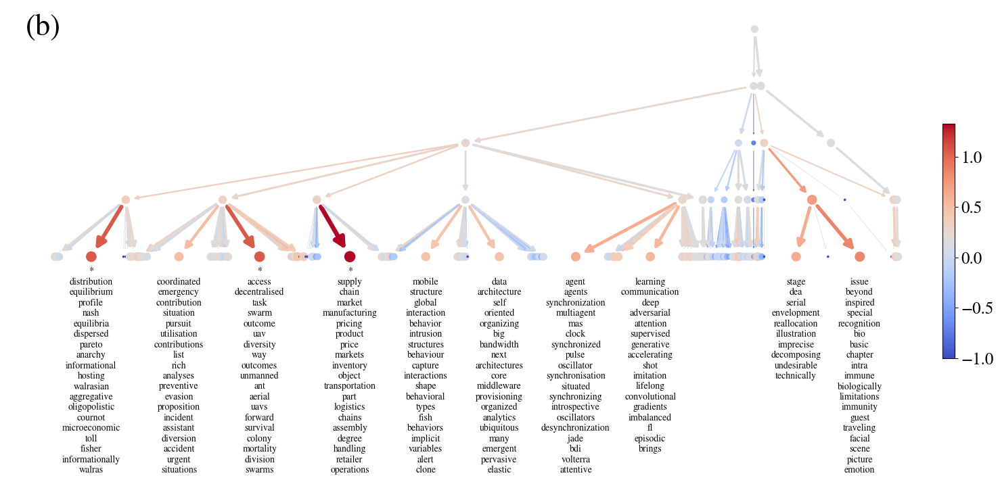

LEVEL 2 - CLUSTER 32



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['decentralized', 'pursuit', 'evasion', 'stochastic', 'algorithm', 'using', 'pursuer', 'networks', 'evader', 'system', 'player', 'problem', 'approach', 'evaders', 'wireless', 'equilibrium', 'models', 'asynchronous', 'problems', 'nash', 'strategy', 'solving', 'novel', 'equilibria', 'solve', 'pareto', 'scheme', 'algorithms', 'model', 'design', 'theory', 'probabilistic', 'systems', 'contribution', 'time', 'revisited', 'intelligence', 'regret', 'strategies', 'restaurant', 'grid', 'greedy', 'scale', 'warfare', 'theoretical', 'autonomous', 'multiplayer', 'performing', 'smart', 'large'] 

---> TOPIC 31		normalized mixture proportion = 5.2987		mixture proportion = 0.0160
	29 WORDS - distribution - equilibrium - profile - nash - equilibria - dispersed - pareto - anarchy - informational - hosting - walrasian - aggregative - oligopolistic - cournot - microeconomic - toll - fisher - informationally - walras - sticky 

---> TOPIC 107		normalized mixture pr

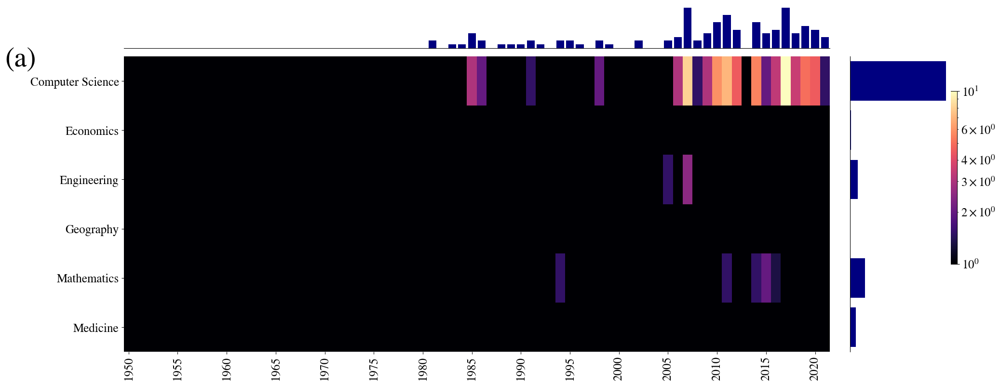

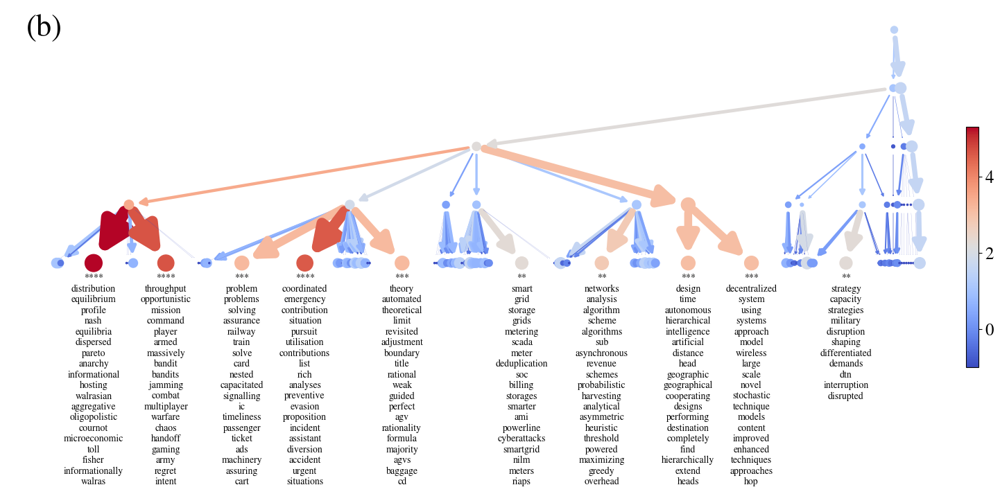

LEVEL 2 - CLUSTER 18



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['allocation', 'game', 'resource', 'congestion', 'networks', 'routing', 'mechanism', 'games', 'algorithm', 'analysis', 'theoretic', 'equilibrium', 'detection', 'fair', 'min', 'max', 'nash', 'auction', 'multicast', 'learning', 'anarchy', 'communication', 'fairness', 'selfish', 'algorithms', 'mechanisms', 'theory', 'delay', 'capacity', 'multipath', 'scheme', 'equilibria', 'strategy', 'maximization', 'qos', 'unicast', 'bottleneck', 'tcp', 'protocol', 'noncooperative', 'interdependent', 'admission', 'differentiated', 'stackelberg', 'queueing', 'abr', 'real', 'aware', 'node', 'second'] 

---> TOPIC 31		normalized mixture proportion = 4.0269		mixture proportion = 0.0128
	29 WORDS - distribution - equilibrium - profile - nash - equilibria - dispersed - pareto - anarchy - informational - hosting - walrasian - aggregative - oligopolistic - cournot - microeconomic - toll - fisher - informationally - walras - sticky 

---> TOPIC 17		normalized mixture pr

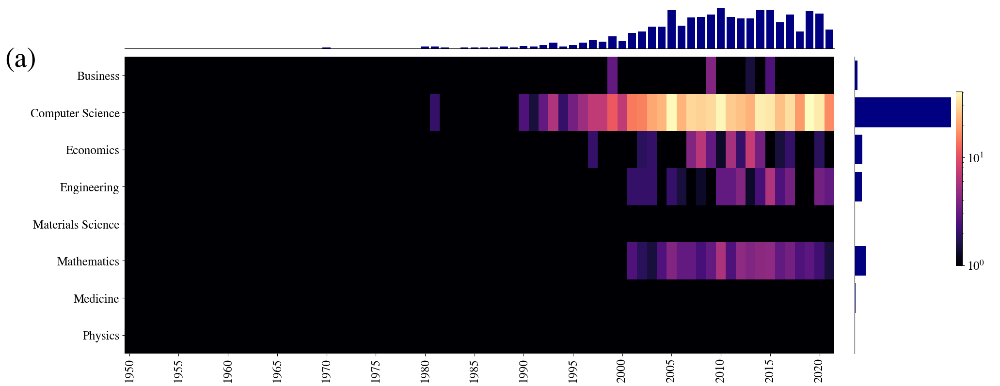

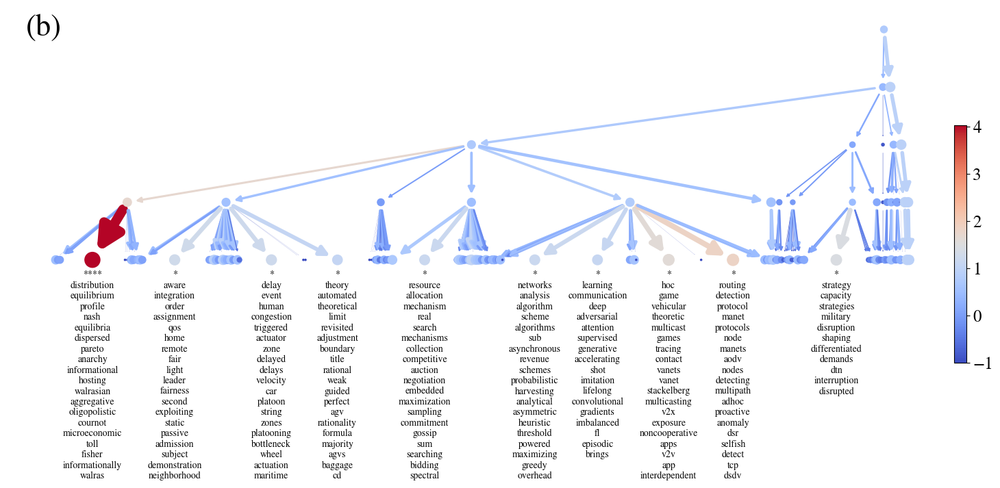

LEVEL 2 - CLUSTER 26



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['agent', 'learning', 'manufacturing', 'swarm', 'communication', 'inspired', 'multiagent', 'ant', 'deep', 'holonic', 'robotics', 'assembly', 'colony', 'decentralised', 'behavior', 'shop', 'interaction', 'product', 'locomotion', 'supply', 'logistics', 'agents', 'task', 'swarms', 'chain', 'mobile', 'structure', 'bio', 'factory', 'additive', 'walking', 'foraging', 'bee', 'insect', 'floor', 'evolution', 'immune', 'biologically', 'printing', 'gait', 'global', 'legged', 'hexapod', 'logistic', 'part', 'pheromone', 'tasks', 'handling', 'behaviour', 'spare'] 

---> TOPIC 103		normalized mixture proportion = 1.6910		mixture proportion = 0.0438
	229 WORDS - supply - chain - market - manufacturing - pricing - product - price - markets - inventory - object - transportation - part - logistics - chains - assembly - degree - handling - retailer - operations - echelon 

---> TOPIC 41		normalized mixture proportion = 1.3686		mixture proportion = 0.0207
	120 WOR

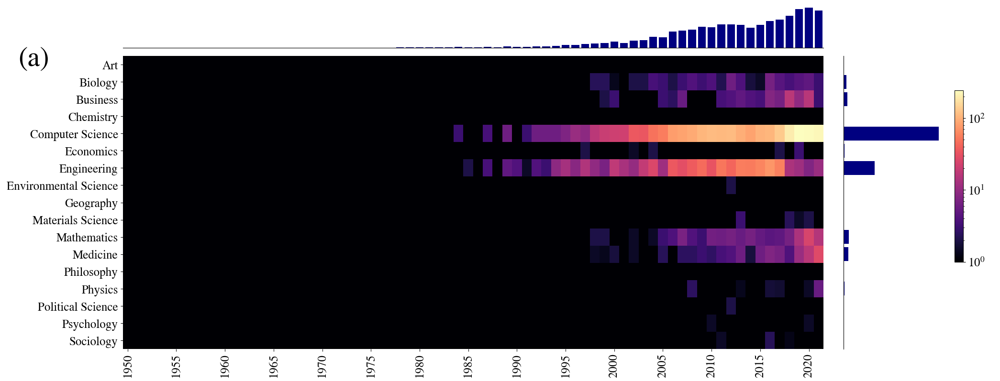

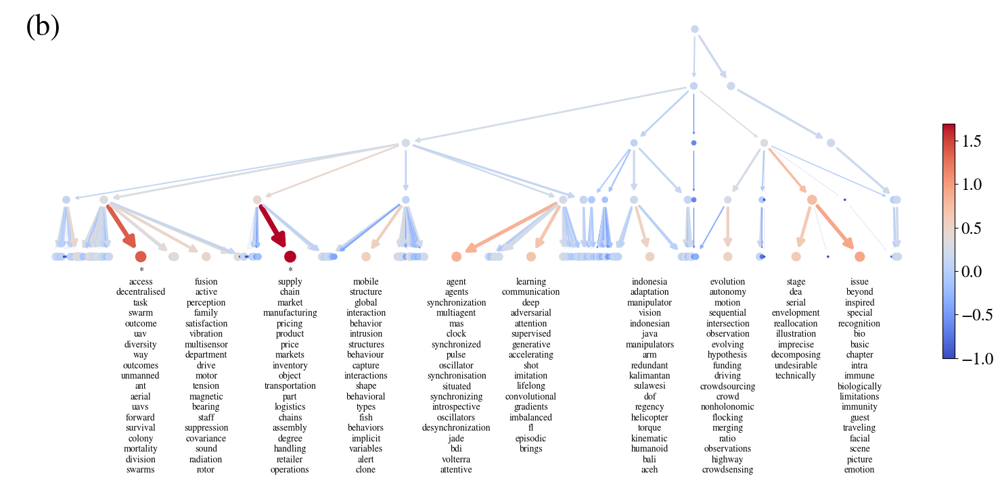

LEVEL 2 - CLUSTER 20



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['planning', 'analysis', 'game', 'storage', 'equilibrium', 'theory', 'networks', 'algorithm', 'grid', 'theoretic', 'coordination', 'industry', 'distribution', 'trading', 'method', 'smart', 'incentive', 'payment', 'virtual', 'transaction', 'asymmetric', 'revenue', 'title', 'nash', 'algorithms', 'control', 'production', 'probabilistic', 'sub', 'theoretical', 'games', 'volatility', 'noncooperative', 'cooperation', 'inherent', 'alternative', 'tracing', 'computer', 'scheme', 'exchange', 'meter', 'equilibria', 'heuristic', 'asset', 'weak', 'hoc', 'cournot', 'methods'] 

---> TOPIC 31		normalized mixture proportion = 2.9126		mixture proportion = 0.0100
	29 WORDS - distribution - equilibrium - profile - nash - equilibria - dispersed - pareto - anarchy - informational - hosting - walrasian - aggregative - oligopolistic - cournot - microeconomic - toll - fisher - informationally - walras - sticky 

---> TOPIC 42		normalized mixture proportion = 1.8470		

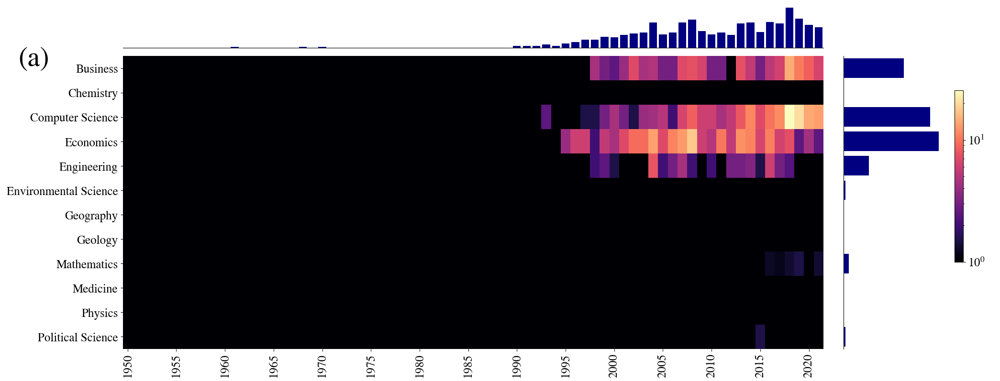

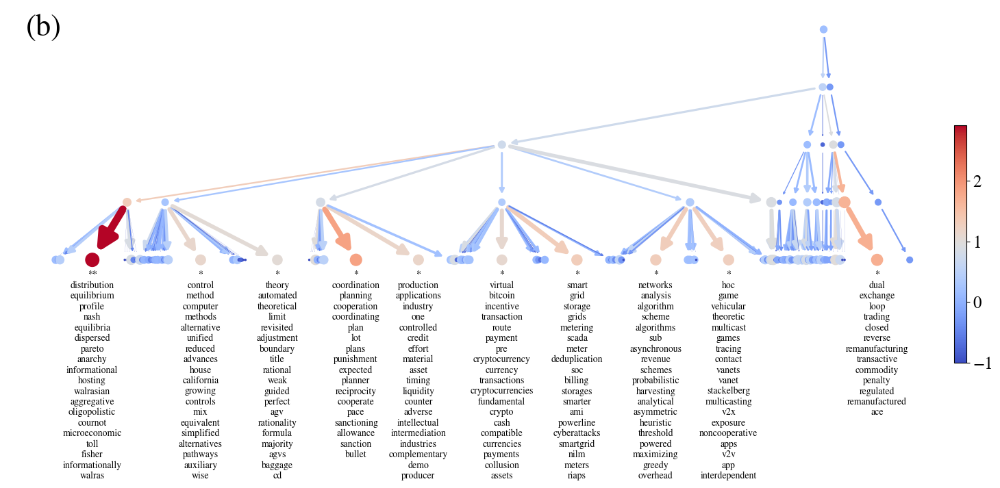







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 1



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['nonlinear', 'interconnected', 'feedback', 'formation', 'event', 'discrete', 'fusion', 'output', 'delay', 'linear', 'stabilization', 'class', 'application', 'mode', 'filter', 'navigation', 'manipulator', 'kalman', 'observer', 'target', 'motion', 'sliding', 'triggered', 'multivariable', 'active', 'varying', 'input', 'unknown', 'avoidance', 'filtering', 'collision', 'diagnosis', 'localization', 'disturbance', 'pid', 'dynamical', 'air', 'gain', 'flexible', 'supervisory', 'actuator', 'trajectory', 'spacecraft', 'tuning', 'vibration', 'coupled', 'pi', 'delays', 'delayed', 'intersection'] 

---> TOPIC 54		normalized mixture proportion = 1.8042		mixture proportion = 0.0225
	123 WORDS - fusion - active - perception - family - satisfaction - vibration - multisensor - department - drive - motor - tension - magnetic - bearing - staff - suppression - covariance - sound - radiation - rotor - motivation 

---> TOPIC 9		normalized mixture proportion = 1.755

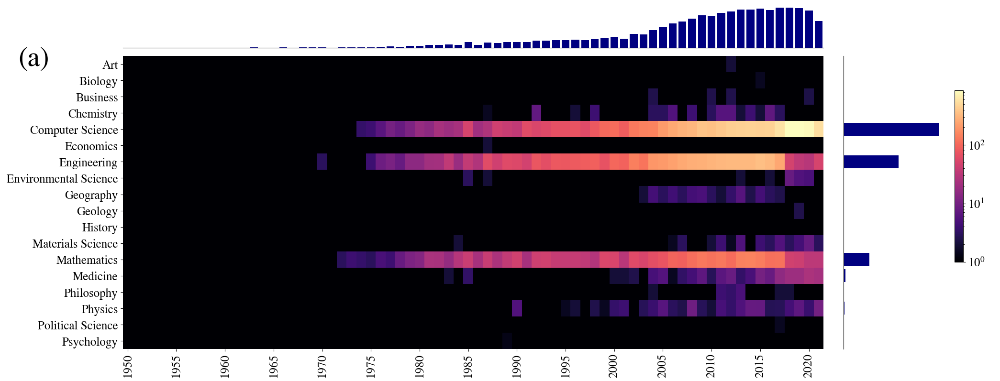

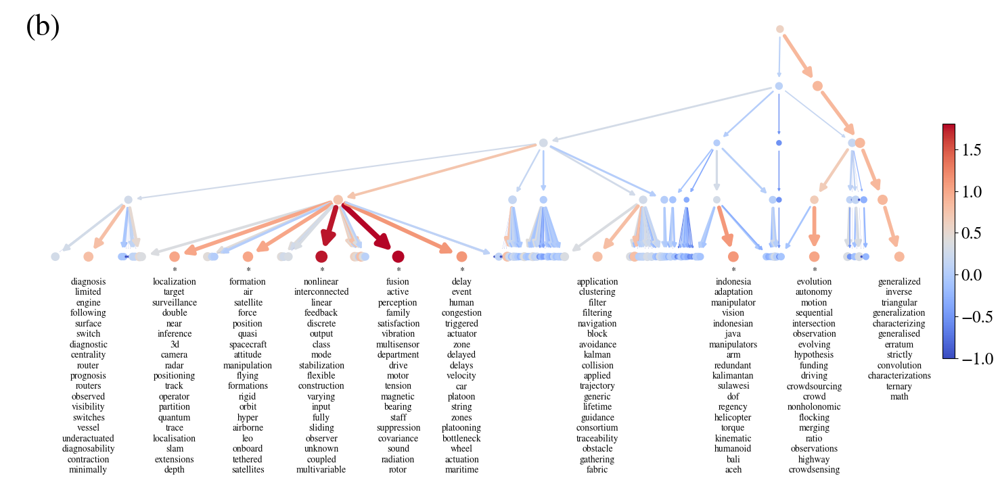

LEVEL 2 - CLUSTER 0



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['robust', 'interconnected', 'nonlinear', 'feedback', 'output', 'stabilization', 'delay', 'class', 'linear', 'frequency', 'mode', 'multivariable', 'manipulator', 'discrete', 'active', 'sliding', 'observer', 'input', 'pid', 'centralized', 'disturbance', 'damping', 'plant', 'gain', 'varying', 'unknown', 'fixed', 'vibration', 'synthesis', 'flexible', 'pi', 'tuning', 'uncertainty', 'networked', 'multimachine', 'lmi', 'actuator', 'overlapping', 'decomposition', 'excitation', 'decoupling', 'dynamical', 'matrix', 'delayed', 'manipulators', 'interconnection', 'oscillation', 'singular', 'delays', 'tank'] 

---> TOPIC 54		normalized mixture proportion = 3.5830		mixture proportion = 0.0346
	123 WORDS - fusion - active - perception - family - satisfaction - vibration - multisensor - department - drive - motor - tension - magnetic - bearing - staff - suppression - covariance - sound - radiation - rotor - motivation 

---> TOPIC 9		normalized mixture propor

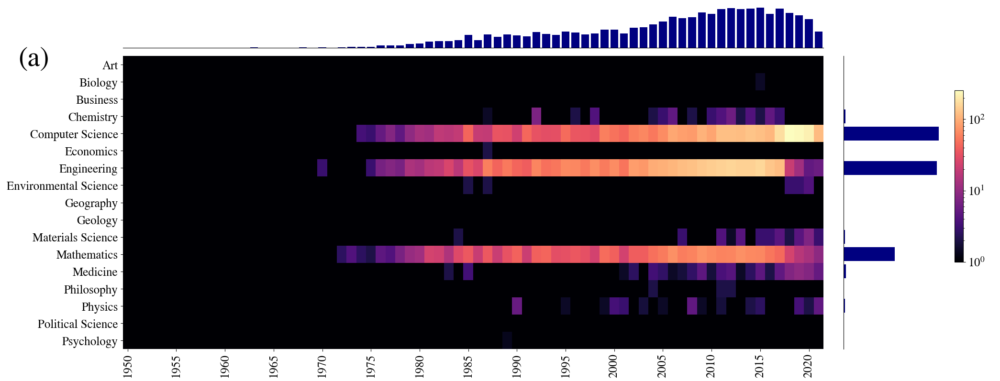

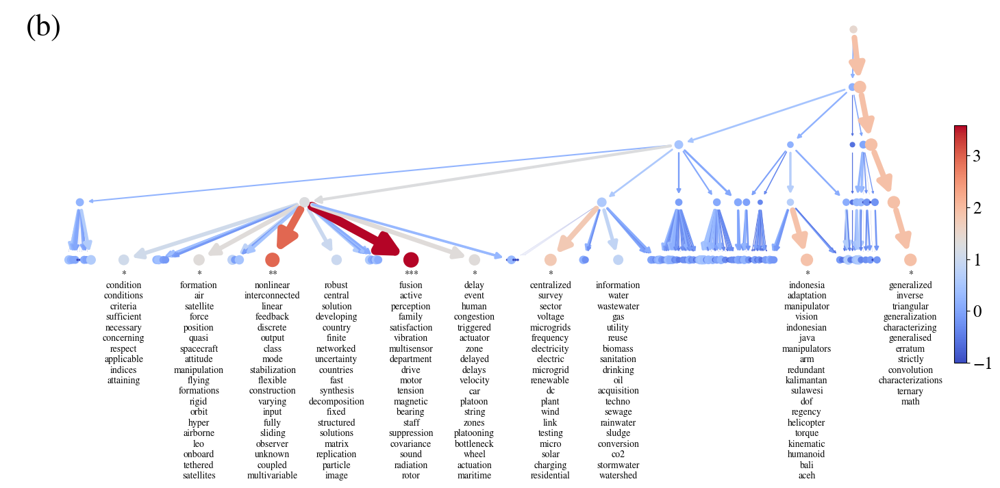

LEVEL 2 - CLUSTER 27



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['formation', 'fusion', 'task', 'filter', 'navigation', 'swarm', 'kalman', 'target', 'nonlinear', 'event', 'motion', 'triggered', 'avoidance', 'collision', 'uav', 'linear', 'filtering', 'unmanned', 'decentralised', 'localization', 'aerial', 'application', 'uavs', 'air', 'delay', 'coverage', 'connectivity', 'spacecraft', 'feedback', 'trajectory', 'intersection', 'multisensor', 'output', 'varying', 'discrete', 'unknown', 'track', 'dynamical', 'nonholonomic', 'attitude', 'surveillance', 'flying', 'platoon', 'class', 'mode', 'flocking', 'coupled', 'swarms', 'observer', 'obstacle'] 

---> TOPIC 97		normalized mixture proportion = 1.6130		mixture proportion = 0.0170
	86 WORDS - evolution - autonomy - motion - sequential - intersection - observation - evolving - hypothesis - funding - driving - crowdsourcing - crowd - nonholonomic - flocking - merging - ratio - observations - highway - crowdsensing - intersections 

---> TOPIC 108		normalized mixture

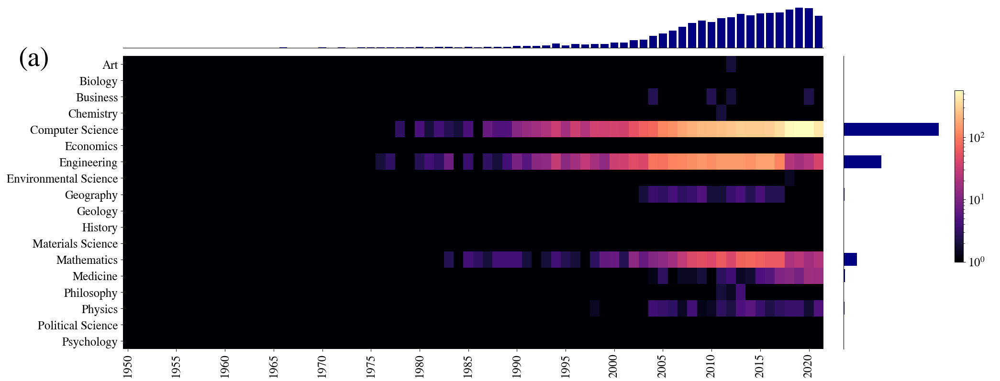

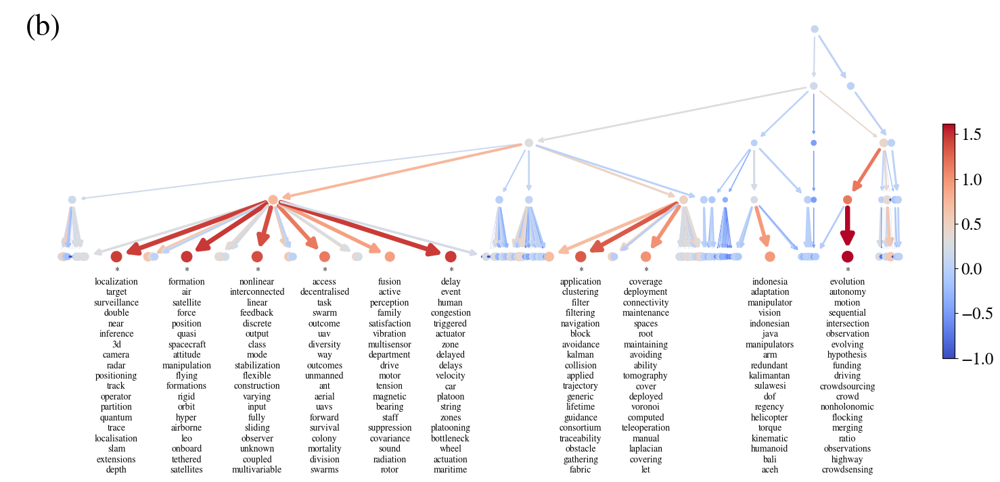

LEVEL 2 - CLUSTER 28



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['decentralized', 'system', 'discrete', 'systems', 'diagnosis', 'model', 'supervisory', 'using', 'petri', 'predictive', 'approach', 'net', 'irrigation', 'centralized', 'hvac', 'canal', 'nets', 'large', 'controller', 'scale', 'decision', 'smart', 'modeling', 'supervisor', 'thermal', 'lighting', 'diagnosability', 'fuzzy', 'timed', 'temperature', 'comfort', 'supervision', 'prognosis', 'heating', 'observability', 'cooling', 'supervisors', 'structural', 'feedback', 'conditioning', 'nondeterministic', 'storage', 'making', 'class', 'stochastic', 'codiagnosability', 'novel', 'flexible', 'dissemination', 'vapor'] 

---> TOPIC 93		normalized mixture proportion = 2.1375		mixture proportion = 0.0100
	42 WORDS - diagnosis - limited - engine - following - surface - switch - diagnostic - centrality - router - prognosis - routers - observed - visibility - switches - vessel - underactuated - diagnosability - contraction - minimally - engines 

---> TOPIC 9		no

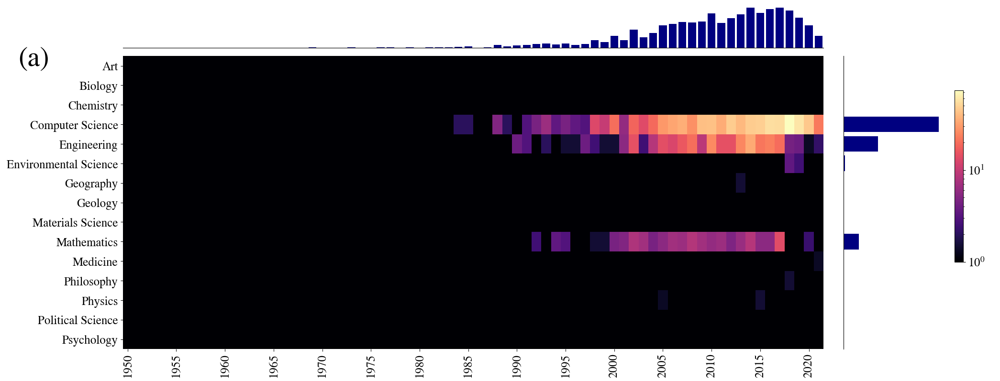

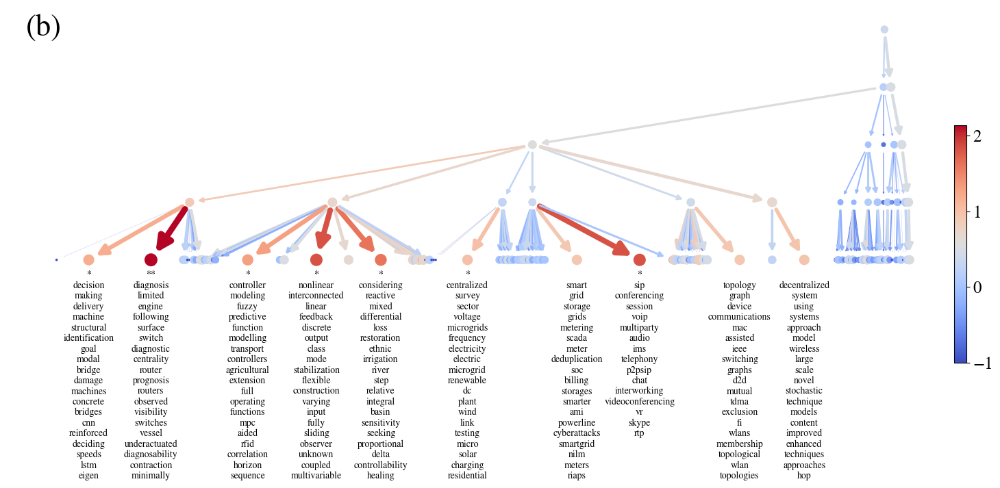







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 2



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['decentralization', 'local', 'governance', 'fiscal', 'development', 'case', 'public', 'government', 'decentralisation', 'political', 'education', 'china', 'study', 'reform', 'regional', 'indonesia', 'politics', 'community', 'school', 'federalism', 'national', 'european', 'rural', 'institutional', 'africa', 'change', 'role', 'south', 'based', 'perspective', 'economy', 'india', 'forest', 'democracy', 'level', 'participation', 'comparative', 'europe', 'land', 'union', 'post', 'district', 'international', 'financial', 'educational', 'states', 'bargaining', 'administration', 'democratic', 'law'] 

---> TOPIC 87		normalized mixture proportion = 1.2794		mixture proportion = 0.0606
	546 WORDS - governance - fiscal - china - regional - rural - comparative - africa - institutional - south - india - federalism - district - lessons - municipal - brazil - federal - ghana - territorial - chinese - relations 

---> TOPIC 38		normalized mixture proportion = 

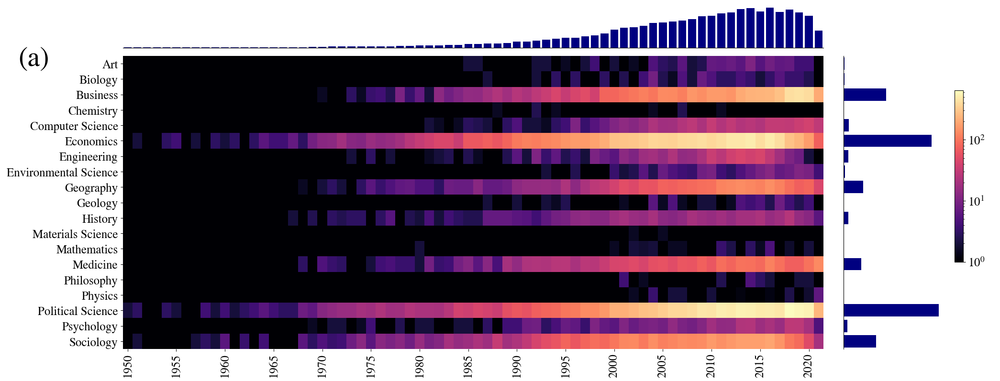

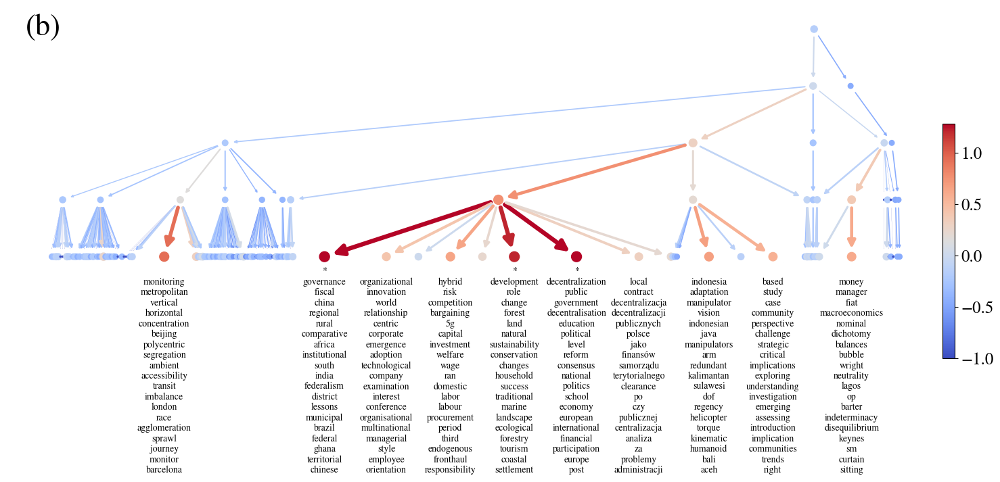

LEVEL 2 - CLUSTER 1



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['decentralization', 'local', 'fiscal', 'government', 'development', 'public', 'decentralisation', 'governance', 'case', 'political', 'china', 'regional', 'indonesia', 'federalism', 'reform', 'education', 'study', 'politics', 'africa', 'rural', 'democracy', 'india', 'national', 'party', 'role', 'level', 'institutional', 'economy', 'participation', 'community', 'comparative', 'south', 'federal', 'european', 'perspective', 'administration', 'democratic', 'school', 'post', 'europe', 'governments', 'financial', 'ghana', 'district', 'intergovernmental', 'devolution', 'poverty', 'administrative', 'welfare', 'territorial'] 

---> TOPIC 87		normalized mixture proportion = 1.8390		mixture proportion = 0.0798
	546 WORDS - governance - fiscal - china - regional - rural - comparative - africa - institutional - south - india - federalism - district - lessons - municipal - brazil - federal - ghana - territorial - chinese - relations 

---> TOPIC 38		normali

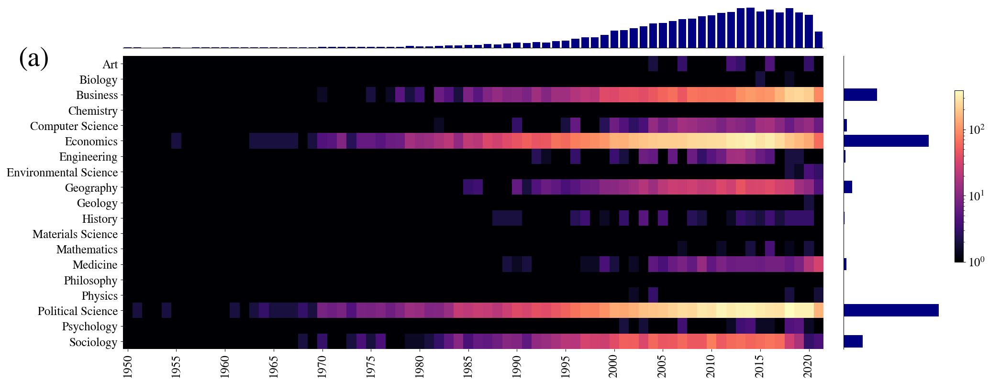

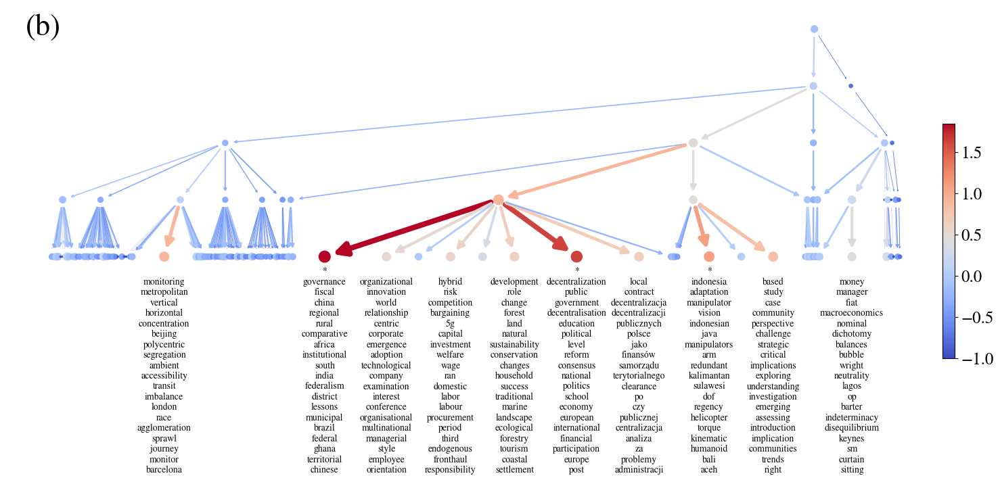

LEVEL 2 - CLUSTER 2



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['governance', 'case', 'decentralization', 'education', 'study', 'development', 'school', 'community', 'water', 'public', 'reform', 'forest', 'china', 'change', 'political', 'european', 'national', 'based', 'politics', 'land', 'institutional', 'bargaining', 'decentralisation', 'wage', 'union', 'role', 'rural', 'south', 'perspective', 'regional', 'africa', 'international', 'law', 'economy', 'europe', 'district', 'government', 'higher', 'educational', 'post', 'employment', 'comparative', 'natural', 'participation', 'world', 'level', 'indonesia', 'states', 'india', 'financial'] 

---> TOPIC 37		normalized mixture proportion = 1.4864		mixture proportion = 0.0276
	223 WORDS - development - role - change - forest - land - natural - sustainability - conservation - changes - household - success - traditional - marine - landscape - ecological - forestry - tourism - coastal - settlement - late 

---> TOPIC 38		normalized mixture proportion = 1.4574		mix

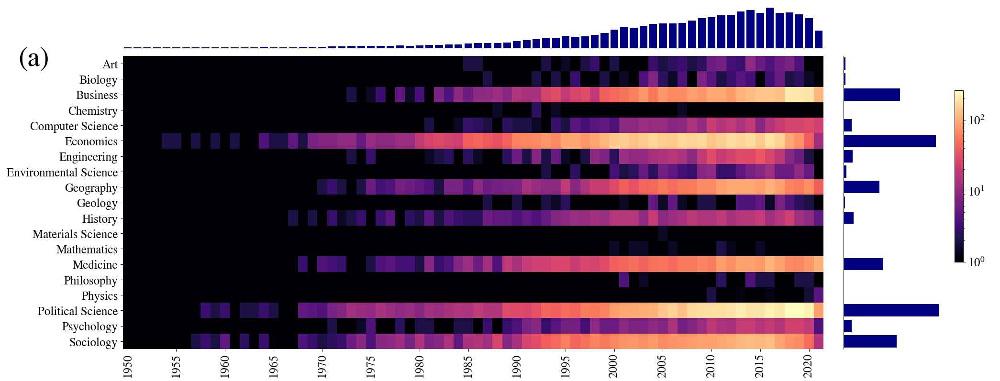

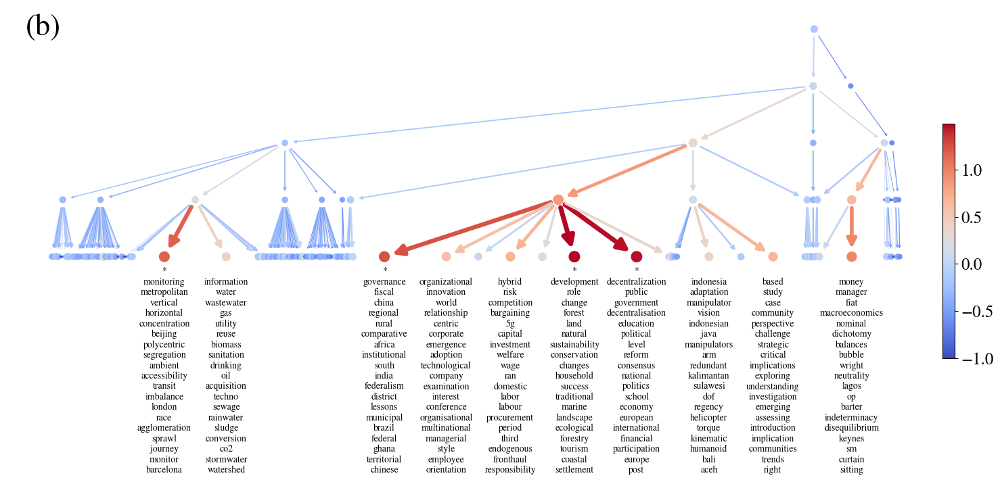







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 3



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['peer', 'cloud', 'p2p', 'computing', 'dynamic', 'privacy', 'web', 'discovery', 'trust', 'security', 'secure', 'overlay', 'database', 'collaborative', 'preserving', 'query', 'file', 'online', 'mobility', 'internet', 'retrieval', 'workflow', 'reputation', 'fault', 'semantic', 'heterogeneous', 'attribute', 'tolerant', 'encryption', 'composition', 'authentication', 'anonymous', 'memory', 'simulation', 'execution', 'open', 'shared', 'networking', 'graph', 'clouds', 'computational', 'unstructured', 'sensor', 'publish', 'subscribe', 'topology', 'programming', 'dht', 'queries', 'databases'] 

---> TOPIC 78		normalized mixture proportion = 1.7555		mixture proportion = 0.0026
	15 WORDS - sip - conferencing - session - voip - multiparty - audio - ims - telephony - p2psip - chat - interworking - videoconferencing - vr - skype - rtp 

---> TOPIC 12		normalized mixture proportion = 1.1235		mixture proportion = 0.0243
	182 WORDS - trust - discovery - databa

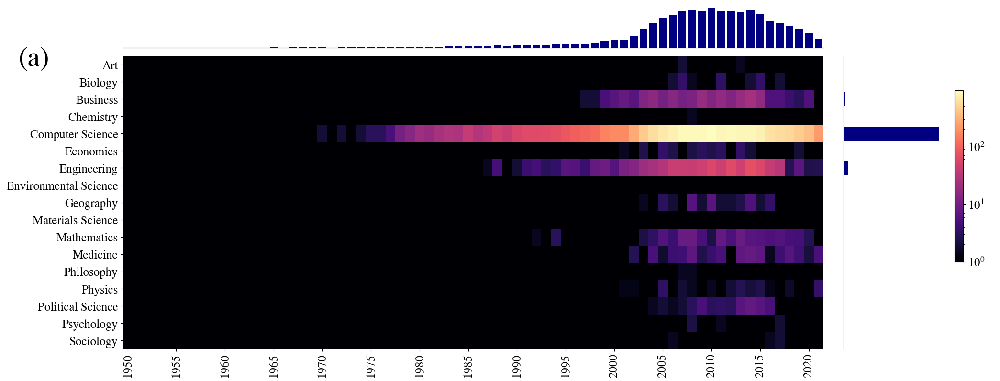

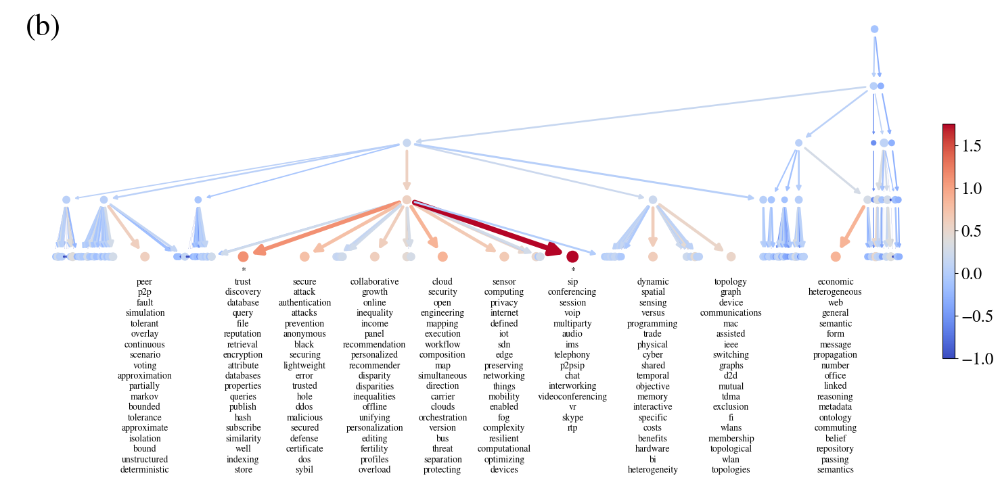

LEVEL 2 - CLUSTER 24



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['peer', 'p2p', 'computing', 'privacy', 'trust', 'discovery', 'web', 'secure', 'overlay', 'preserving', 'query', 'database', 'file', 'collaborative', 'online', 'retrieval', 'reputation', 'semantic', 'internet', 'streaming', 'attribute', 'fault', 'video', 'encryption', 'tolerant', 'heterogeneous', 'authentication', 'anonymous', 'multimedia', 'unstructured', 'networking', 'computational', 'publish', 'graph', 'subscribe', 'sensor', 'topology', 'simulation', 'dht', 'databases', 'queries', 'caching', 'attack', 'recommendation', 'job', 'live', 'concurrency', 'indexing', 'recommender', 'hash'] 

---> TOPIC 78		normalized mixture proportion = 2.1889		mixture proportion = 0.0028
	15 WORDS - sip - conferencing - session - voip - multiparty - audio - ims - telephony - p2psip - chat - interworking - videoconferencing - vr - skype - rtp 

---> TOPIC 12		normalized mixture proportion = 1.5408		mixture proportion = 0.0265
	182 WORDS - trust - discovery - dat

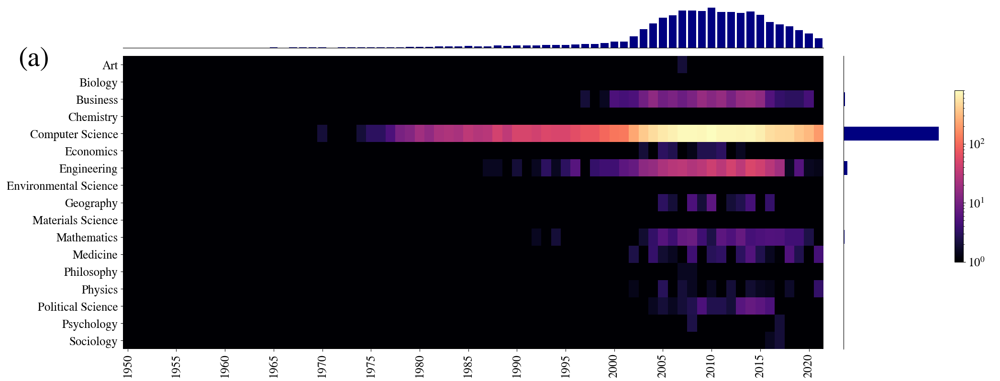

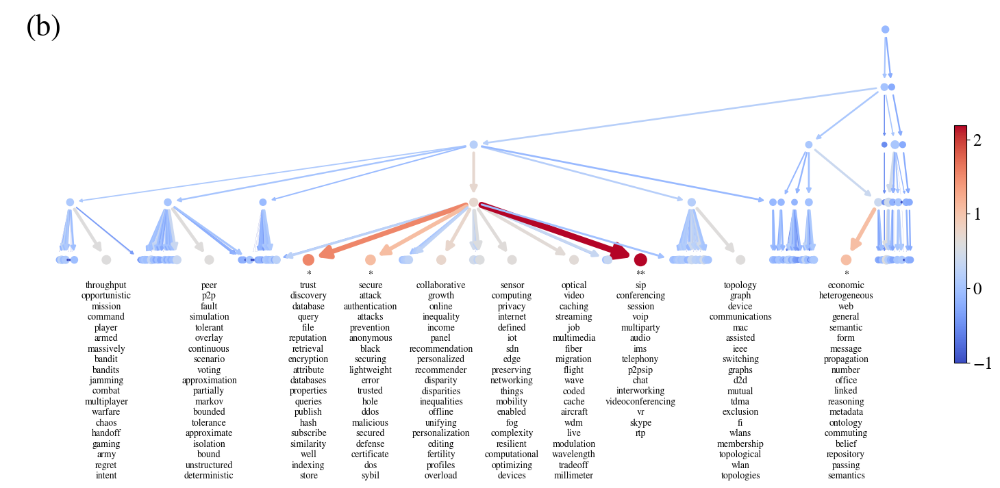

LEVEL 2 - CLUSTER 3



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['agent', 'architecture', 'mobility', 'self', 'workflow', 'web', 'dynamic', 'framework', 'composition', 'oriented', 'memory', 'agents', 'computing', 'execution', 'data', 'business', 'core', 'scalable', 'cloud', 'orchestration', 'platform', 'engineering', 'shared', 'ip', 'many', 'organizing', 'programming', 'heterogeneous', 'workflows', 'architectures', 'chip', 'organization', 'multiprocessor', 'choreography', 'pervasive', 'middleware', 'enterprise', 'internet', 'security', 'enactment', 'emergent', 'ubiquitous', 'ipv6', 'inspired', 'run', 'architectural', 'sdn', 'open', 'processor', 'multicore'] 

---> TOPIC 58		normalized mixture proportion = 1.9389		mixture proportion = 0.0260
	102 WORDS - cloud - security - open - engineering - mapping - execution - workflow - composition - map - simultaneous - direction - carrier - clouds - orchestration - version - bus - threat - separation - protecting - virtualized 

---> TOPIC 40		normalized mixture pro

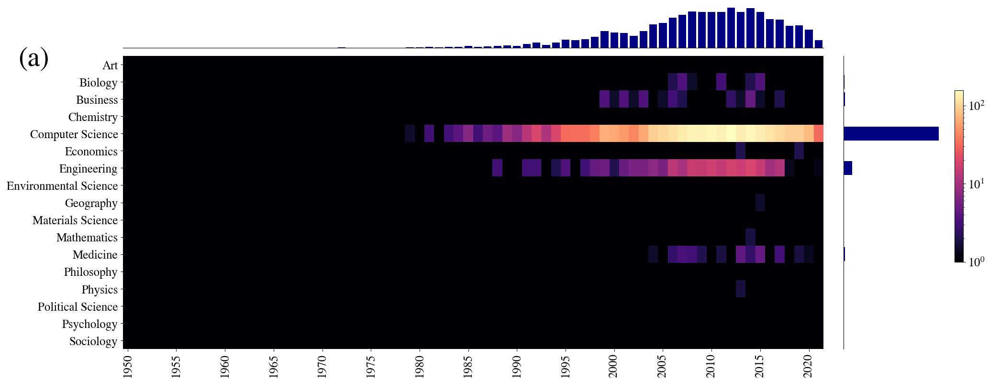

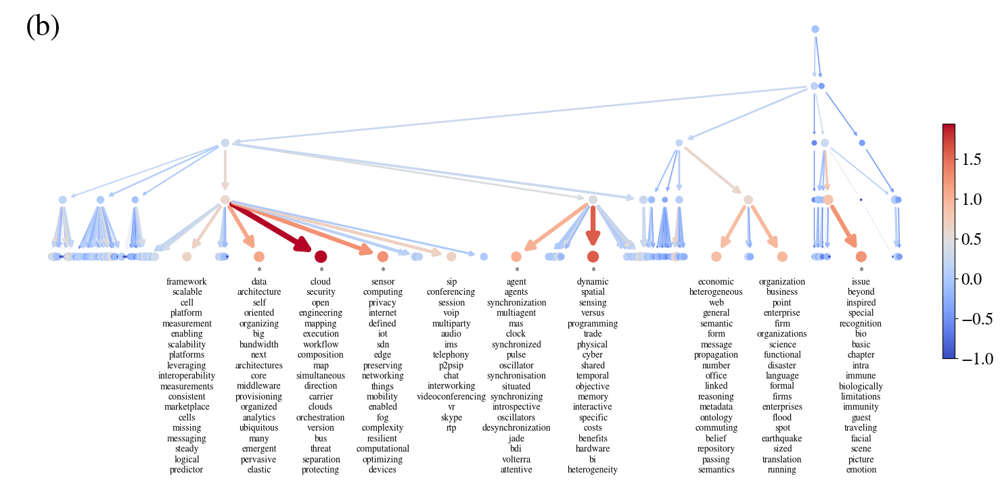







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 4



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['water', 'wastewater', 'descentralización', 'renewable', 'rural', 'local', 'centralized', 'waste', 'décentralisation', 'development', 'solar', 'electricity', 'technology', 'em', 'descentralização', 'saúde', 'plant', 'na', 'heat', 'política', 'biomass', 'low', 'brasil', 'gas', 'heating', 'india', 'políticas', 'environmental', 'district', 'fuel', 'fiscal', 'municipal', 'gestão', 'caso', 'hydrogen', 'sector', 'china', 'regional', 'reuse', 'locale', 'residential', 'uma', 'electrification', 'photovoltaic', 'dan', 'solid', 'wind', 'sanitation', 'colombia', 'salud'] 

---> TOPIC 2		normalized mixture proportion = 2.8001		mixture proportion = 0.2390
	2050 WORDS - technology - flow - descentralización - em - décentralisation - technologies - na - descentralização - saúde - brasil - política - sistema - uma - políticas - caso - gestion - gestão - locale - salud - dan 

---> TOPIC 39		normalized mixture proportion = 2.3632		mixture proportion = 0.0037
	

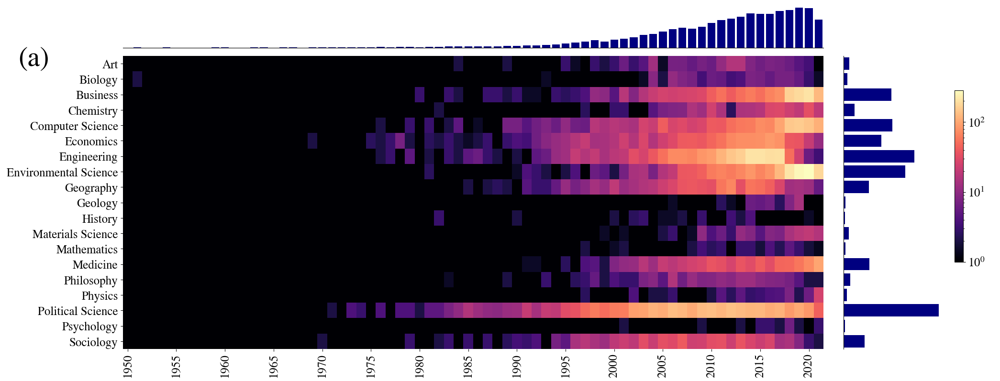

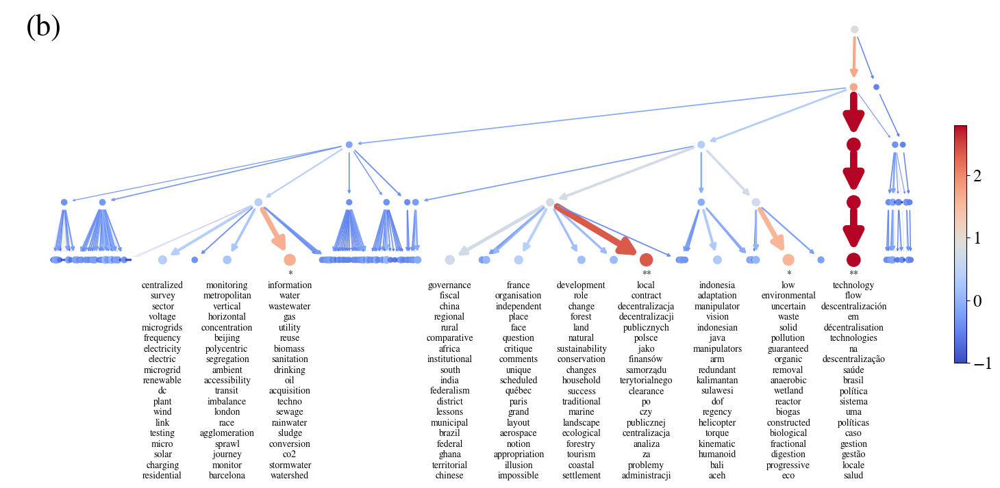

LEVEL 2 - CLUSTER 4



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['data', 'architecture', 'breeding', 'switch', 'processor', 'center', 'dynamic', 'efficient', 'clustered', 'router', 'seed', 'datacenter', 'chip', 'farmer', 'india', 'memory', 'development', 'rural', 'farmers', 'routers', 'vliw', 'agriculture', 'processing', 'cluster', 'crop', 'africa', 'job', 'next', 'computing', 'buffer', 'register', 'instruction', 'grain', 'switches', 'hybrid', 'self', 'complexity', 'cache', 'kenya', 'crossbar', 'balanced', 'optical', 'institutional', 'buffered', 'architectures', 'single', 'speculative', 'processors', 'program', 'hardware'] 

---> TOPIC 40		normalized mixture proportion = 2.1327		mixture proportion = 0.0485
	172 WORDS - dynamic - spatial - sensing - versus - programming - trade - physical - cyber - shared - temporal - objective - memory - interactive - specific - costs - benefits - hardware - bi - heterogeneity - clustered 

---> TOPIC 65		normalized mixture proportion = 1.0885		mixture proportion = 0.0260


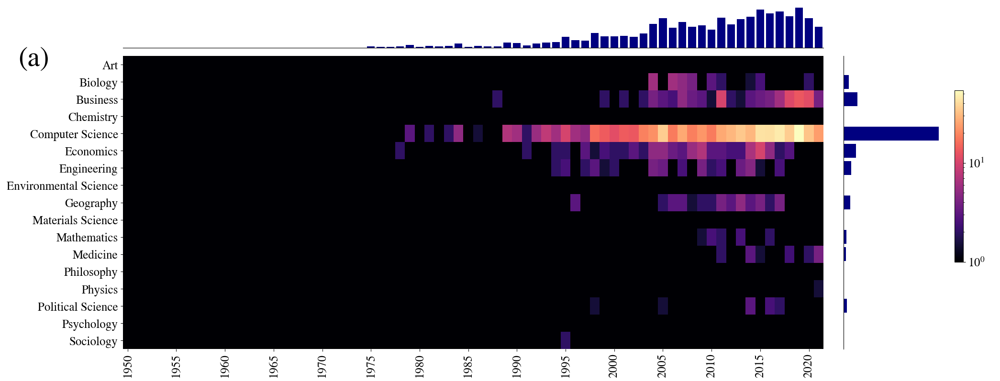

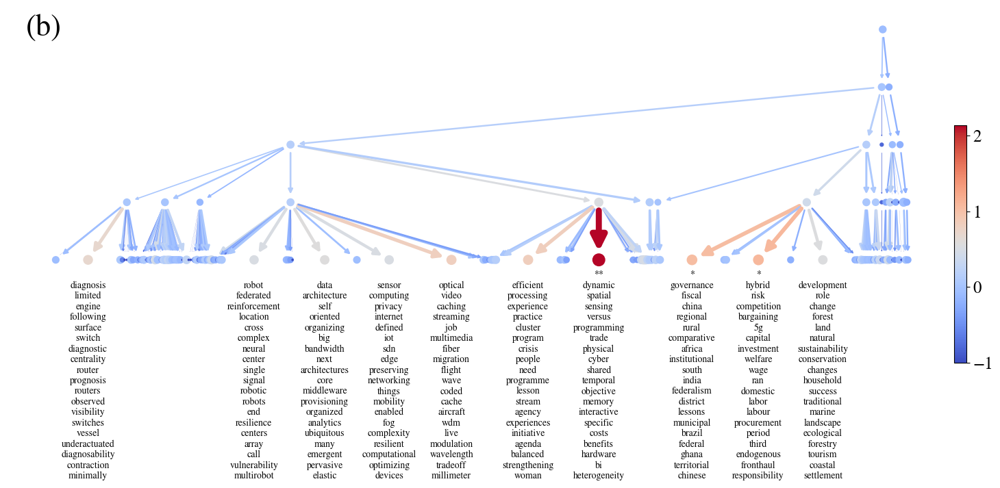

LEVEL 2 - CLUSTER 6



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['water', 'wastewater', 'urban', 'renewable', 'waste', 'rural', 'centralized', 'solar', 'electricity', 'development', 'heat', 'plant', 'biomass', 'gas', 'heating', 'low', 'environmental', 'fuel', 'district', 'india', 'hydrogen', 'reuse', 'residential', 'electrification', 'photovoltaic', 'china', 'city', 'solid', 'sanitation', 'wind', 'sustainability', 'anaerobic', 'micro', 'thermal', 'biogas', 'membrane', 'removal', 'sector', 'drinking', 'role', 'pv', 'combined', 'wetland', 'municipal', 'organic', 'sewage', 'constructed', 'rainwater', 'household', 'techno'] 

---> TOPIC 71		normalized mixture proportion = 3.4104		mixture proportion = 0.0289
	152 WORDS - information - water - wastewater - gas - utility - reuse - biomass - sanitation - drinking - oil - acquisition - techno - sewage - rainwater - sludge - conversion - co2 - stormwater - watershed - greenhouse 

---> TOPIC 83		normalized mixture proportion = 3.2336		mixture proportion = 0.0310
	17

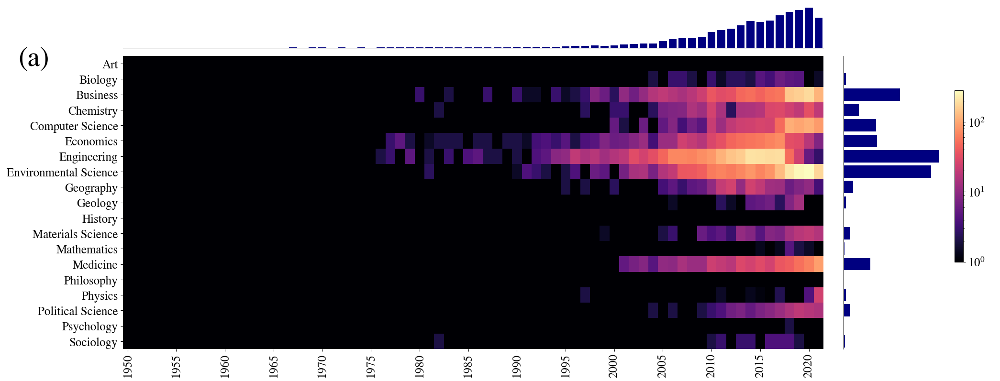

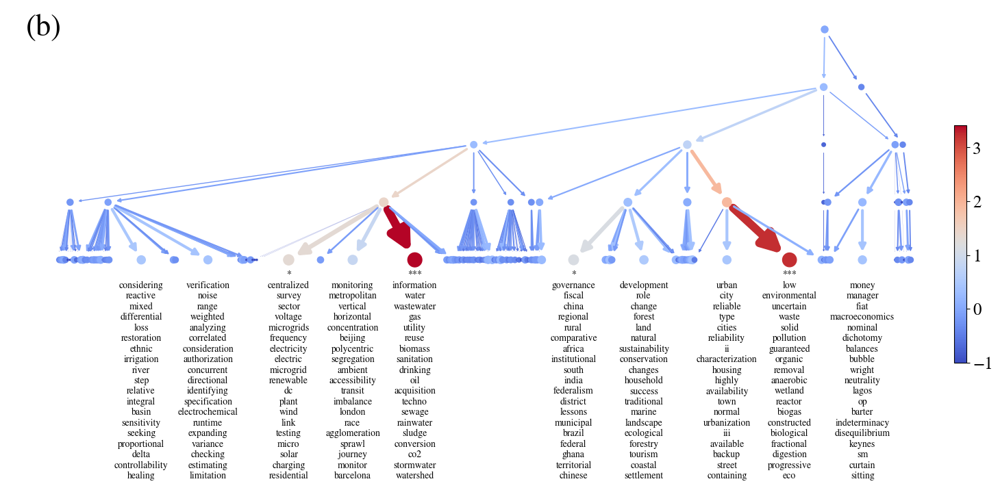

LEVEL 2 - CLUSTER 31



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['descentralización', 'décentralisation', 'em', 'descentralização', 'saúde', 'na', 'local', 'política', 'brasil', 'políticas', 'fiscal', 'gestão', 'caso', 'locale', 'uma', 'dan', 'gestion', 'salud', 'sistema', 'colombia', 'federalismo', 'territorial', 'daerah', 'politiques', 'développement', 'desentralisasi', 'latina', 'análise', 'américa', 'desarrollo', 'regional', 'france', 'politique', 'ca', 'méxico', 'pública', 'españa', 'reforma', 'públicas', 'gestión', 'análisis', 'gouvernance', 'municipal', 'programa', 'chile', 'terhadap', 'municípios', 'nacional', 'argentina', 'público'] 

---> TOPIC 2		normalized mixture proportion = 10.5987		mixture proportion = 0.5774
	2050 WORDS - technology - flow - descentralización - em - décentralisation - technologies - na - descentralização - saúde - brasil - política - sistema - uma - políticas - caso - gestion - gestão - locale - salud - dan 

---> TOPIC 39		normalized mixture proportion = 6.9535		mixture p

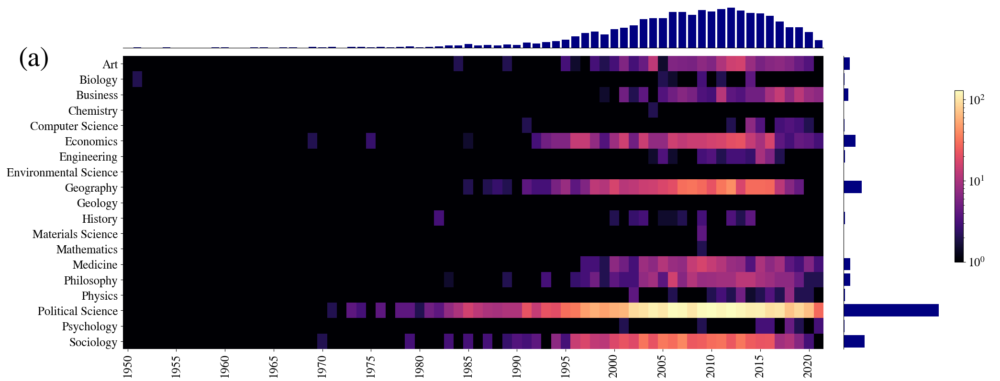

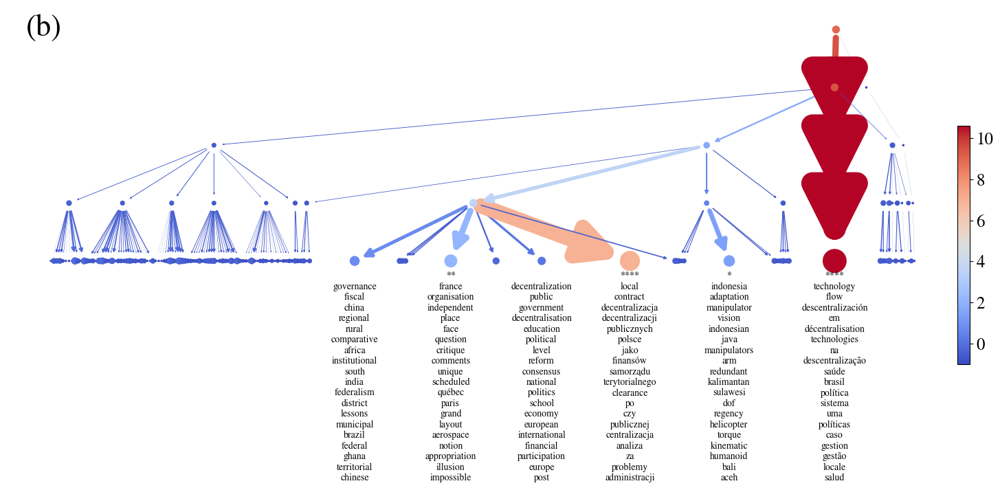







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 5



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'trading', 'smart', 'decentralized', 'system', 'grid', 'using', 'transactive', 'systems', 'model', 'transaction', 'approach', 'sharing', 'scheme', 'grids', 'analysis', 'virtual', 'ledger', 'strategy', 'generation', 'contracts', 'coordination', 'intelligent', 'blockchains', 'networks', 'exchange', 'storage', 'scale', 'algorithm', 'transactions', 'enhanced', 'digital', 'ethereum', 'sustainable', 'novel', 'strategies', 'incentive', 'powered', 'billing', 'private', 'large', 'models', 'ecosystem', 'decision', 'permissioned', 'machine', 'wireless', 'capacity', 'bitcoin', 'cooperation'] 

---> TOPIC 73		normalized mixture proportion = 3.6705		mixture proportion = 0.0088
	19 WORDS - smart - grid - storage - grids - metering - scada - meter - deduplication - soc - billing - storages - smarter - ami - powerline - cyberattacks - smartgrid - nilm - meters - riaps 

---> TOPIC 46		normalized mixture proportion = 3.5361		mixture proportion = 

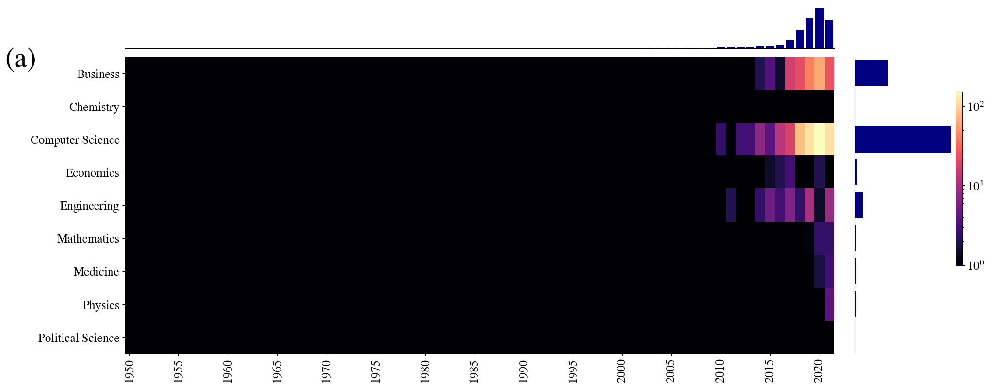

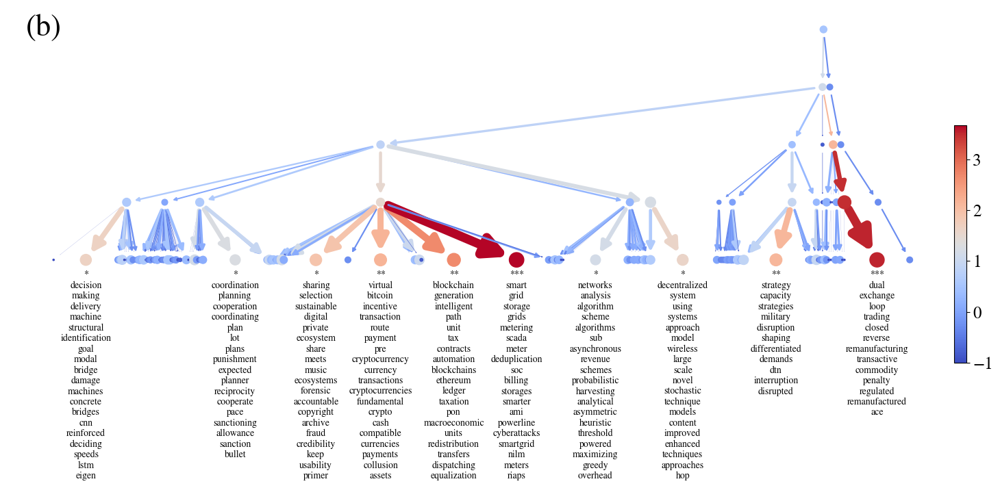

LEVEL 2 - CLUSTER 7



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'trading', 'smart', 'decentralized', 'electricity', 'system', 'grid', 'electric', 'using', 'transactive', 'microgrids', 'systems', 'model', 'framework', 'platform', 'transaction', 'charging', 'approach', 'sharing', 'renewable', 'microgrid', 'prosumer', 'grids', 'prosumers', 'virtual', 'ledger', 'strategy', 'generation', 'residential', 'sector', 'contracts', 'intelligent', 'blockchains', 'centralized', 'exchange', 'voltage', 'micro', 'storage', 'ev', 'plant', 'scale', 'survey', 'solar', 'transactions', 'enhanced', 'digital', 'ethereum', 'sustainable', 'novel', 'scalable'] 

---> TOPIC 73		normalized mixture proportion = 3.5237		mixture proportion = 0.0088
	19 WORDS - smart - grid - storage - grids - metering - scada - meter - deduplication - soc - billing - storages - smarter - ami - powerline - cyberattacks - smartgrid - nilm - meters - riaps 

---> TOPIC 46		normalized mixture proportion = 2.9758		mixture proportion = 0.0080
	1

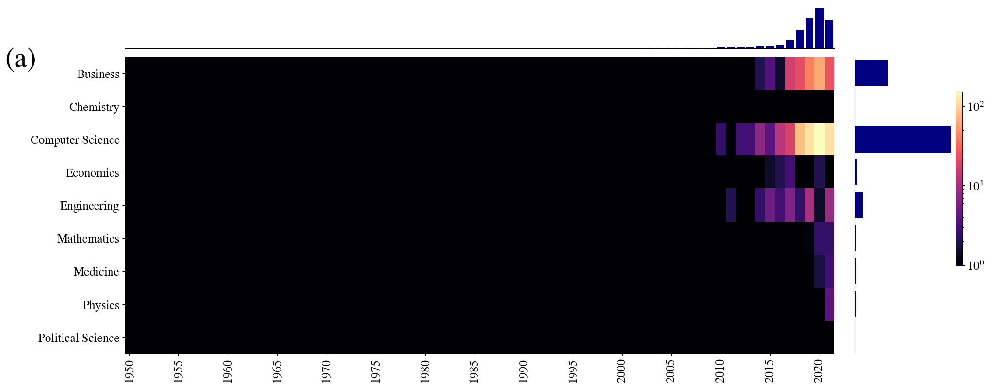

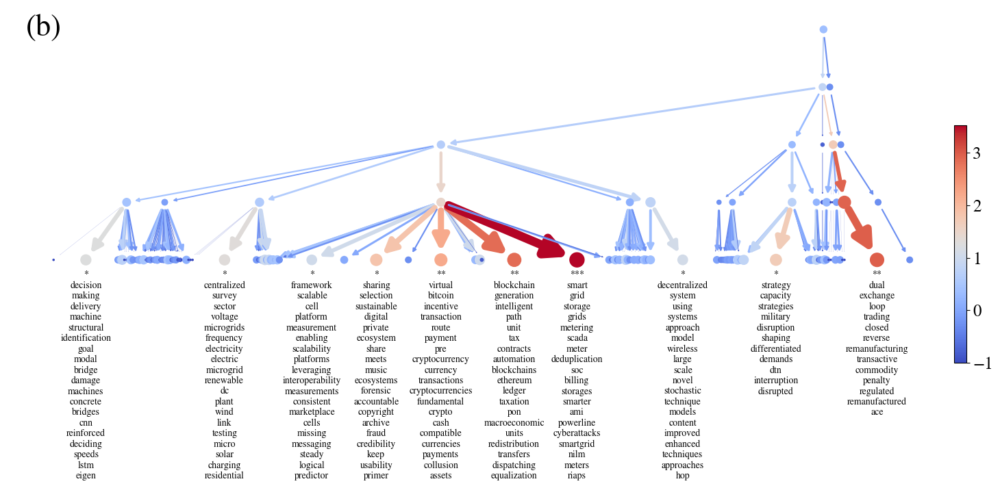







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 6



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'smart', 'iot', 'privacy', 'bitcoin', 'secure', 'internet', 'digital', 'sharing', 'things', 'applications', 'contracts', 'blockchains', 'ethereum', 'trust', 'authentication', 'storage', 'identity', 'preserving', 'ledger', 'proof', 'voting', 'enabled', 'computing', 'cryptocurrency', 'transaction', 'peer', 'edge', 'payment', 'cryptocurrencies', 'new', 'trusted', 'industry', 'key', 'currency', 'securing', 'private', 'anonymous', 'transactions', 'intelligent', 'lightweight', 'ecosystem', 'crypto', 'integrity', 'hyperledger', 'devices', 'verifiable', 'permissioned', 'personal', 'ipfs'] 

---> TOPIC 47		normalized mixture proportion = 1.6784		mixture proportion = 0.0104
	56 WORDS - virtual - bitcoin - incentive - transaction - route - payment - pre - cryptocurrency - currency - transactions - cryptocurrencies - fundamental - crypto - cash - compatible - currencies - payments - collusion - assets - coin 

---> TOPIC 49		normalized mixt

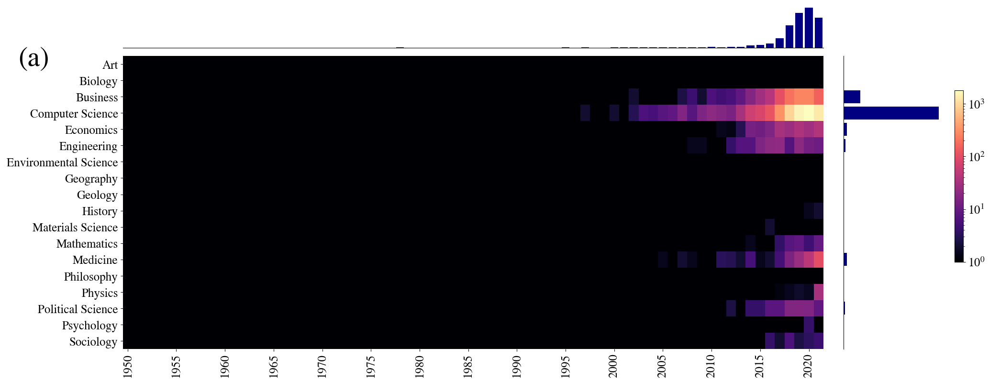

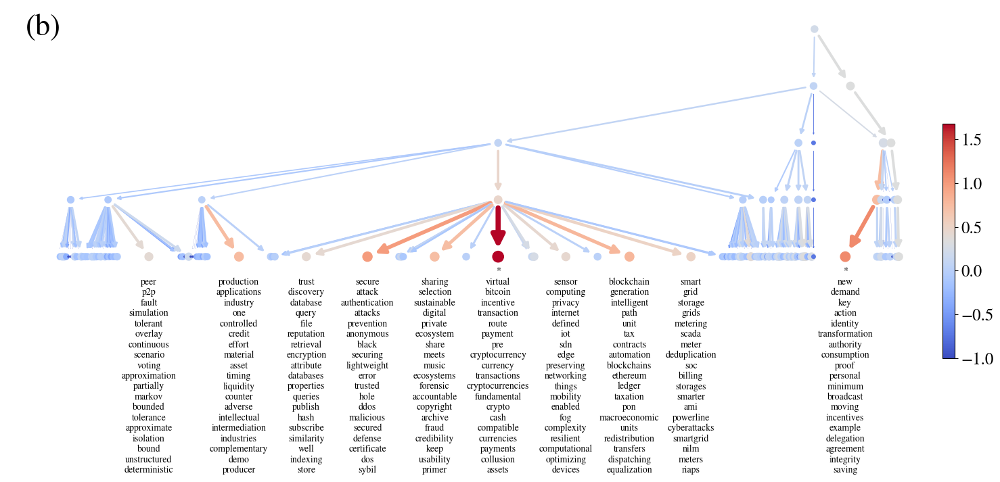

LEVEL 2 - CLUSTER 8



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'smart', 'iot', 'privacy', 'bitcoin', 'secure', 'internet', 'digital', 'sharing', 'things', 'applications', 'contracts', 'blockchains', 'ethereum', 'trust', 'storage', 'authentication', 'identity', 'preserving', 'ledger', 'proof', 'enabled', 'computing', 'cryptocurrency', 'transaction', 'edge', 'payment', 'cryptocurrencies', 'new', 'trusted', 'tracing', 'industry', 'key', 'currency', 'securing', 'private', 'contact', 'anonymous', 'transactions', 'vehicular', 'intelligent', 'lightweight', 'ecosystem', 'crypto', 'hyperledger', 'integrity', 'devices', 'verifiable', 'permissioned', 'ipfs'] 

---> TOPIC 47		normalized mixture proportion = 1.6931		mixture proportion = 0.0104
	56 WORDS - virtual - bitcoin - incentive - transaction - route - payment - pre - cryptocurrency - currency - transactions - cryptocurrencies - fundamental - crypto - cash - compatible - currencies - payments - collusion - assets - coin 

---> TOPIC 13		normalized

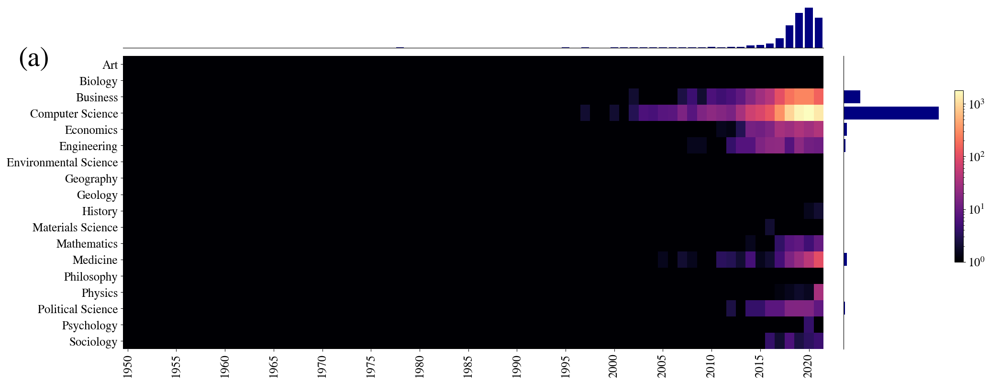

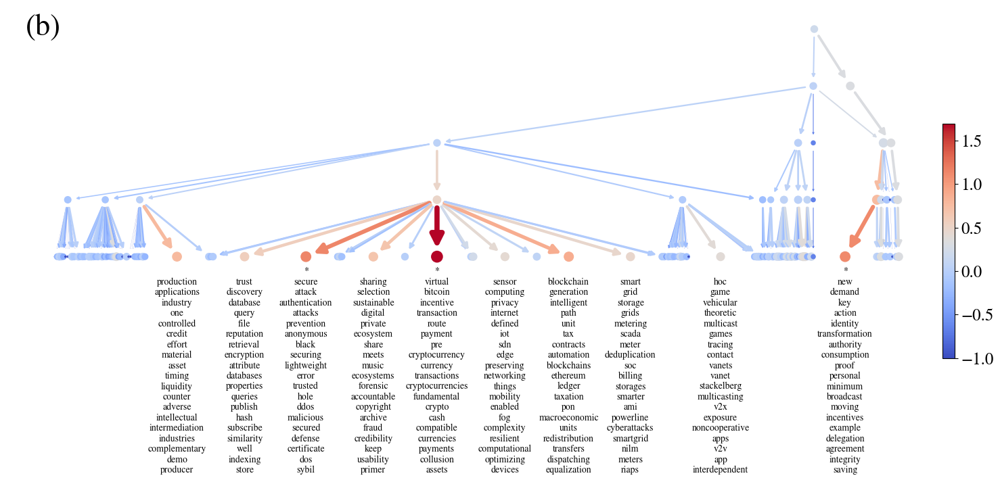

LEVEL 2 - CLUSTER 9



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['allocation', 'selection', 'cubes', 'cube', 'approach', 'node', 'simulated', 'systems', 'annealing', 'algorithm', 'intelligence', 'swarm'] 

---> TOPIC 50		normalized mixture proportion = 17.8152		mixture proportion = 0.1111
	32 WORDS - networks - analysis - algorithm - scheme - algorithms - sub - asynchronous - revenue - schemes - probabilistic - harvesting - analytical - asymmetric - heuristic - threshold - powered - maximizing - greedy - overhead - realistic 

---> TOPIC 36		normalized mixture proportion = 15.2120		mixture proportion = 0.0556
	28 WORDS - sharing - selection - sustainable - digital - private - ecosystem - share - meets - music - ecosystems - forensic - accountable - copyright - archive - fraud - credibility - keep - usability - primer - license 

---> TOPIC 84		normalized mixture proportion = 13.1564		mixture proportion = 0.0556
	22 WORDS - design - time - autonomous - hierarchical - intelligence - artificial - distance - h

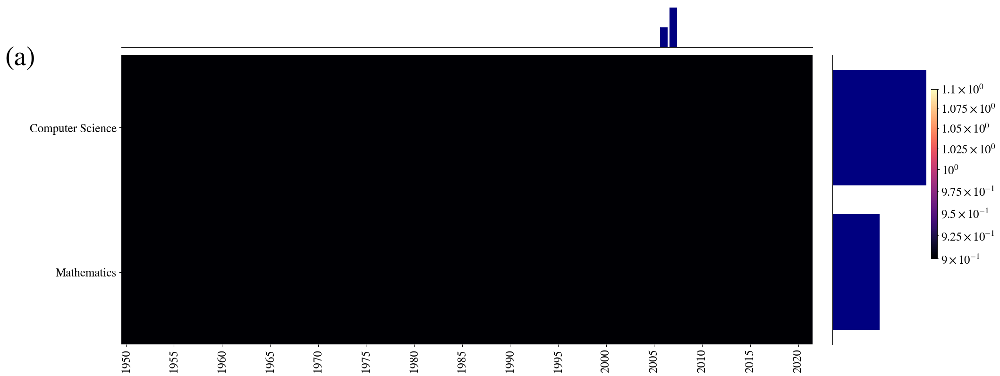

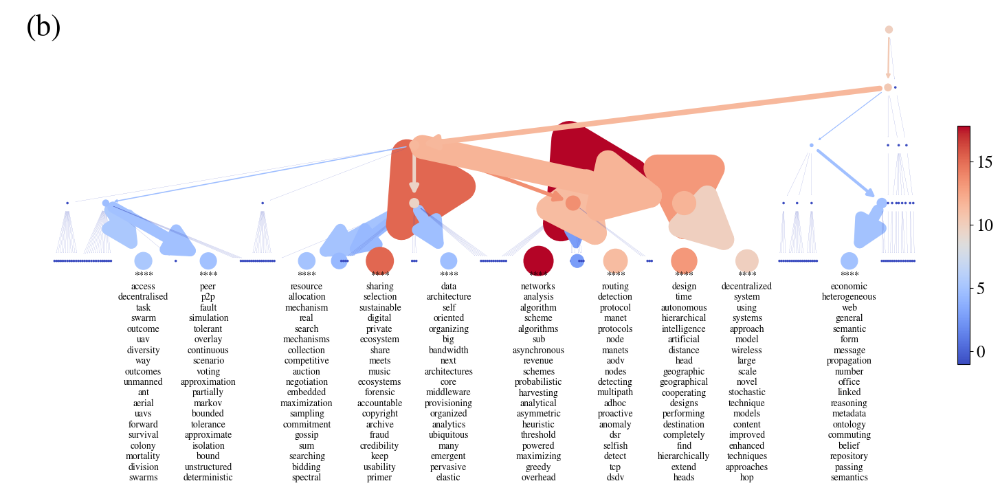







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 7



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['care', 'cancer', 'centralizers', 'patient', 'clinical', 'hospital', 'centralizer', 'centralization', 'finite', 'algebra', 'surgery', 'health', 'hiv', 'cat', 'trial', 'centralis', 'disease', 'rat', 'ganglion', 'tuberculosis', 'volume', 'ring', 'drug', 'screening', 'therapy', 'surgical', 'lie', 'low', 'patients', 'blood', 'medical', 'retinal', 'central', 'africa', 'subgroup', 'nucleus', 'south', 'brain', 'primary', 'retina', 'simple', 'rural', 'activity', 'child', 'nerve', 'acute', 'rings', 'sympathetic', 'neuron', 'cervical'] 

---> TOPIC 7		normalized mixture proportion = 2.9816		mixture proportion = 0.2020
	1449 WORDS - centralization - cancer - centralizers - clinical - centralisation - centralizer - algebra - surgery - partial - trial - ring - cat - volume - presence - centralis - rat - ganglion - child - visual - associated 

---> TOPIC 10		normalized mixture proportion = 1.4698		mixture proportion = 0.0426
	329 WORDS - health - care - l

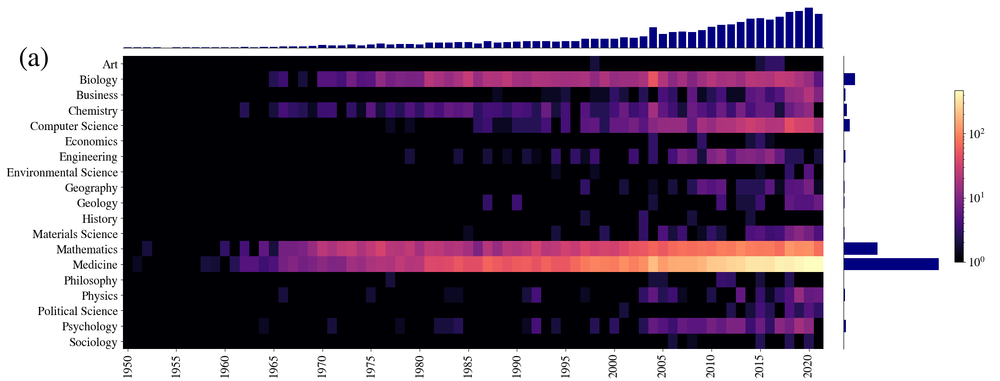

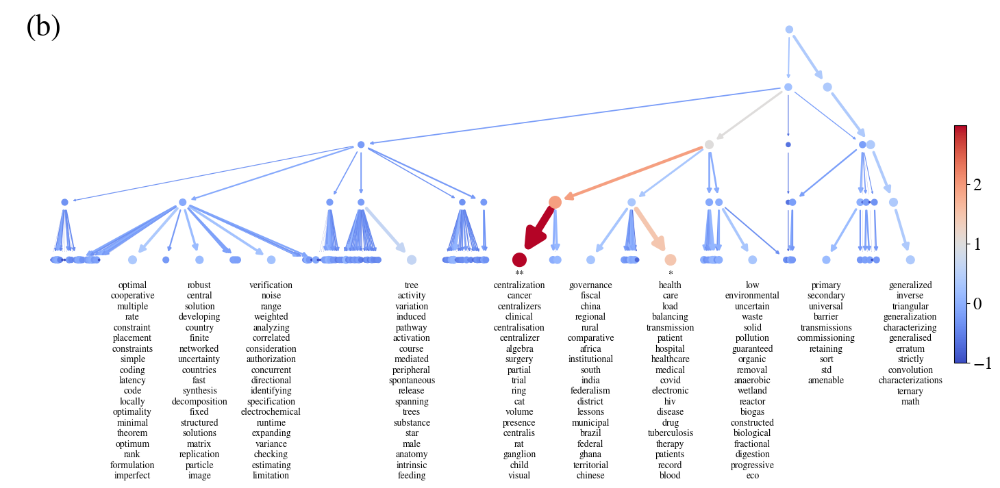

LEVEL 2 - CLUSTER 10



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['centralizers', 'centralizer', 'finite', 'algebra', 'cat', 'centralis', 'rat', 'ganglion', 'ring', 'lie', 'retinal', 'subgroup', 'nucleus', 'centralization', 'retina', 'simple', 'nerve', 'rings', 'neuron', 'sympathetic', 'activity', 'algebras', 'brain', 'element', 'generalized', 'pain', 'prime', 'central', 'vowel', 'involution', 'visual', 'superior', 'glossina', 'cervical', 'semiprime', 'jordan', 'stimulation', 'morsitans', 'radial', 'low', 'automorphisms', 'patient', 'nervous', 'theorem', 'induced', 'trypanosoma', 'spinal', 'derivations', 'nilpotent', 'projection'] 

---> TOPIC 7		normalized mixture proportion = 4.4854		mixture proportion = 0.2532
	1449 WORDS - centralization - cancer - centralizers - clinical - centralisation - centralizer - algebra - surgery - partial - trial - ring - cat - volume - presence - centralis - rat - ganglion - child - visual - associated 

---> TOPIC 85		normalized mixture proportion = 1.5638		mixture proportio

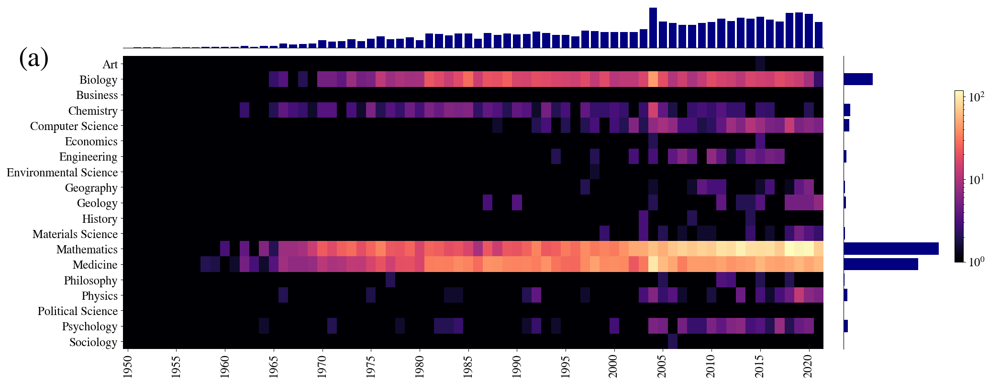

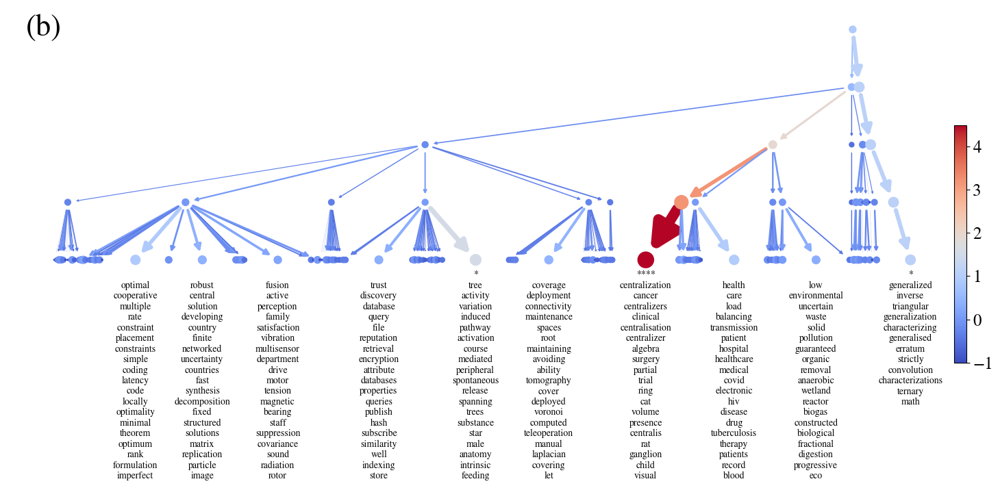

LEVEL 2 - CLUSTER 29



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['care', 'cancer', 'study', 'patient', 'treatment', 'hospital', 'clinical', 'based', 'health', 'surgery', 'hiv', 'trial', 'tuberculosis', 'centralization', 'disease', 'volume', 'screening', 'drug', 'therapy', 'medical', 'surgical', 'africa', 'population', 'rural', 'south', 'patients', 'blood', 'child', 'primary', 'case', 'community', 'antiretroviral', 'breast', 'among', 'use', 'acute', 'pharmacy', 'pancreatic', 'diabetes', 'low', 'centralisation', 'cohort', 'assessment', 'early', 'associated', 'stroke', 'pediatric', 'ovarian', 'hepatitis', 'randomised'] 

---> TOPIC 10		normalized mixture proportion = 2.6575		mixture proportion = 0.0592
	329 WORDS - health - care - load - balancing - transmission - patient - hospital - healthcare - medical - covid - electronic - hiv - disease - drug - tuberculosis - therapy - patients - record - blood - mental 

---> TOPIC 7		normalized mixture proportion = 2.1348		mixture proportion = 0.1447
	1449 WORDS - cen

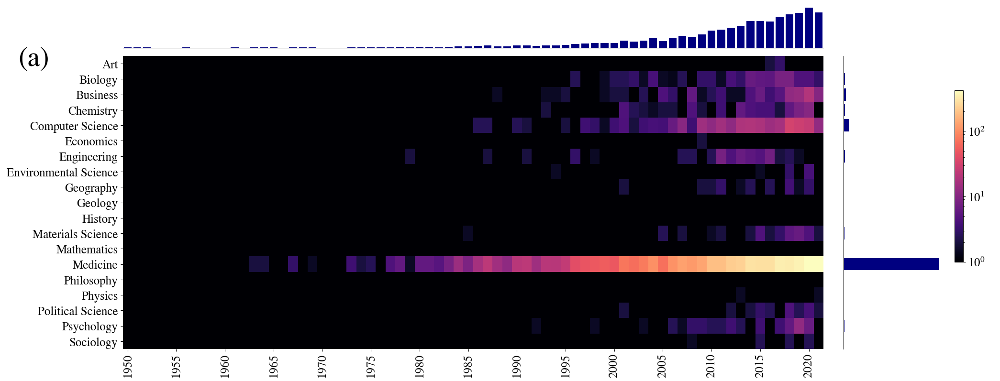

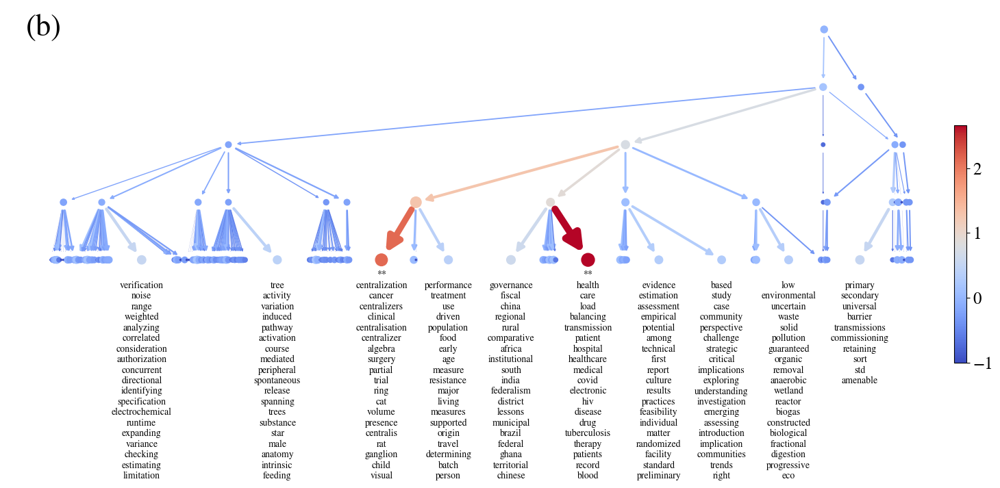







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 8



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['learning', 'web', 'communication', 'field', 'gradient', 'mean', 'semantic', 'convex', 'framework', 'convergence', 'online', 'sequential', 'linked', 'descent', 'collaborative', 'random', 'channel', 'nash', 'admm', 'ontology', 'heterogeneous', 'platform', 'hypothesis', 'deep', 'classification', 'user', 'equilibrium', 'primal', 'scalable', 'quickest', 'joint', 'metadata', 'accelerated', 'sparql', 'context', 'nonparametric', 'statistical', 'nonconvex', 'proximal', 'reasoning', 'newton', 'channels', 'interoperability', 'alternating', 'composite', 'fading', 'observations', 'observation', 'general', 'equilibria'] 

---> TOPIC 32		normalized mixture proportion = 1.4352		mixture proportion = 0.0237
	119 WORDS - economic - heterogeneous - web - general - semantic - form - message - propagation - number - office - linked - reasoning - metadata - ontology - commuting - belief - repository - passing - semantics - guarantees 

---> TOPIC 45		normalized mi

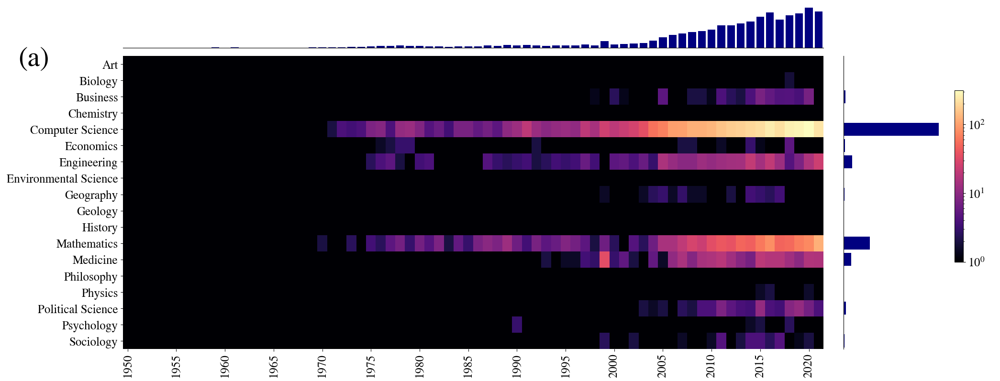

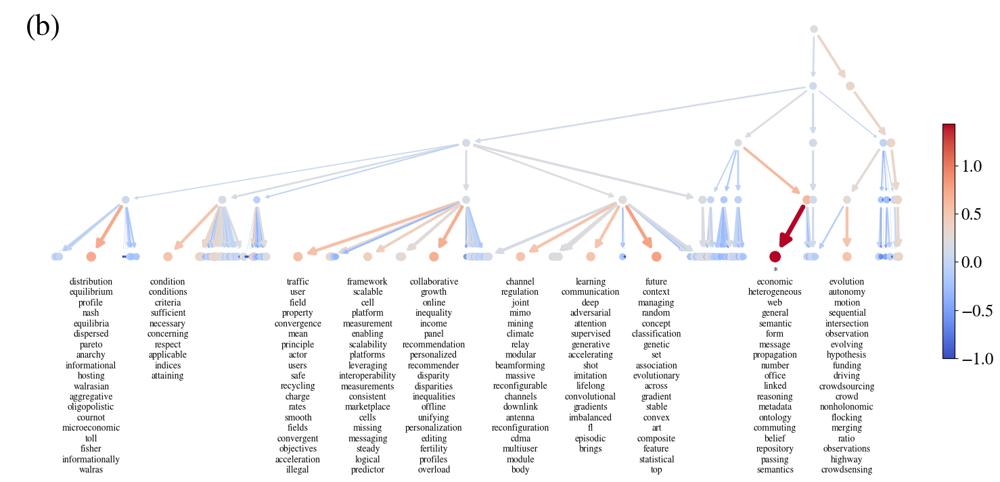

LEVEL 2 - CLUSTER 11



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['control', 'mean', 'field', 'linear', 'quadratic', 'rfid', 'nash', 'equilibrium', 'lqg', 'feedback', 'theory', 'reader', 'controller', 'coupled', 'equilibria', 'output', 'aggregative', 'discrete', 'markov', 'class', 'convergence', 'generalized', 'backward', 'stabilization', 'principle', 'static', 'partially', 'sufficient', 'certainty', 'equivalence', 'input', 'coupling', 'horizon', 'remote', 'optima', 'method', 'deterministic', 'h2', 'approximate', 'tag', 'lq', 'controllers', 'order', 'interconnected', 'continuous', 'subject', 'regulator', 'approximation', 'modeling', 'leader'] 

---> TOPIC 31		normalized mixture proportion = 3.6619		mixture proportion = 0.0119
	29 WORDS - distribution - equilibrium - profile - nash - equilibria - dispersed - pareto - anarchy - informational - hosting - walrasian - aggregative - oligopolistic - cournot - microeconomic - toll - fisher - informationally - walras - sticky 

---> TOPIC 90		normalized mixture prop

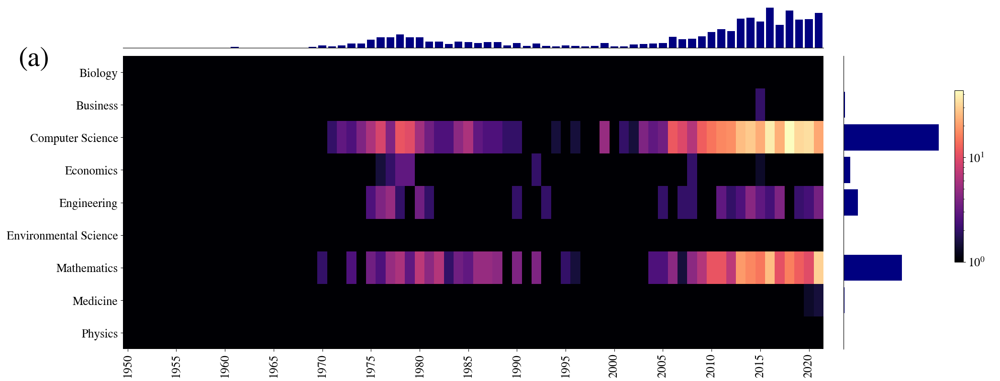

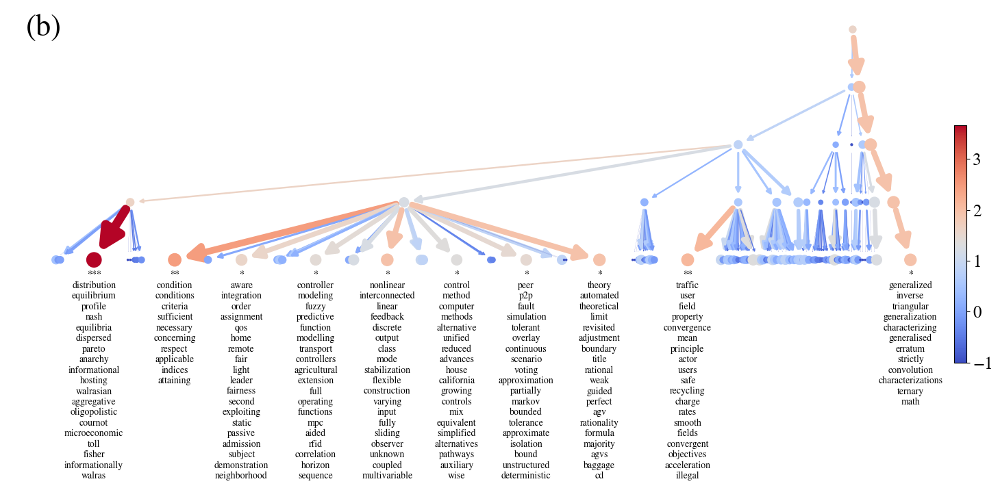

LEVEL 2 - CLUSTER 12



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['detection', 'learning', 'communication', 'gradient', 'convex', 'optimal', 'convergence', 'sparse', 'descent', 'rate', 'bayesian', 'admm', 'random', 'multiple', 'channel', 'cooperative', 'graph', 'graphs', 'deep', 'constraints', 'constraint', 'primal', 'classification', 'joint', 'topology', 'regression', 'compressed', 'accelerated', 'node', 'subspace', 'nonconvex', 'proximal', 'newton', 'statistical', 'coding', 'inference', 'generalized', 'alternating', 'field', 'cfar', 'sparsity', 'target', 'composite', 'fading', 'channels', 'radar', 'kernel', 'saddle', 'incremental', 'beamforming'] 

---> TOPIC 45		normalized mixture proportion = 1.9752		mixture proportion = 0.0446
	153 WORDS - future - context - managing - random - concept - classification - genetic - set - association - evolutionary - across - gradient - stable - convex - art - composite - feature - statistical - top - hierarchy 

---> TOPIC 67		normalized mixture proportion = 1.7823		mix

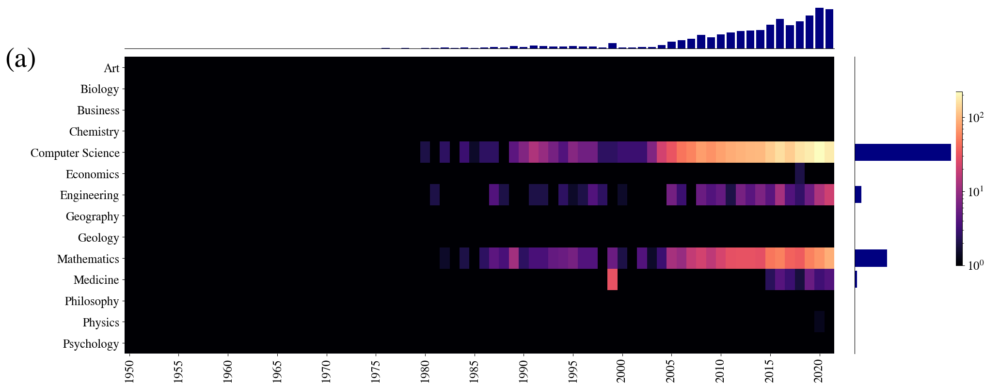

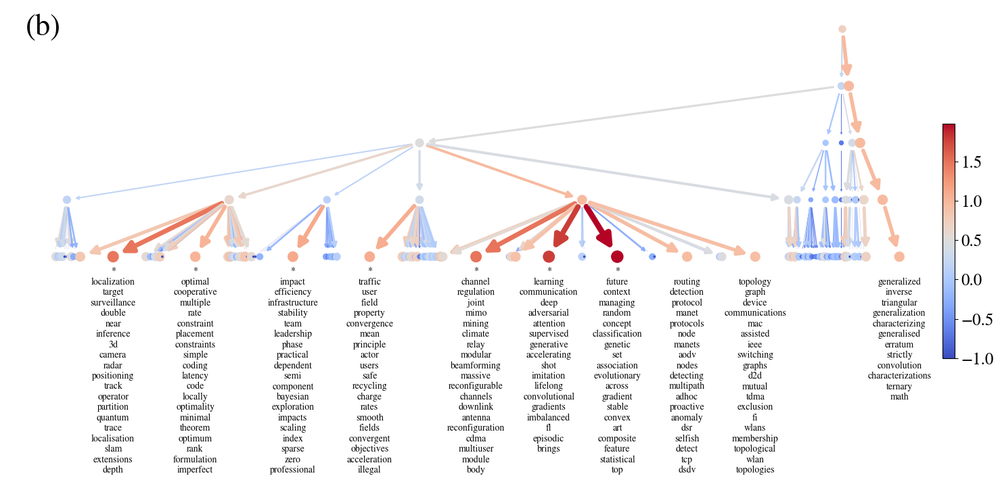

LEVEL 2 - CLUSTER 13



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['web', 'health', 'semantic', 'knowledge', 'framework', 'linked', 'rdf', 'ontology', 'processing', 'sharing', 'platform', 'care', 'query', 'collaborative', 'digital', 'quality', 'metadata', 'sparql', 'database', 'technology', 'program', 'learning', 'reasoning', 'discovery', 'interoperability', 'rio', 'disease', 'scalable', 'paulo', 'healthcare', 'heterogeneous', 'querying', 'são', 'em', 'saúde', 'medical', 'gerais', 'janeiro', 'minas', 'collaboration', 'communication', 'retrieval', 'brasil', 'visualization', 'publishing', 'scientific', 'tuberculosis', 'chagas', 'crawler', 'repository'] 

---> TOPIC 32		normalized mixture proportion = 2.7865		mixture proportion = 0.0354
	119 WORDS - economic - heterogeneous - web - general - semantic - form - message - propagation - number - office - linked - reasoning - metadata - ontology - commuting - belief - repository - passing - semantics - guarantees 

---> TOPIC 43		normalized mixture proportion = 0.97

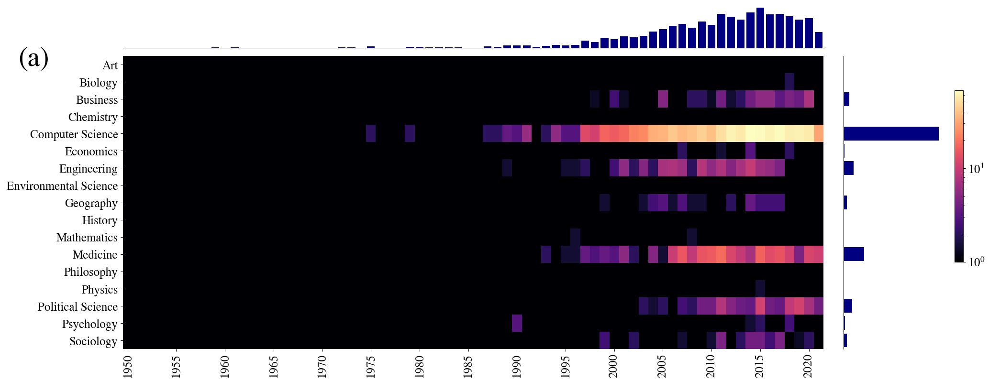

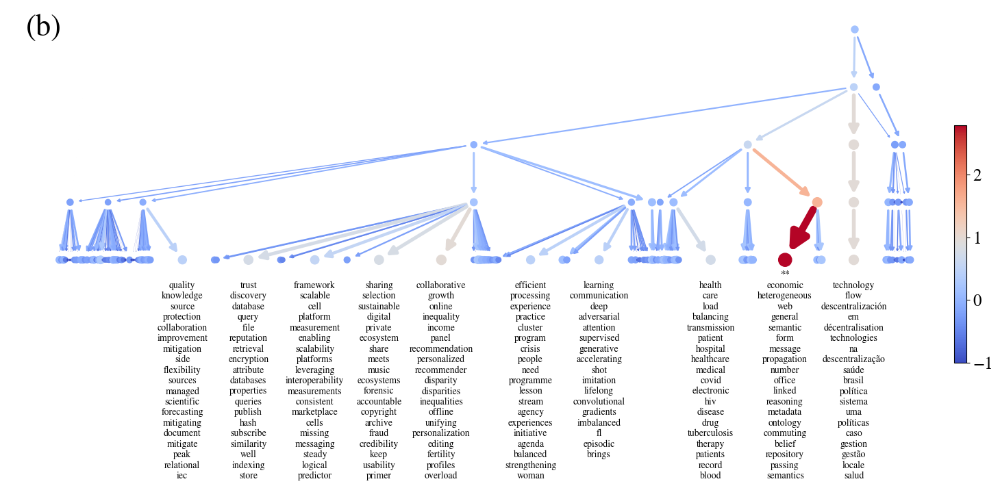







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 9



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['agent', 'problem', 'optimal', 'coverage', 'equilibrium', 'planning', 'coordination', 'coding', 'constraint', 'synchronization', 'cooperative', 'money', 'endogenous', 'cooperation', 'multiple', 'agents', 'dea', 'capital', 'solving', 'risk', 'multiagent', 'hybrid', 'connectivity', 'production', 'problems', 'code', 'rate', 'applications', 'liquidity', 'bargaining', 'distribution', 'railway', 'stage', 'punishment', 'welfare', 'asset', 'competition', 'deployment', 'assurance', 'maintenance', 'train', 'envelopment', 'counter', 'intermediation', 'adverse', 'codes', 'optimality', 'erasure', 'credit', 'labor'] 

---> TOPIC 109		normalized mixture proportion = 2.5960		mixture proportion = 0.0042
	23 WORDS - money - manager - fiat - macroeconomics - nominal - dichotomy - balances - bubble - wright - neutrality - lagos - op - barter - indeterminacy - disequilibrium - keynes - sm - curtain - sitting - microfoundations 

---> TOPIC 111		normalized mixture

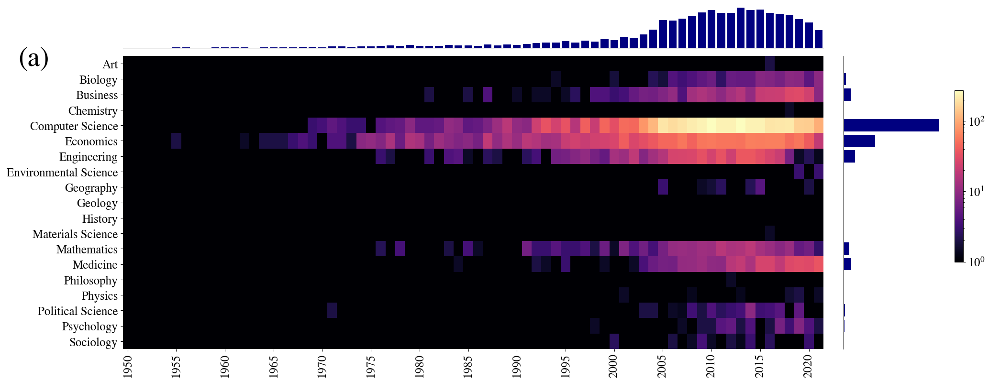

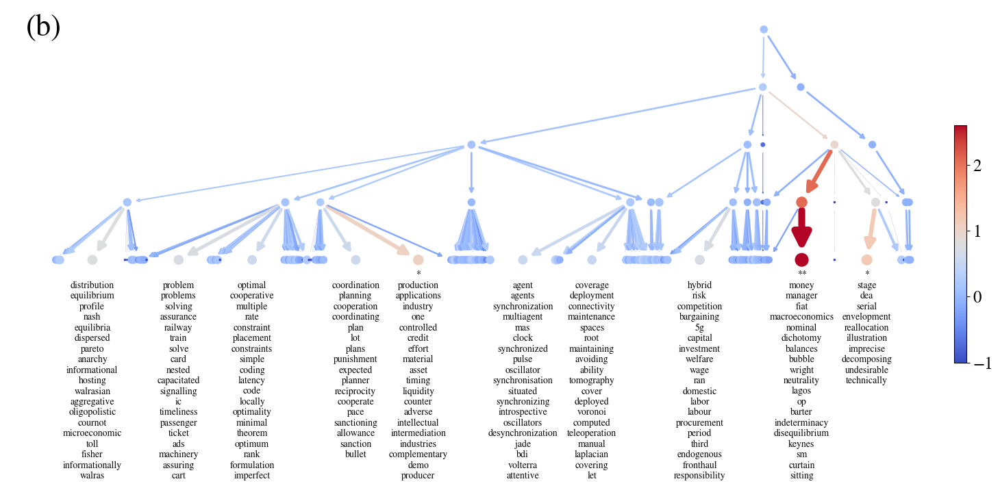

LEVEL 2 - CLUSTER 14



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['networks', 'algorithm', 'routing', 'protocol', 'clustering', 'coverage', 'topology', 'lifetime', 'synchronization', 'algorithms', 'node', 'scheme', 'gathering', 'connectivity', 'protocols', 'graph', 'analysis', 'forwarding', 'mac', 'deployment', 'detection', 'maximizing', 'sink', 'harvesting', 'application', 'layer', 'two', 'leach', 'duty', 'joint', 'coded', 'radio', 'relay', 'clock', 'channel', 'nodes', 'disjoint', 'heuristic', 'video', 'packet', 'interference', 'pulse', 'maintenance', 'cover', 'station', 'limited', 'agent', 'communications', 'assisted', 'probabilistic'] 

---> TOPIC 96		normalized mixture proportion = 1.7905		mixture proportion = 0.0106
	44 WORDS - coverage - deployment - connectivity - maintenance - spaces - root - maintaining - avoiding - ability - tomography - cover - deployed - voronoi - computed - teleoperation - manual - laplacian - covering - let - maintain 

---> TOPIC 17		normalized mixture proportion = 1.4375		mi

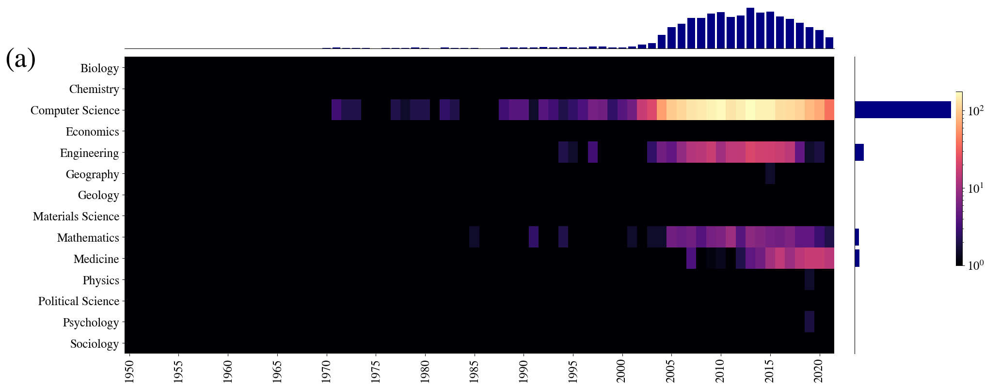

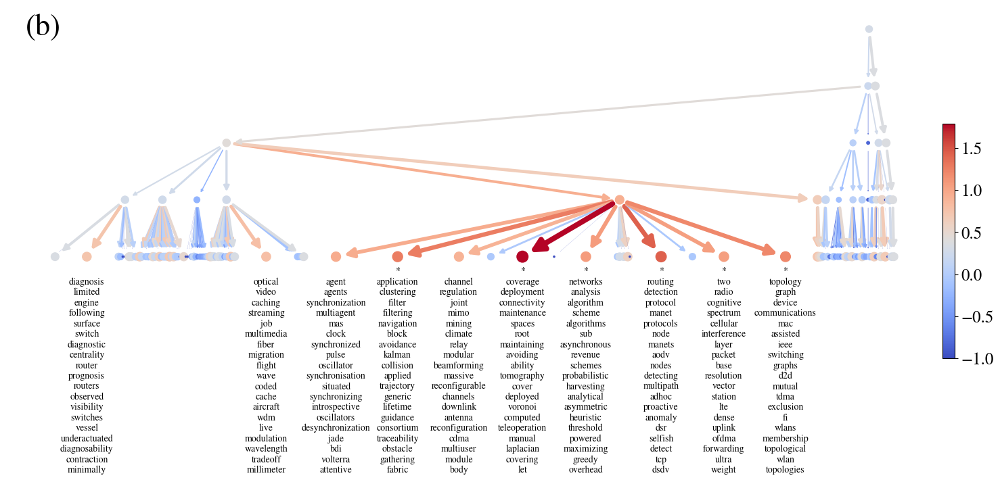

LEVEL 2 - CLUSTER 15



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['equilibrium', 'planning', 'optimal', 'coordination', 'problem', 'constraint', 'money', 'endogenous', 'economic', 'cooperation', 'dea', 'capital', 'heterogeneous', 'general', 'solving', 'risk', 'production', 'liquidity', 'bargaining', 'cooperative', 'railway', 'problems', 'punishment', 'welfare', 'stage', 'asset', 'assurance', 'envelopment', 'train', 'competition', 'counter', 'incentive', 'intermediation', 'adverse', 'web', 'multiple', 'repository', 'applications', 'labor', 'credit', 'optimality', 'distribution', 'reasoning', 'externalities', 'investment', 'externality', 'plan', 'simple', 'rate', 'walrasian'] 

---> TOPIC 109		normalized mixture proportion = 3.6759		mixture proportion = 0.0050
	23 WORDS - money - manager - fiat - macroeconomics - nominal - dichotomy - balances - bubble - wright - neutrality - lagos - op - barter - indeterminacy - disequilibrium - keynes - sm - curtain - sitting - microfoundations 

---> TOPIC 111		normalized 

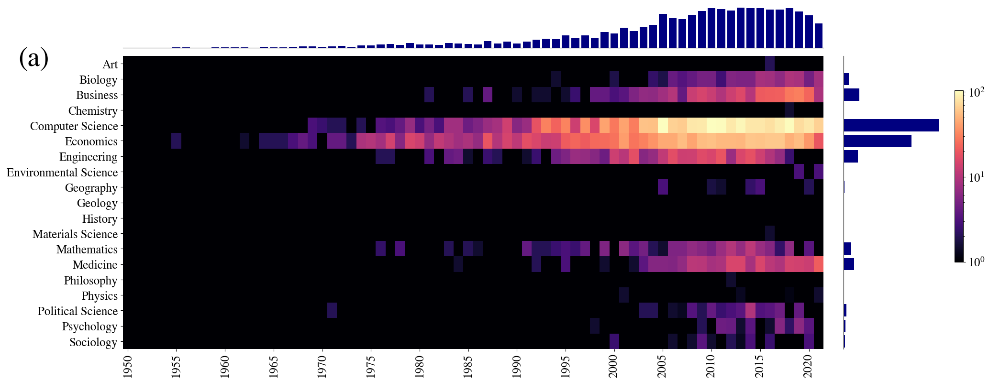

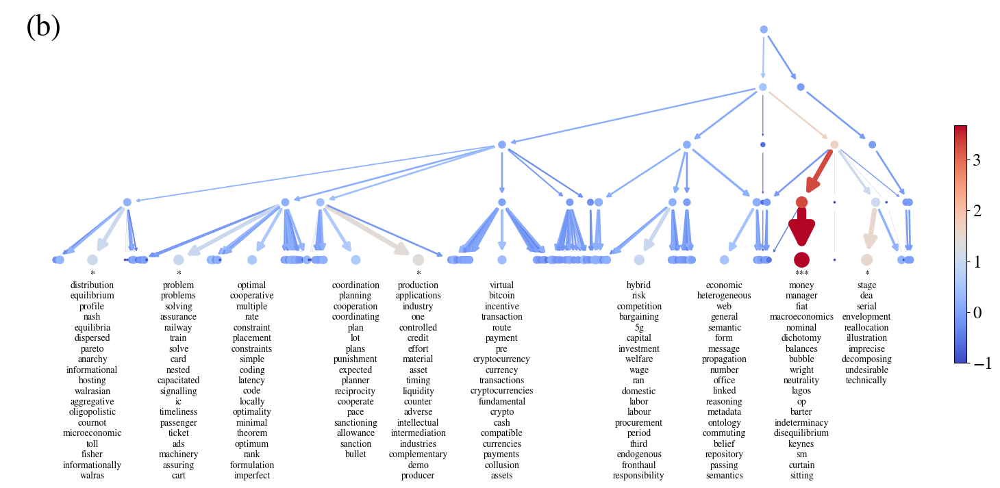







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 10



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['routing', 'radio', 'protocol', 'defined', 'sdn', 'channel', 'manet', 'cognitive', 'sensor', 'detection', 'spectrum', 'attack', 'protocols', 'interference', 'optical', 'cellular', 'mimo', 'secure', 'networking', 'manets', 'aodv', 'localization', 'joint', 'relay', 'mac', 'attacks', 'device', 'layer', 'ieee', 'packet', 'node', 'caching', 'beamforming', 'downlink', 'communications', 'path', 'fiber', 'hole', 'mobility', 'lte', 'plane', 'antenna', 'two', 'massive', 'uplink', 'ddos', 'openflow', 'ofdma', 'cdma', 'multiuser'] 

---> TOPIC 63		normalized mixture proportion = 1.6290		mixture proportion = 0.0156
	103 WORDS - optical - video - caching - streaming - job - multimedia - fiber - migration - flight - wave - coded - cache - aircraft - wdm - live - modulation - wavelength - tradeoff - millimeter - ethernet 

---> TOPIC 17		normalized mixture proportion = 1.5446		mixture proportion = 0.0109
	63 WORDS - routing - detection - protocol - manet - p

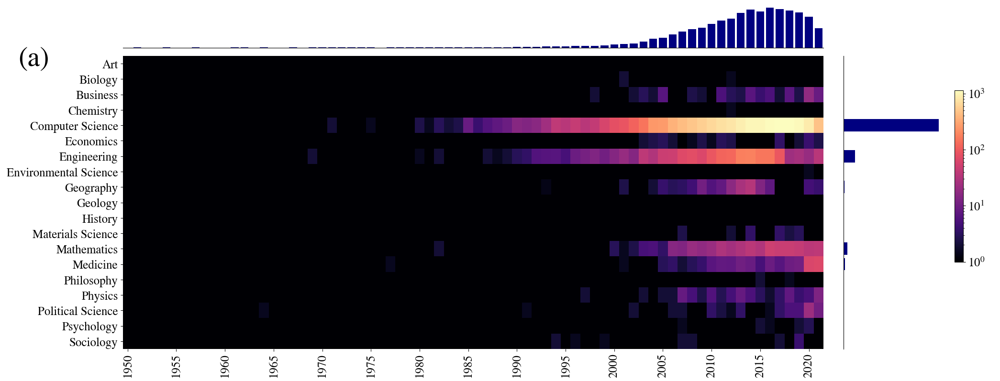

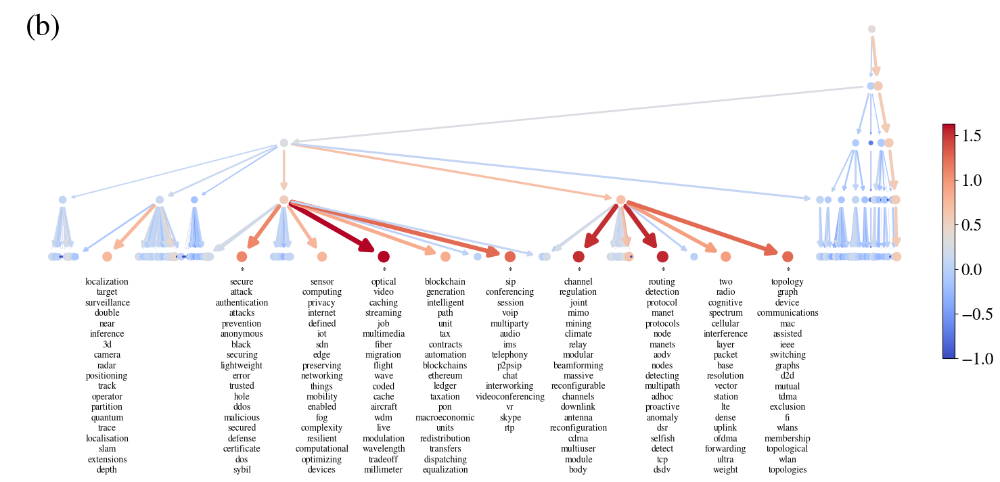

LEVEL 2 - CLUSTER 16



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['radio', 'defined', 'sdn', 'channel', 'cognitive', 'spectrum', 'interference', 'optical', 'routing', 'cellular', 'mimo', 'networking', 'protocol', 'game', 'joint', 'relay', 'detection', 'device', 'mac', 'ieee', 'hoc', 'beamforming', 'caching', 'downlink', 'layer', 'fiber', 'packet', 'plane', 'communications', 'lte', 'sensor', 'antenna', 'uplink', 'massive', 'openflow', 'ofdma', 'cdma', 'multiuser', 'wdm', 'd2d', 'two', 'attack', 'pon', 'ddos', 'enabled', 'coded', 'channels', 'base', 'dense', 'path'] 

---> TOPIC 63		normalized mixture proportion = 2.1083		mixture proportion = 0.0177
	103 WORDS - optical - video - caching - streaming - job - multimedia - fiber - migration - flight - wave - coded - cache - aircraft - wdm - live - modulation - wavelength - tradeoff - millimeter - ethernet 

---> TOPIC 94		normalized mixture proportion = 2.0214		mixture proportion = 0.0242
	138 WORDS - channel - regulation - joint - mimo - mining - climate - rela

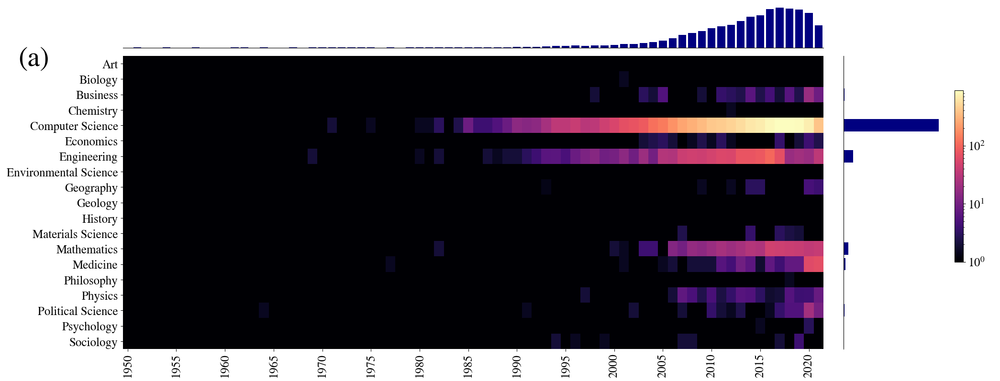

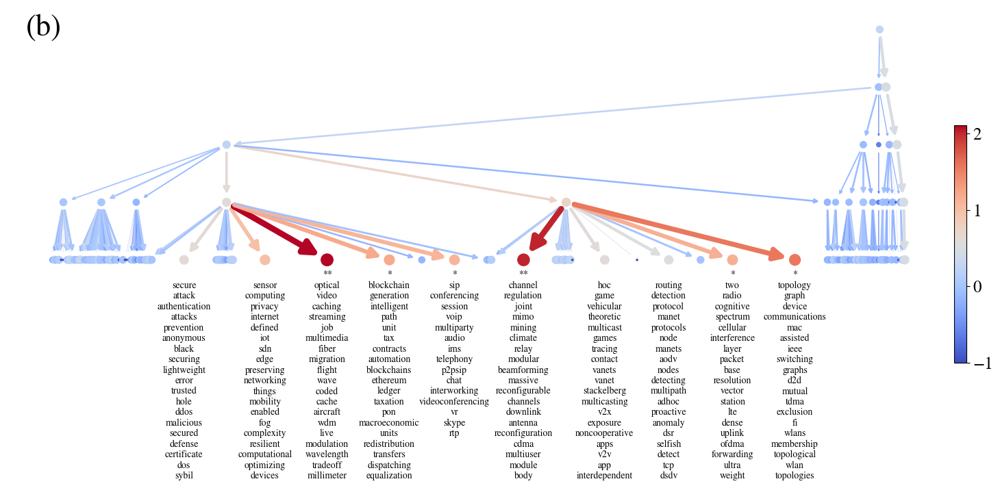

LEVEL 2 - CLUSTER 17



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['wireless', 'localization', 'using', 'decentralized', 'system', 'target', 'camera', 'structural', 'approach', 'radar', 'identification', 'damage', 'positioning', 'surveillance', 'signal', 'modal', 'systems', 'technique', 'localisation', 'indoor', 'underwater', 'large', 'location', 'mimo', 'scale', 'model', 'calibration', 'learning', 'communication', 'active', 'fusion', 'anchor', 'tdoa', 'bridge', 'array', 'cameras', 'random', 'received', 'gradient', 'multistatic', 'novel', 'zigbee', 'hop', 'classification', 'techniques', 'neural', 'rss', '3d', 'clutter', 'coherent'] 

---> TOPIC 91		normalized mixture proportion = 4.3966		mixture proportion = 0.0370
	81 WORDS - localization - target - surveillance - double - near - inference - 3d - camera - radar - positioning - track - operator - partition - quantum - trace - localisation - slam - extensions - depth - targets 

---> TOPIC 88		normalized mixture proportion = 2.0065		mixture proportion = 0.009

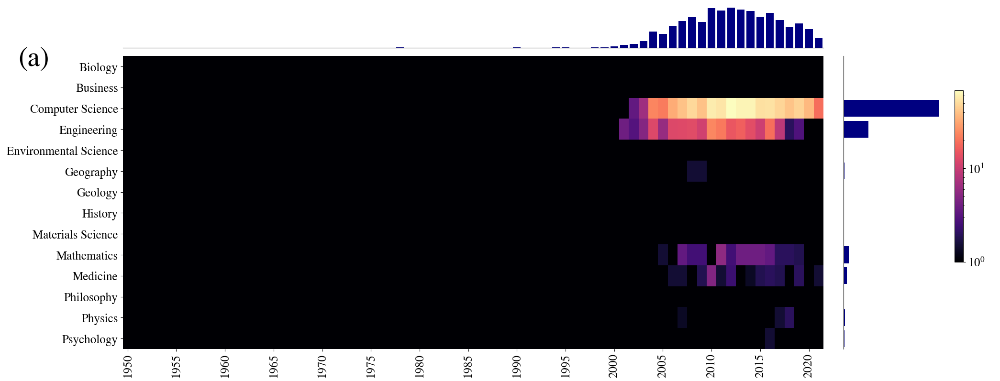

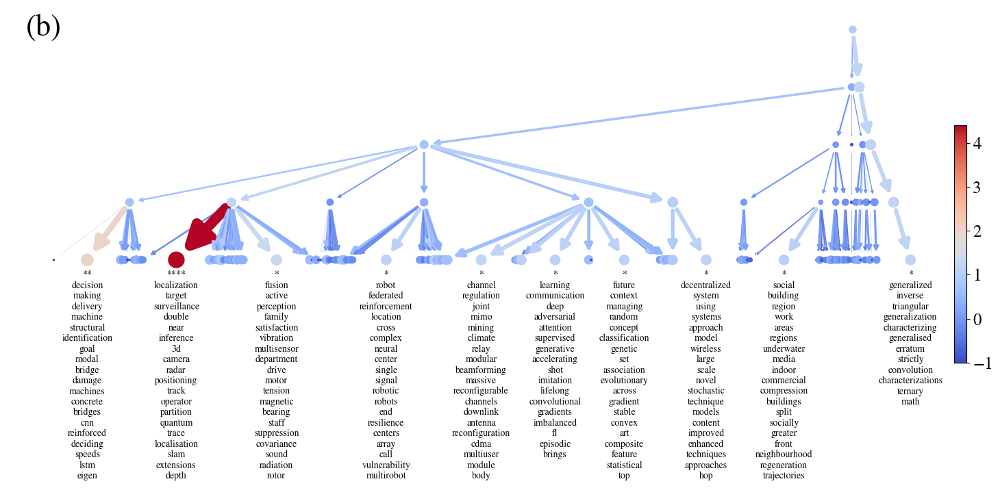

LEVEL 2 - CLUSTER 37



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['hoc', 'routing', 'protocol', 'manet', 'protocols', 'attack', 'detection', 'manets', 'aodv', 'key', 'secure', 'vehicular', 'hole', 'attacks', 'multicast', 'node', 'black', 'adhoc', 'dsr', 'mobility', 'sensor', 'congestion', 'demand', 'authentication', 'prevention', 'new', 'multipath', 'dsdv', 'time', 'design', 'vanets', 'olsr', 'nodes', 'wormhole', 'vanet', 'hierarchical', 'proactive', 'malicious', 'blackhole', 'distance', 'securing', 'agreement', 'mac', 'certificate', 'detecting', 'delay', 'internet', 'game', 'tcp', 'broadcast'] 

---> TOPIC 17		normalized mixture proportion = 4.2661		mixture proportion = 0.0238
	63 WORDS - routing - detection - protocol - manet - protocols - node - manets - aodv - nodes - detecting - multipath - adhoc - proactive - anomaly - dsr - selfish - detect - tcp - dsdv - olsr 

---> TOPIC 13		normalized mixture proportion = 3.5602		mixture proportion = 0.0384
	123 WORDS - secure - attack - authentication - attacks -

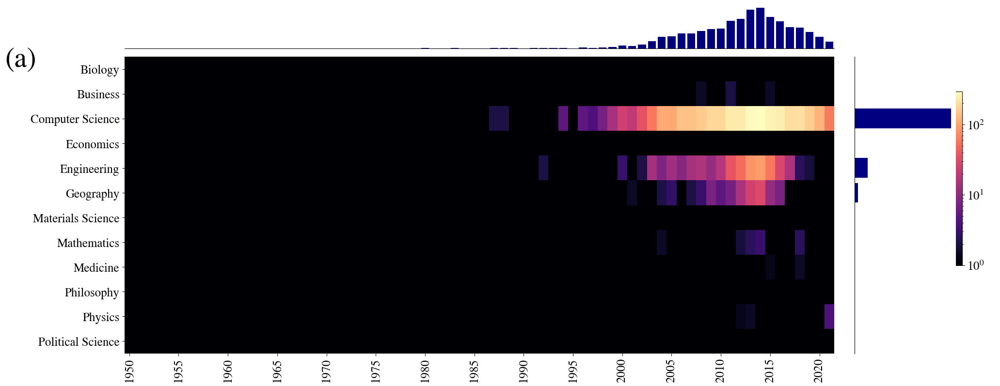

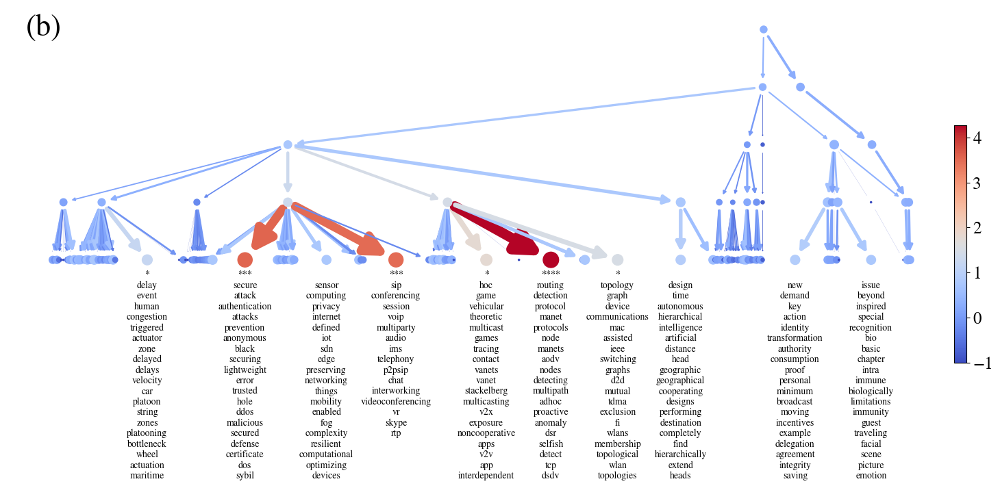







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 11



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['computing', 'edge', 'cloud', 'iot', 'fog', 'internet', 'defined', 'data', 'things', 'system', 'architecture', 'decentralized', 'sdn', 'wireless', 'offloading', 'using', 'framework', 'approach', 'systems', 'enabled', 'model', 'vehicular', 'security', 'networking', 'routing', 'sensor', 'platform', 'big', 'devices', 'analytics', 'oriented', 'protocol', 'detection', 'game', 'mobility', 'orchestration', 'novel', 'hoc', 'thing', 'large', 'scale', 'scalable', 'privacy', 'caching', 'enabling', 'strategy', 'layer', 'self', 'clouds', 'radio'] 

---> TOPIC 61		normalized mixture proportion = 2.1612		mixture proportion = 0.0426
	175 WORDS - sensor - computing - privacy - internet - defined - iot - sdn - edge - preserving - networking - things - mobility - enabled - fog - complexity - resilient - computational - optimizing - devices - plane 

---> TOPIC 15		normalized mixture proportion = 1.2494		mixture proportion = 0.0090
	42 WORDS - hoc - game - vehic

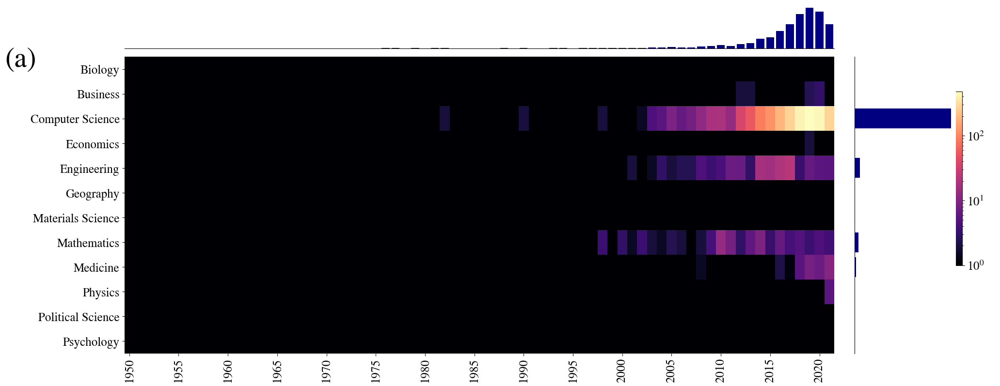

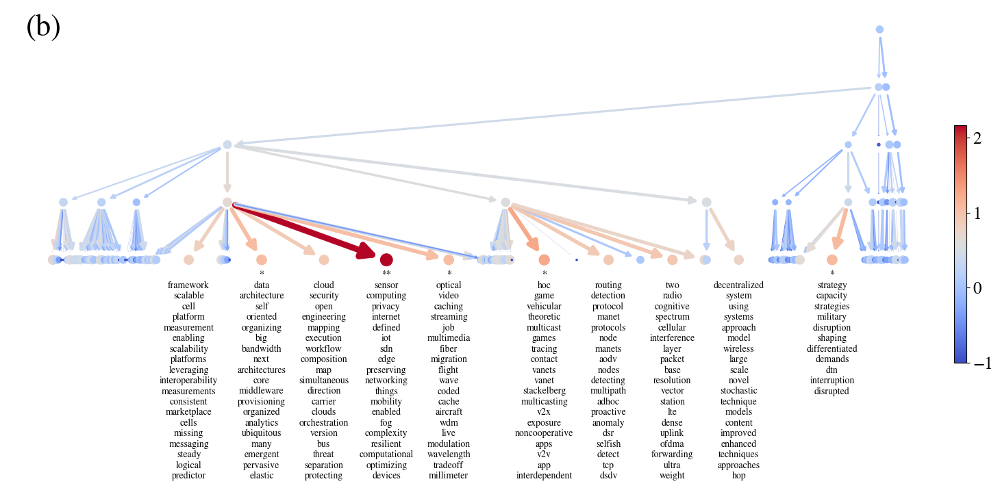

LEVEL 2 - CLUSTER 23



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['computing', 'edge', 'cloud', 'iot', 'fog', 'internet', 'defined', 'data', 'things', 'architecture', 'sdn', 'offloading', 'framework', 'enabled', 'vehicular', 'security', 'networking', 'routing', 'sensor', 'platform', 'device', 'big', 'devices', 'analytics', 'oriented', 'assisted', 'protocol', 'detection', 'game', 'mobility', 'orchestration', 'hoc', 'thing', 'scalable', 'privacy', 'caching', 'enabling', 'strategy', 'layer', 'self', 'clouds', 'radio', 'open', 'video', 'cellular', 'mec', 'virtualization', 'cognitive', 'middleware', 'migration'] 

---> TOPIC 61		normalized mixture proportion = 2.1258		mixture proportion = 0.0426
	175 WORDS - sensor - computing - privacy - internet - defined - iot - sdn - edge - preserving - networking - things - mobility - enabled - fog - complexity - resilient - computational - optimizing - devices - plane 

---> TOPIC 15		normalized mixture proportion = 1.2587		mixture proportion = 0.0090
	42 WORDS - hoc - gam

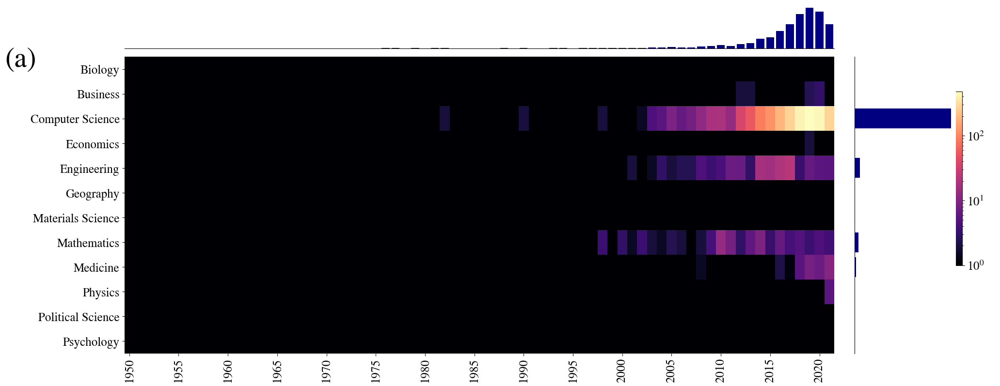

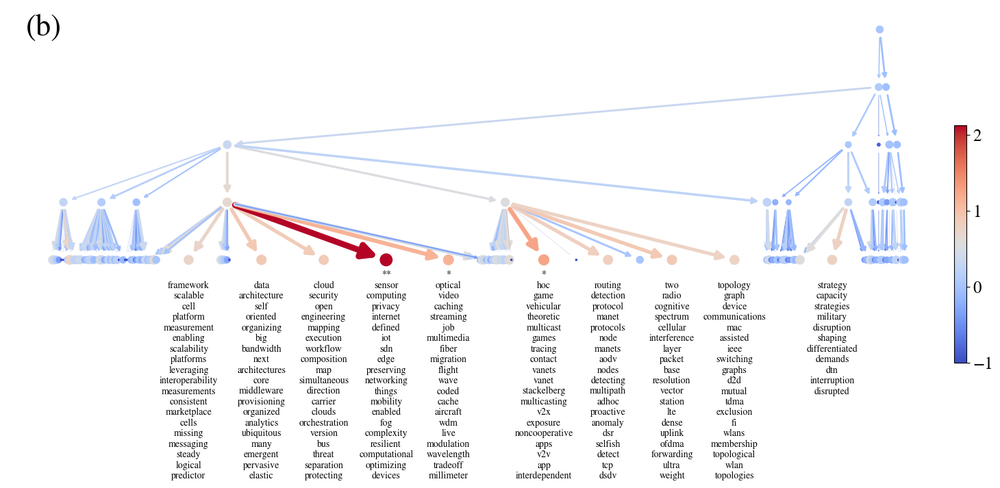







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 12



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['learning', 'federated', 'deep', 'systèmes', 'communication', 'private', 'collaborative', 'neural', 'réseaux', 'secure', 'décentralisée', 'classification', 'gestion', 'method', 'modélisation', 'approche', 'contrôle', 'réseau', 'differentially', 'attacks', 'control', 'attack', 'système', 'adversarial', 'sharing', 'commande', 'iid', 'pmu', 'conception', 'personalized', 'gradient', 'complex', 'generative', 'données', 'décentralisé', 'apprentissage', 'wide', 'recommendation', 'centralisée', 'mise', 'future', 'cross', 'électriques', 'selection', 'dynamique', 'étude', 'décentralisés', 'environnement', 'online', 'énergie'] 

---> TOPIC 67		normalized mixture proportion = 2.0259		mixture proportion = 0.0066
	17 WORDS - learning - communication - deep - adversarial - attention - supervised - generative - accelerating - shot - imitation - lifelong - convolutional - gradients - imbalanced - fl - episodic - brings 

---> TOPIC 2		normalized mixture propo

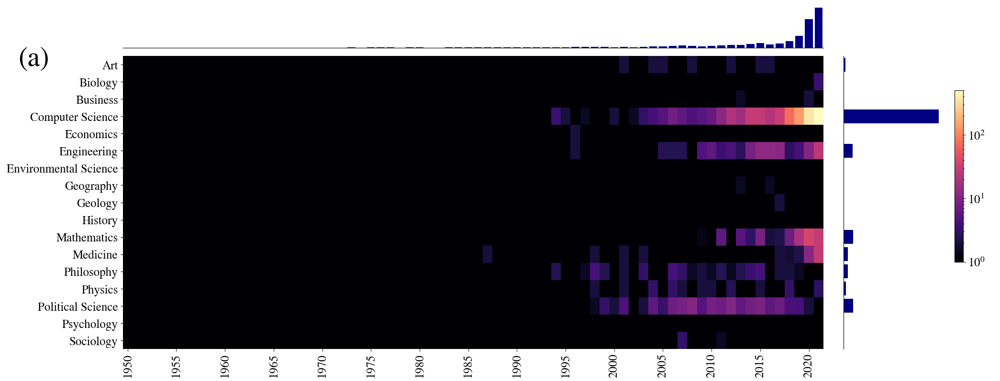

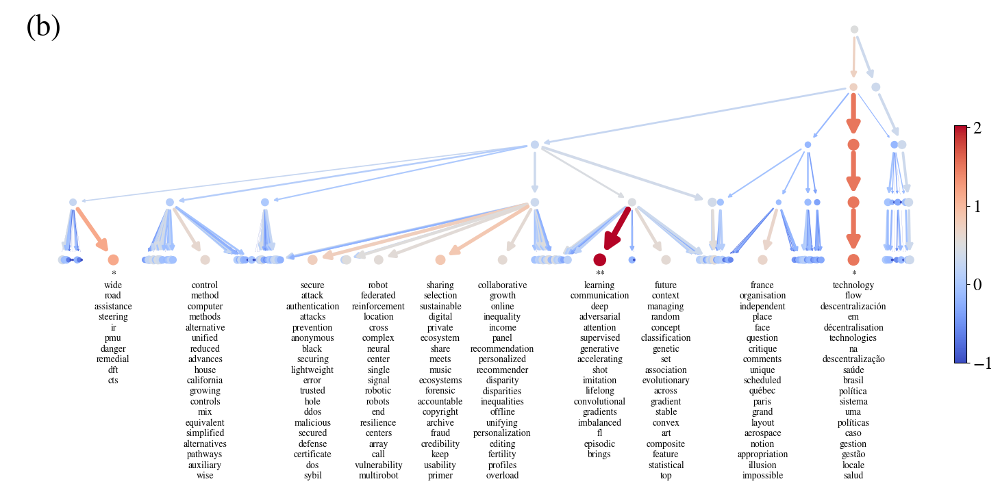

LEVEL 2 - CLUSTER 33



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['assembly', 'model', 'system', 'supermarket', 'supply', 'part', 'decentralized', 'jit', 'train', 'using', 'tow', 'storage', 'maintenance', 'material', 'house', 'production', 'logistics', 'strategy', 'warehouse', 'conveyor', 'control', 'wireless', 'industry', 'manufacturing', 'making', 'large', 'handling', 'manual', 'product', 'decision', 'mix', 'stocking', 'scale', 'automobile', 'delivery', 'layout', 'problem', 'kanban', 'independent', 'content', 'smart'] 

---> TOPIC 73		normalized mixture proportion = 5.2832		mixture proportion = 0.0123
	19 WORDS - smart - grid - storage - grids - metering - scada - meter - deduplication - soc - billing - storages - smarter - ami - powerline - cyberattacks - smartgrid - nilm - meters - riaps 

---> TOPIC 88		normalized mixture proportion = 4.8693		mixture proportion = 0.0184
	20 WORDS - decision - making - delivery - machine - structural - identification - goal - modal - bridge - damage - machines - concret

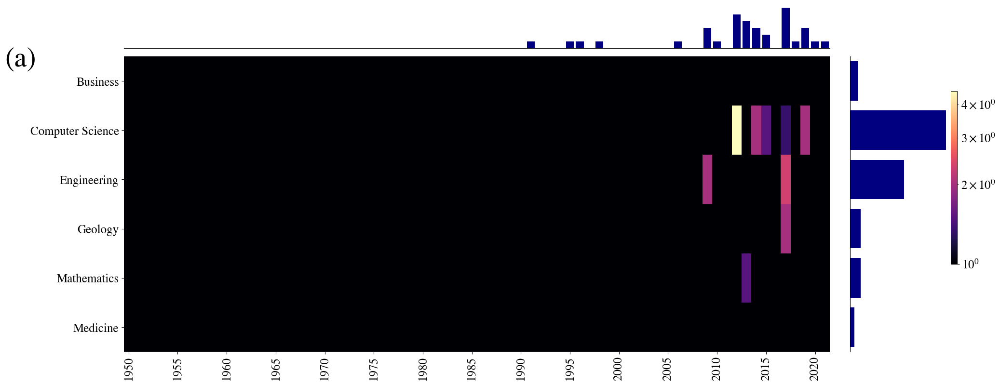

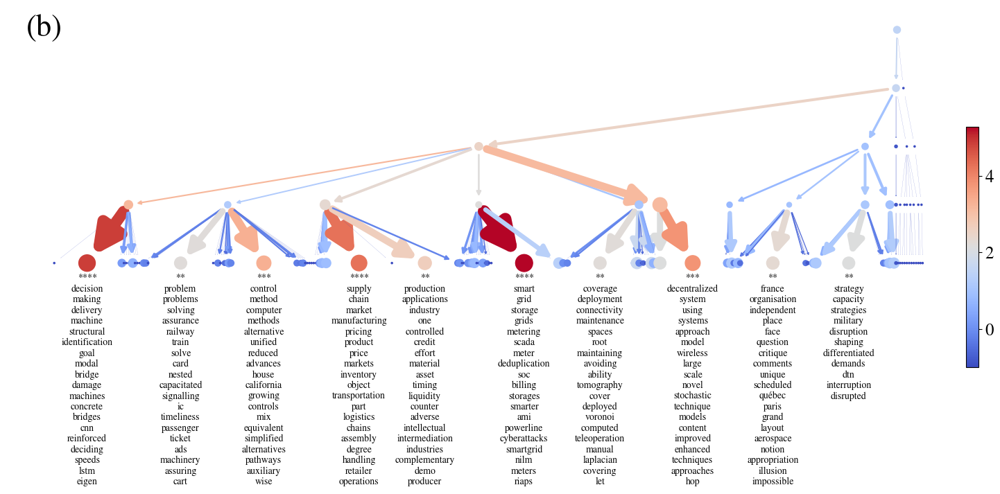

LEVEL 2 - CLUSTER 19



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['learning', 'federated', 'deep', 'framework', 'private', 'communication', 'collaborative', 'neural', 'secure', 'classification', 'device', 'differentially', 'attacks', 'attack', 'adversarial', 'sharing', 'measurement', 'graph', 'pmu', 'iid', 'personalized', 'gradient', 'generative', 'recommendation', 'wide', 'future', 'cross', 'assisted', 'communications', 'online', 'supervised', 'selection', 'unsupervised', 'scalable', 'platform', 'shot', 'lightweight', 'recommender', 'poisoning', 'measurements', 'reinforcement', 'silo', 'statistical', 'ensemble', 'generalization', 'meets', 'feature', 'descent', 'location', 'continual'] 

---> TOPIC 67		normalized mixture proportion = 2.9549		mixture proportion = 0.0089
	17 WORDS - learning - communication - deep - adversarial - attention - supervised - generative - accelerating - shot - imitation - lifelong - convolutional - gradients - imbalanced - fl - episodic - brings 

---> TOPIC 13		normalized mixture

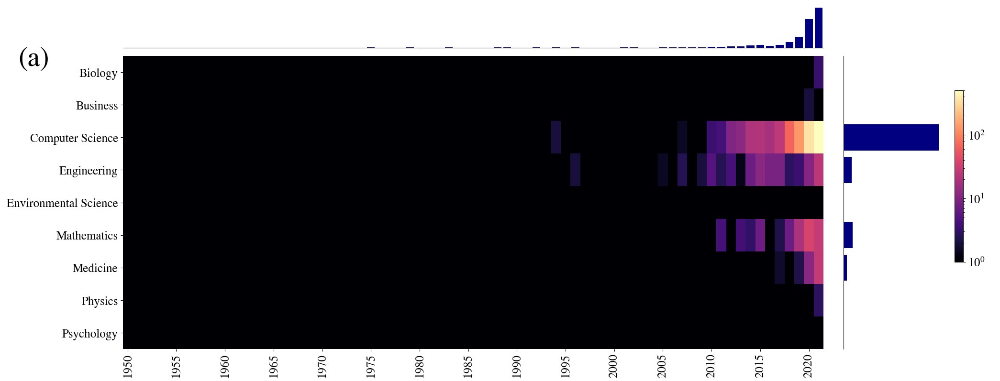

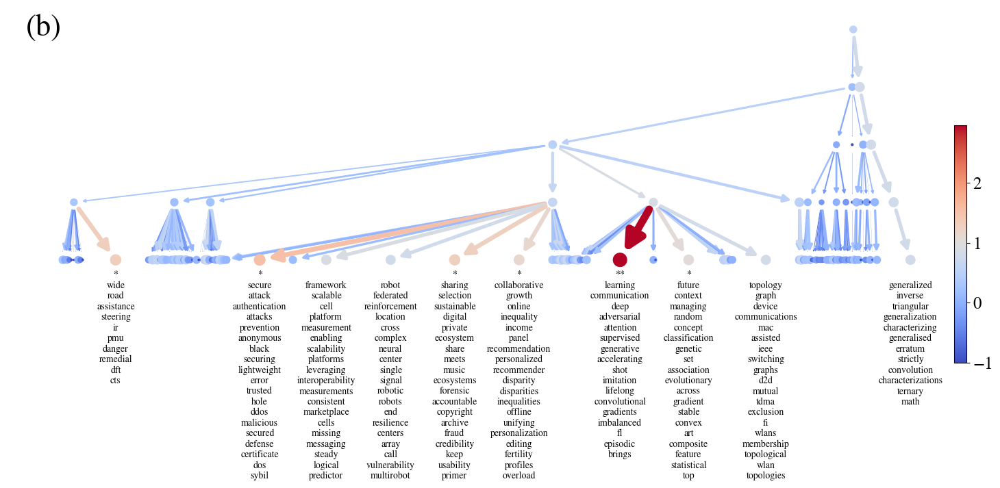

LEVEL 2 - CLUSTER 21



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['systèmes', 'agent', 'réseaux', 'décentralisée', 'gestion', 'contrôle', 'modélisation', 'approche', 'réseau', 'système', 'commande', 'contribution', 'conception', 'coordination', 'décentralisé', 'données', 'centralisée', 'apprentissage', 'électriques', 'dynamique', 'mise', 'étude', 'environnement', 'planification', 'décentralisés', 'énergie', 'analyse', 'etude', 'médicaments', 'unité', 'stockage', 'cytotoxiques', 'anticancéreux', 'vers', 'modèles', 'distribuée', 'électrique', 'pair', 'autonomes', 'intégration', 'qualité', 'préparation', 'détection', 'sans', 'organisation', 'systemes', 'décision', 'évaluation', 'smart', 'contributions'] 

---> TOPIC 2		normalized mixture proportion = 8.1510		mixture proportion = 0.4555
	2050 WORDS - technology - flow - descentralización - em - décentralisation - technologies - na - descentralização - saúde - brasil - política - sistema - uma - políticas - caso - gestion - gestão - locale - salud - dan 

---> T

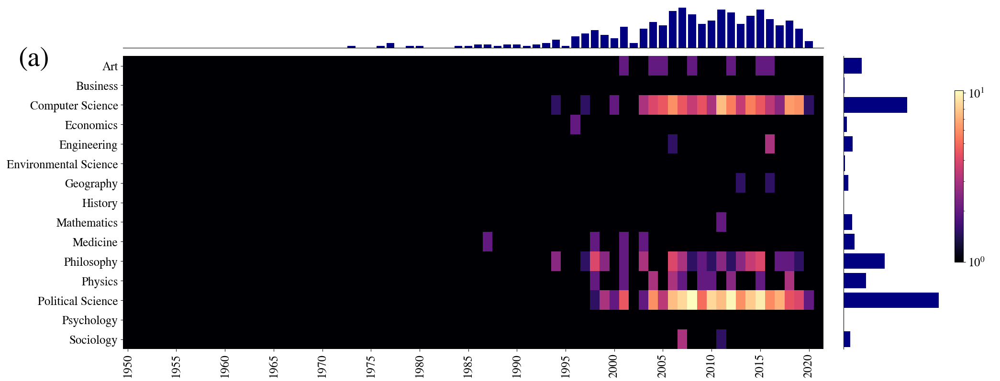

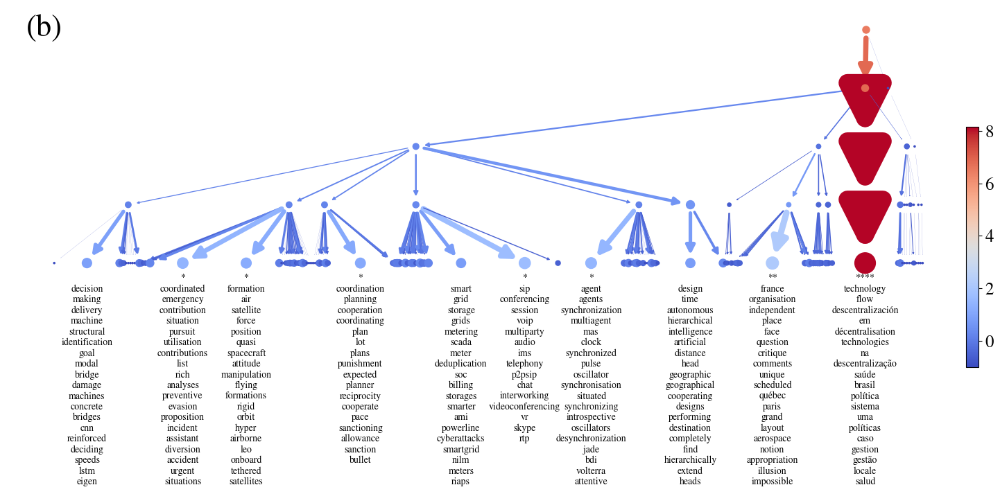







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 13



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['decentralized', 'wireless', 'system', 'detection', 'em', 'data', 'using', 'redes', 'systems', 'approach', 'sistema', 'uma', 'model', 'sistemas', 'allocation', 'resource', 'node', 'descentralizado', 'réseaux', 'modelo', 'gestión', 'fault', 'routing', 'agua', 'anomaly', 'pair', 'peer', 'estudio', 'caso', 'análisis', 'self', 'controle', 'mechanism', 'architecture', 'descentralización', 'tratamento', 'méxico', 'railway', 'real', 'problem', 'na', 'descentralizada', 'simulation', 'attack', 'protocol', 'estudo', 'análise', 'sans', 'recursos', 'large'] 

---> TOPIC 2		normalized mixture proportion = 3.9882		mixture proportion = 0.3137
	2050 WORDS - technology - flow - descentralización - em - décentralisation - technologies - na - descentralização - saúde - brasil - política - sistema - uma - políticas - caso - gestion - gestão - locale - salud - dan 

---> TOPIC 78		normalized mixture proportion = 1.0836		mixture proportion = 0.0019
	15 WORDS - sip

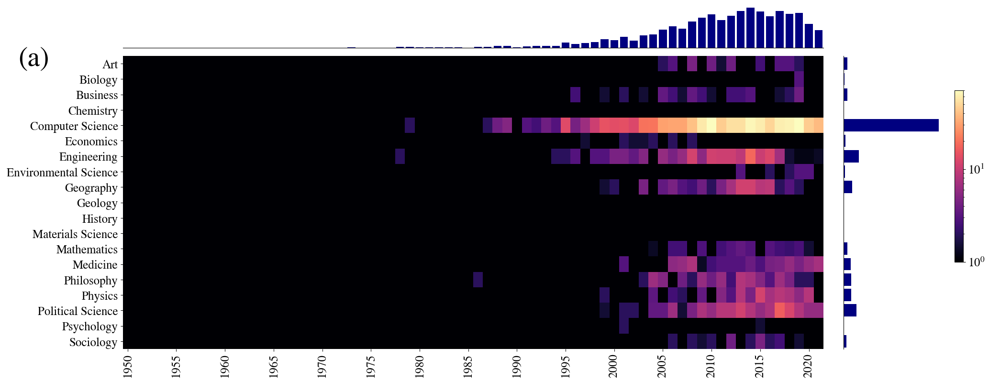

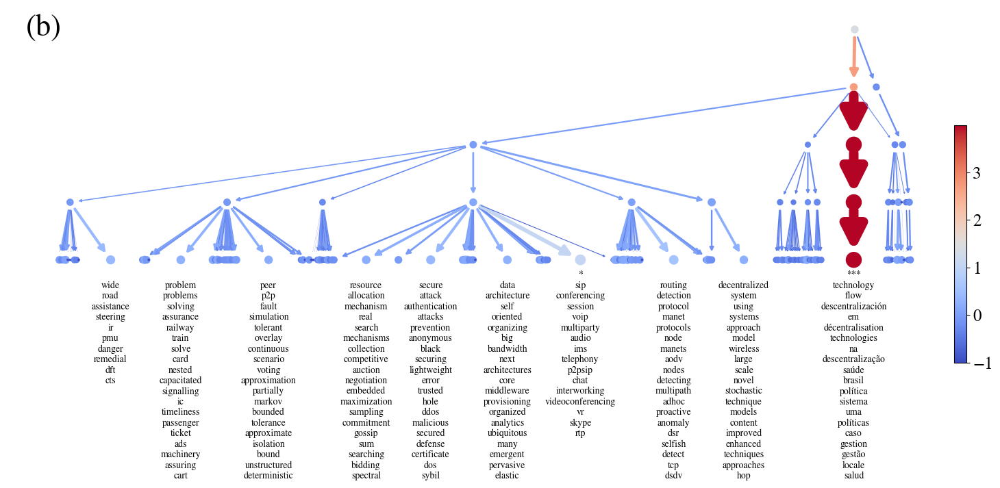

LEVEL 2 - CLUSTER 30



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['em', 'redes', 'sistema', 'uma', 'sistemas', 'descentralizado', 'réseaux', 'modelo', 'gestión', 'pair', 'agua', 'estudio', 'caso', 'análisis', 'peer', 'controle', 'descentralización', 'tratamento', 'méxico', 'railway', 'descentralizada', 'na', 'estudo', 'recursos', 'avaliação', 'análise', 'estructura', 'sans', 'cellular', 'uso', 'mobile', 'red', 'tratamiento', 'ao', 'diseño', 'architecture', 'centralización', 'desarrollo', 'servicios', 'planificación', 'data', 'centralizada', 'fil', 'systèmes', 'utilizando', 'self', 'centralizado', 'train', 'rede', 'información'] 

---> TOPIC 2		normalized mixture proportion = 8.1177		mixture proportion = 0.4539
	2050 WORDS - technology - flow - descentralización - em - décentralisation - technologies - na - descentralização - saúde - brasil - política - sistema - uma - políticas - caso - gestion - gestão - locale - salud - dan 

---> TOPIC 78		normalized mixture proportion = 1.6674		mixture proportion = 0.00

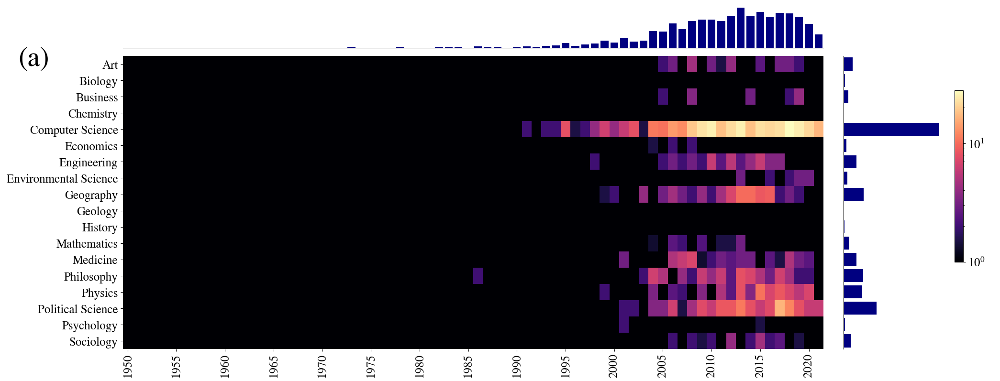

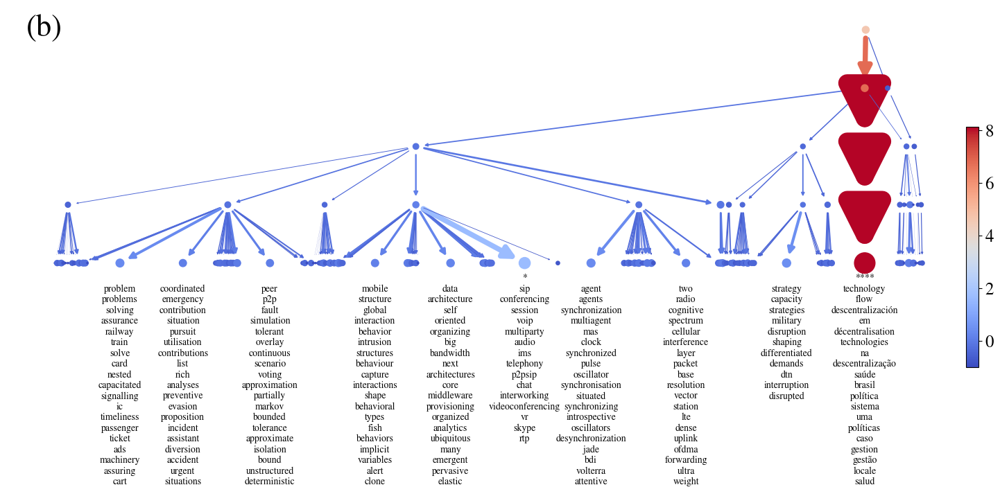

LEVEL 2 - CLUSTER 22



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['wireless', 'detection', 'decentralized', 'system', 'data', 'using', 'node', 'allocation', 'approach', 'resource', 'model', 'systems', 'anomaly', 'routing', 'fuzzy', 'guidance', 'mechanism', 'attack', 'application', 'secure', 'protocol', 'self', 'models', 'real', 'scale', 'clustering', 'large', 'novel', 'attacks', 'modeling', 'architecture', 'technique', 'techniques', 'distribution', 'protocols', 'robustness', 'oriented', 'detecting', 'detect', 'outlier', 'malicious', 'rfid', 'equilibrium', 'nodes', 'connectivity', 'sinkhole', 'homebots', 'probability', 'ubiquitous', 'competitive'] 

---> TOPIC 80		normalized mixture proportion = 1.7763		mixture proportion = 0.0034
	10 WORDS - wide - road - assistance - steering - ir - pmu - danger - remedial - dft - cts 

---> TOPIC 13		normalized mixture proportion = 1.7120		mixture proportion = 0.0229
	123 WORDS - secure - attack - authentication - attacks - prevention - anonymous - black - securing - ligh

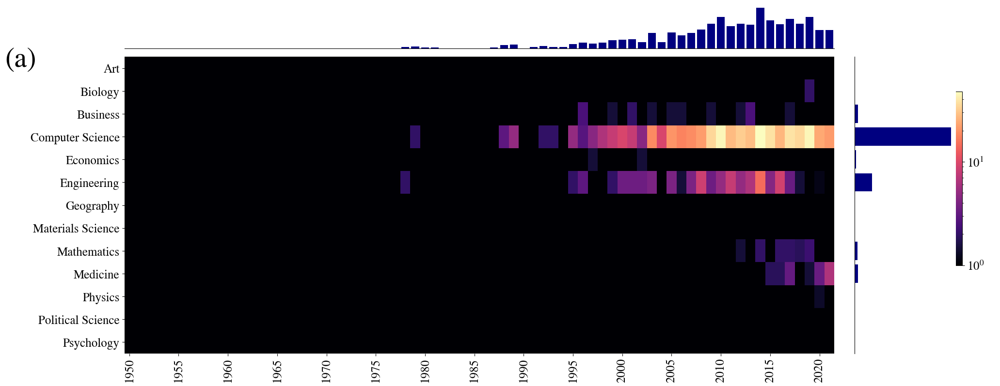

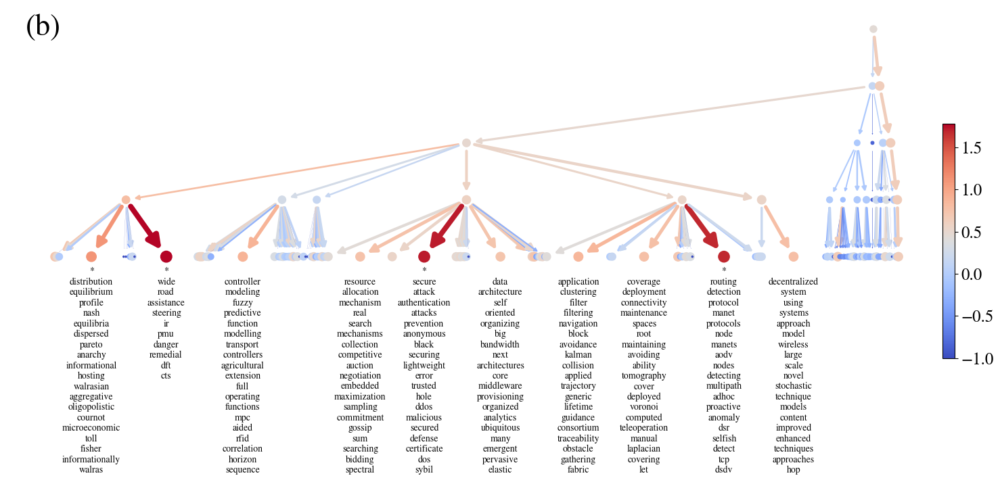







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 14



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['supply', 'chain', 'organizational', 'study', 'based', 'pricing', 'social', 'product', 'organization', 'inventory', 'innovation', 'case', 'decentralization', 'price', 'firm', 'level', 'production', 'strategic', 'business', 'market', 'public', 'risk', 'perspective', 'retailer', 'industry', 'echelon', 'corporate', 'organizations', 'competition', 'relationship', 'chains', 'procurement', 'logistics', 'green', 'governance', 'enterprise', 'manufacturing', 'carbon', 'firms', 'decisions', 'work', 'supplier', 'government', 'investment', 'international', 'marketing', 'company', 'community', 'manufacturer', 'capital'] 

---> TOPIC 59		normalized mixture proportion = 1.3144		mixture proportion = 0.0358
	224 WORDS - organizational - innovation - world - relationship - centric - corporate - emergence - adoption - technological - company - examination - interest - conference - organisational - multinational - managerial - style - employee - orientation - ex

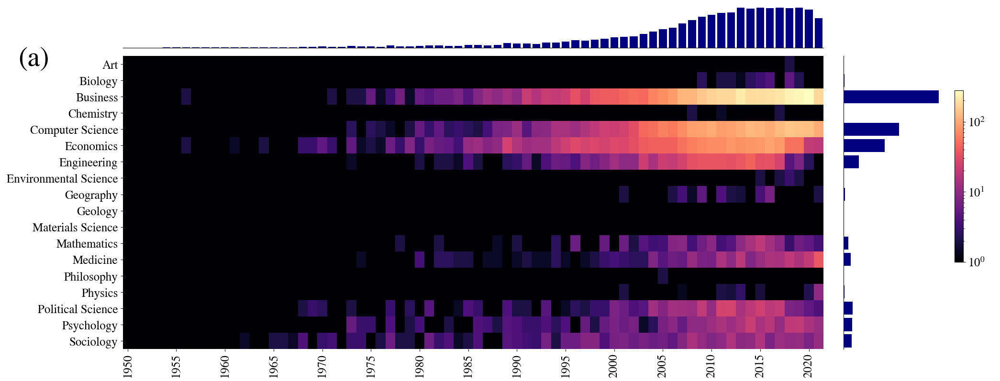

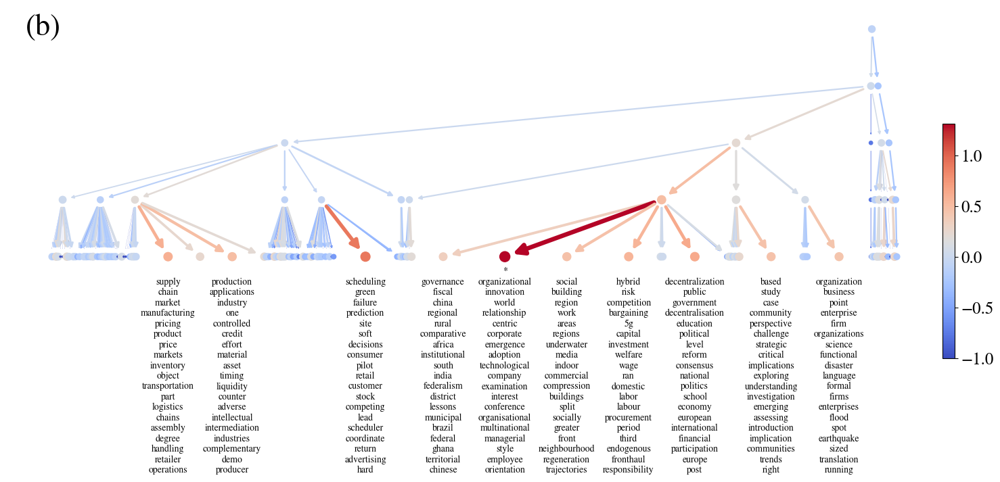

LEVEL 2 - CLUSTER 25



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['supply', 'chain', 'coordination', 'inventory', 'pricing', 'product', 'price', 'loop', 'closed', 'dual', 'strategy', 'echelon', 'retailer', 'planning', 'chains', 'competition', 'green', 'risk', 'coordinating', 'logistics', 'manufacturer', 'supplier', 'decisions', 'reverse', 'remanufacturing', 'retail', 'advertising', 'stage', 'consumer', 'disruption', 'manufacturing', 'market', 'cooperation', 'ordering', 'assembly', 'vendor', 'capacity', 'competing', 'quantity', 'investment', 'period', 'lead', 'customer', 'profit', 'replenishment', 'stock', 'averse', 'return', 'products', 'fresh'] 

---> TOPIC 82		normalized mixture proportion = 2.5294		mixture proportion = 0.0270
	86 WORDS - scheduling - green - failure - prediction - site - soft - decisions - consumer - pilot - retail - customer - stock - competing - lead - scheduler - coordinate - return - advertising - hard - minimizing 

---> TOPIC 103		normalized mixture proportion = 2.1140		mixture pro

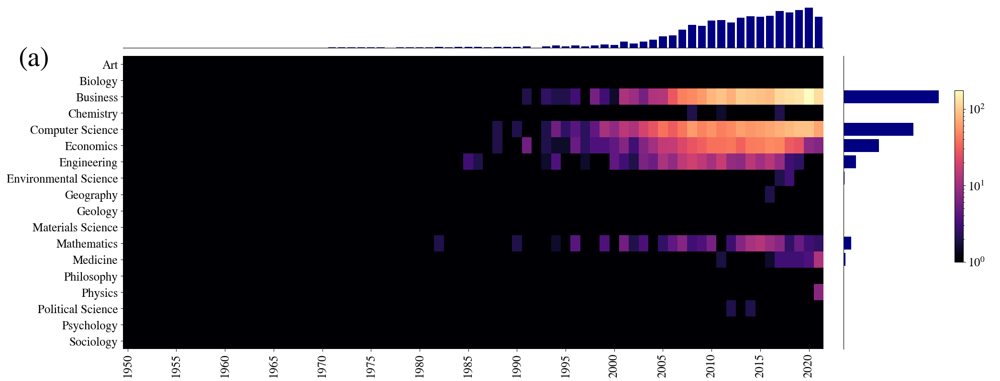

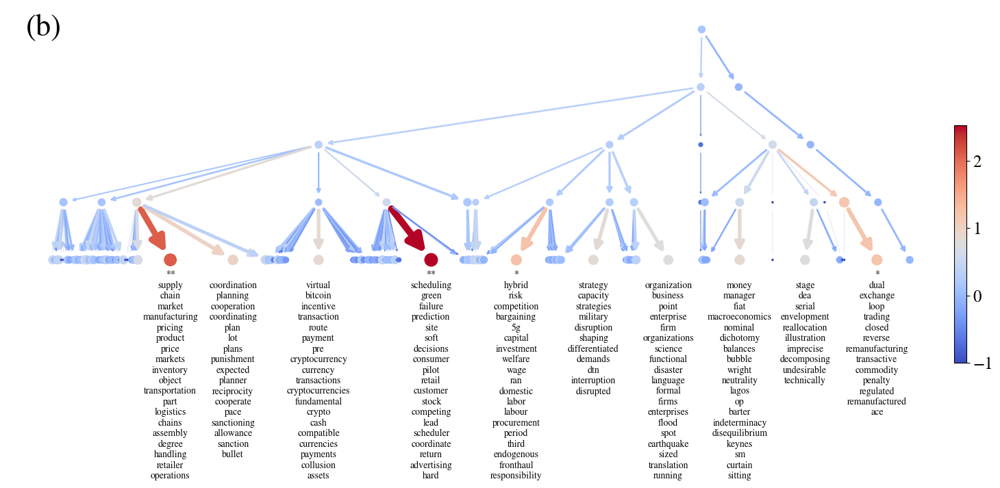

LEVEL 2 - CLUSTER 5



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['organizational', 'study', 'organization', 'social', 'innovation', 'case', 'firm', 'decentralization', 'based', 'public', 'business', 'strategic', 'organizations', 'perspective', 'industry', 'corporate', 'relationship', 'governance', 'firms', 'procurement', 'international', 'work', 'enterprise', 'accounting', 'community', 'multinational', 'company', 'capital', 'managerial', 'china', 'organisational', 'financial', 'risk', 'government', 'level', 'marketing', 'employee', 'investment', 'health', 'production', 'adoption', 'contingency', 'purchasing', 'banking', 'university', 'comparative', 'subsidiary', 'exploring', 'technological', 'investigation'] 

---> TOPIC 59		normalized mixture proportion = 1.7875		mixture proportion = 0.0410
	224 WORDS - organizational - innovation - world - relationship - centric - corporate - emergence - adoption - technological - company - examination - interest - conference - organisational - multinational - managerial

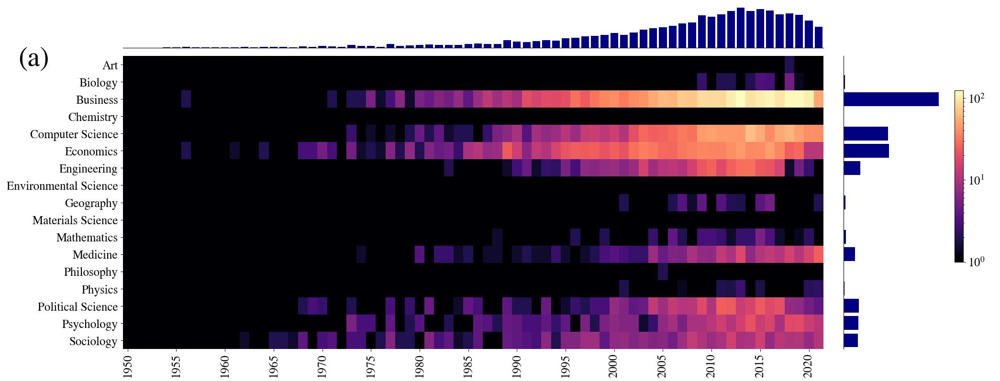

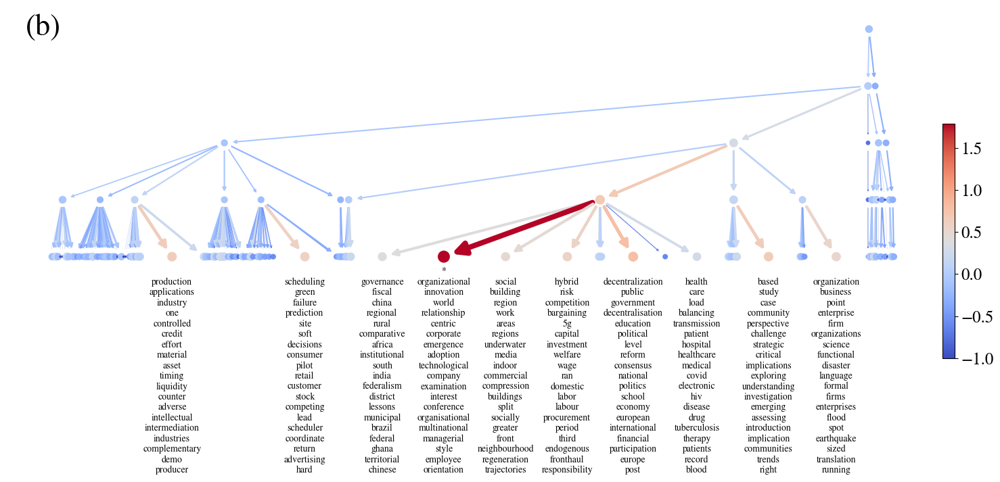







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 15



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['conditional', 'likelihood', 'screening', 'marginal', 'empirical', 'sure', 'nonparametric', 'model', 'independence', 'feature'] 

---> TOPIC 97		normalized mixture proportion = 12.9720		mixture proportion = 0.0909
	86 WORDS - evolution - autonomy - motion - sequential - intersection - observation - evolving - hypothesis - funding - driving - crowdsourcing - crowd - nonholonomic - flocking - merging - ratio - observations - highway - crowdsensing - intersections 

---> TOPIC 34		normalized mixture proportion = 10.5538		mixture proportion = 0.0909
	70 WORDS - robot - federated - reinforcement - location - cross - complex - neural - center - single - signal - robotic - robots - end - resilience - centers - array - call - vulnerability - multirobot - proximity 

---> TOPIC 53		normalized mixture proportion = 10.1258		mixture proportion = 0.0909
	49 WORDS - decentralized - system - using - systems - approach - model - wireless - large - scale - no

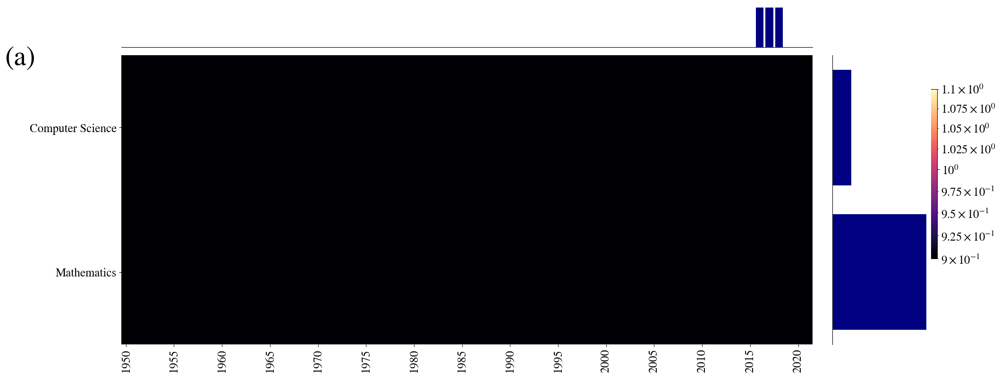

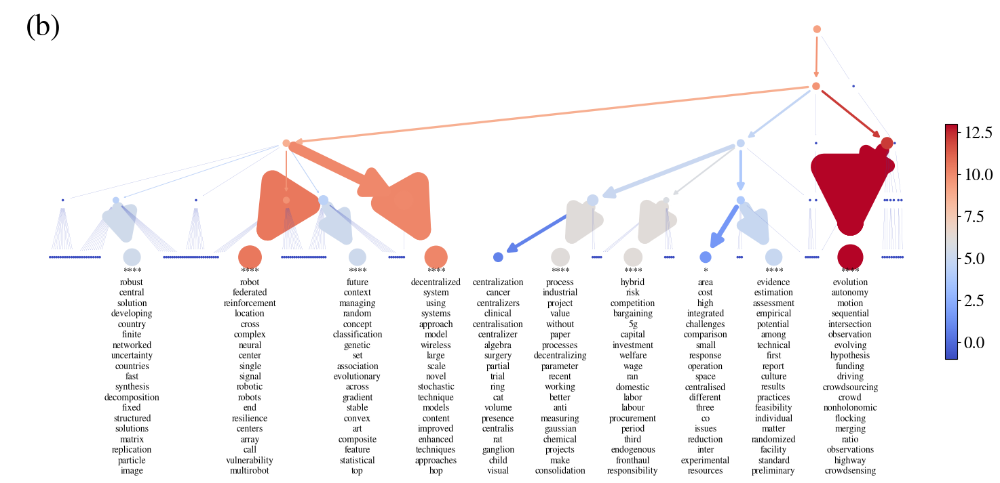

LEVEL 2 - CLUSTER 35



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['conditional', 'likelihood', 'screening', 'marginal', 'empirical', 'sure', 'nonparametric', 'model', 'independence', 'feature'] 

---> TOPIC 97		normalized mixture proportion = 12.9726		mixture proportion = 0.0909
	86 WORDS - evolution - autonomy - motion - sequential - intersection - observation - evolving - hypothesis - funding - driving - crowdsourcing - crowd - nonholonomic - flocking - merging - ratio - observations - highway - crowdsensing - intersections 

---> TOPIC 34		normalized mixture proportion = 9.7469		mixture proportion = 0.0909
	70 WORDS - robot - federated - reinforcement - location - cross - complex - neural - center - single - signal - robotic - robots - end - resilience - centers - array - call - vulnerability - multirobot - proximity 

---> TOPIC 53		normalized mixture proportion = 7.9080		mixture proportion = 0.0909
	49 WORDS - decentralized - system - using - systems - approach - model - wireless - large - scale - nove

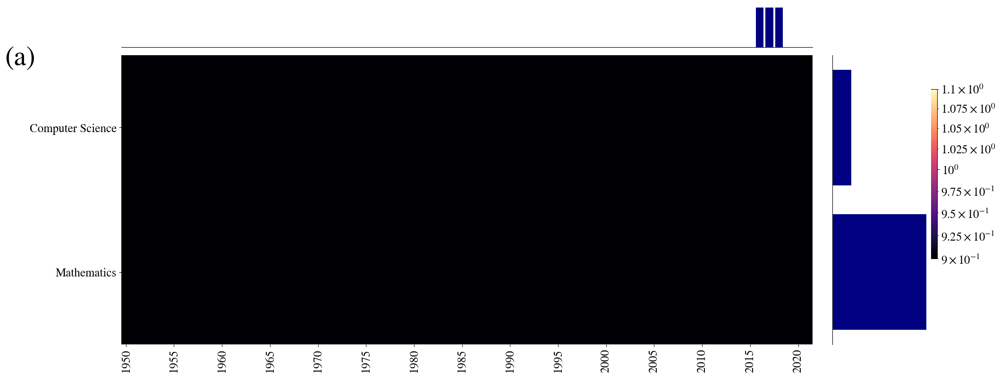

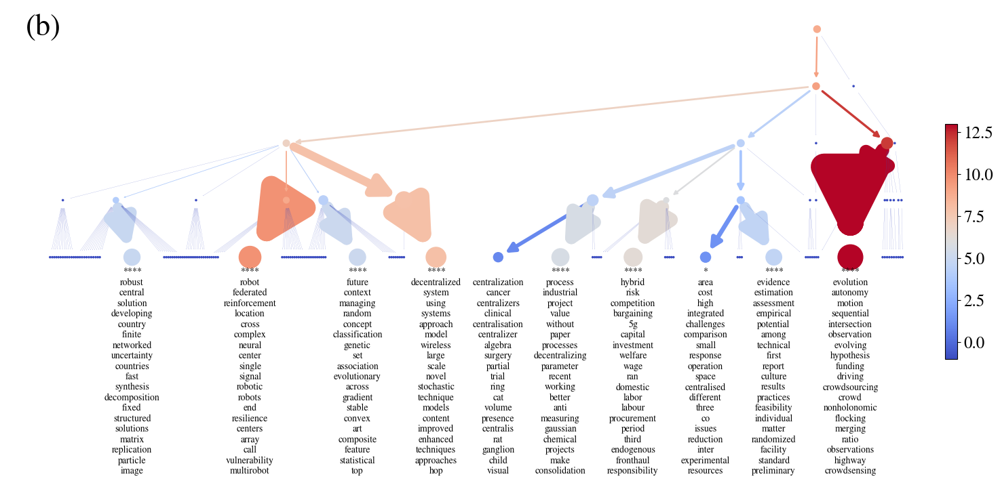







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 16



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['command', 'decentralized', 'mission', 'army', 'warfare', 'system', 'airpower', 'military', 'model', 'c2', 'organization', 'combat', 'systems', 'doctrine', 'auftragstaktik', 'using', 'team', 'approach', 'initiative', 'tenet', 'organizations', 'commander', 'expeditionary', 'need', 'orders', 'intent', 'corps', 'impact', 'design', 'chaos', 'intelligence', 'battle', 'weapon', 'strategy', 'enterprise', 'practice', 'battlefield', 'program', 'science', 'crisis', 'agility', 'navy', 'capacity', 'enhanced', 'tasking', 'autonomous', 'time', 'improved', 'fire', 'coordinated'] 

---> TOPIC 107		normalized mixture proportion = 9.7893		mixture proportion = 0.0397
	50 WORDS - throughput - opportunistic - mission - command - player - armed - massively - bandit - bandits - jamming - combat - multiplayer - warfare - chaos - handoff - gaming - army - regret - intent - doctrine 

---> TOPIC 105		normalized mixture proportion = 2.6896		mixture proportion = 0.0123


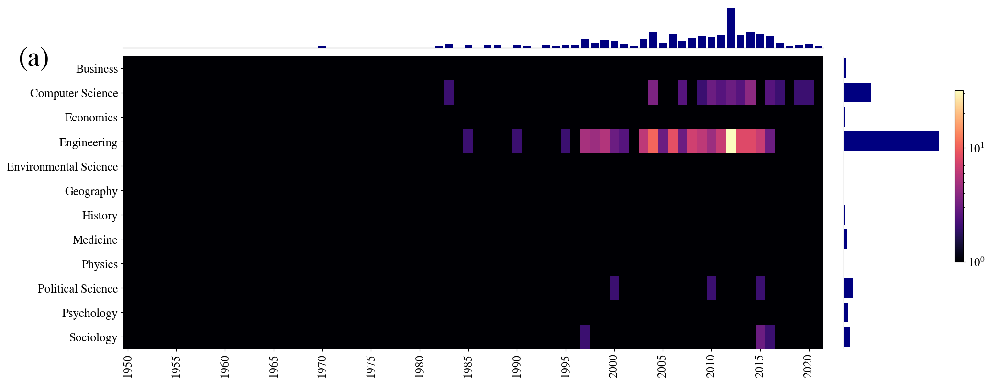

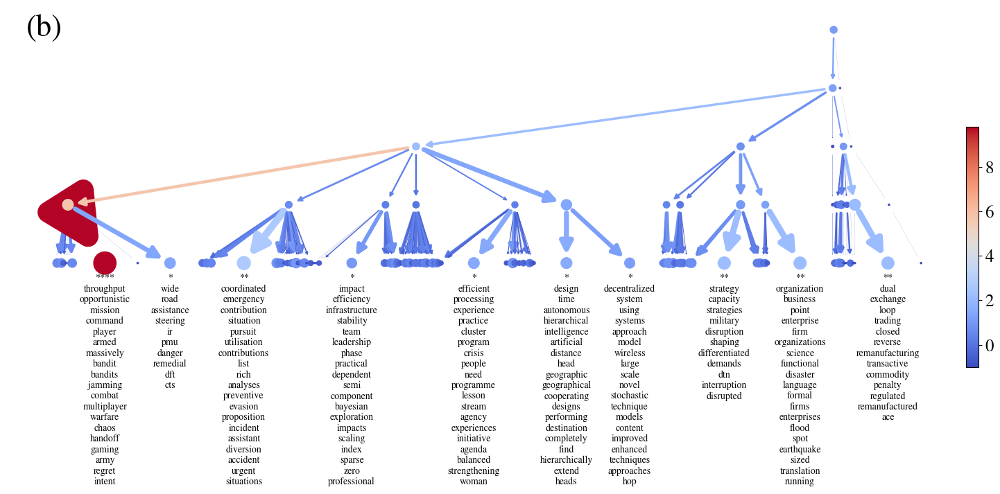

LEVEL 2 - CLUSTER 34



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['command', 'mission', 'army', 'warfare', 'airpower', 'military', 'c2', 'organization', 'combat', 'doctrine', 'auftragstaktik', 'team', 'initiative', 'tenet', 'organizations', 'commander', 'expeditionary', 'need', 'orders', 'unmanned', 'intent', 'corps', 'impact', 'design', 'chaos', 'intelligence', 'battle', 'weapon', 'strategy', 'enterprise', 'practice', 'battlefield', 'reconnaissance', 'program', 'science', 'mars', 'crisis', 'access', 'agility', 'navy', 'capacity', 'tasking', 'division', 'autonomous', 'time', 'fire', 'coordinated', 'efficiency', 'engineers', 'penalty'] 

---> TOPIC 107		normalized mixture proportion = 10.6566		mixture proportion = 0.0397
	50 WORDS - throughput - opportunistic - mission - command - player - armed - massively - bandit - bandits - jamming - combat - multiplayer - warfare - chaos - handoff - gaming - army - regret - intent - doctrine 

---> TOPIC 105		normalized mixture proportion = 2.5684		mixture proportion = 

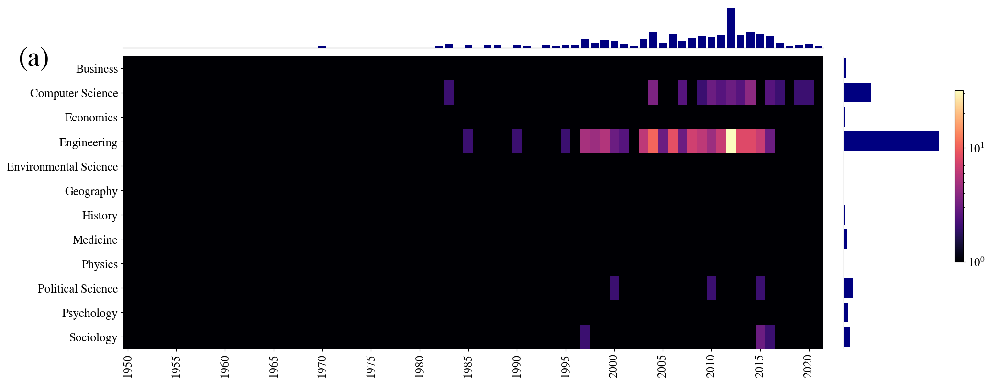

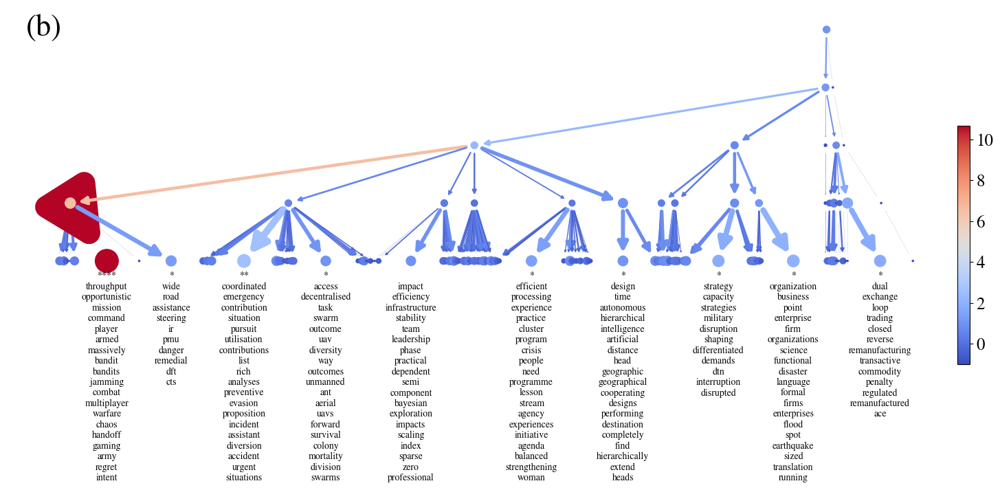







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 17



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['fractal', 'information', 'controller', 'activation', 'based', 'local', 'neural', 'processing', 'parallel'] 

---> TOPIC 39		normalized mixture proportion = 81.8683		mixture proportion = 0.0909
	31 WORDS - local - contract - decentralizacja - decentralizacji - publicznych - polsce - jako - finansów - samorządu - terytorialnego - clearance - po - czy - publicznej - centralizacja - analiza - za - problemy - administracji - przykładzie 

---> TOPIC 72		normalized mixture proportion = 24.4754		mixture proportion = 0.0909
	32 WORDS - parallel - corruption - benefit - back - synchronous - positive - driver - automotive - plus - negative - phenomenon - shadow - quantifying - slow - situ - repeated - validity - significant - disability - surplus 

---> TOPIC 71		normalized mixture proportion = 11.9203		mixture proportion = 0.0909
	152 WORDS - information - water - wastewater - gas - utility - reuse - biomass - sanitation - drinking - oil - acquisitio

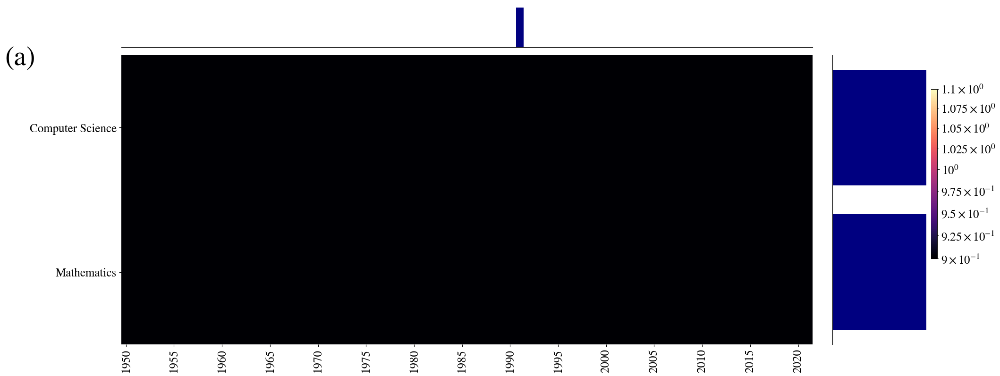

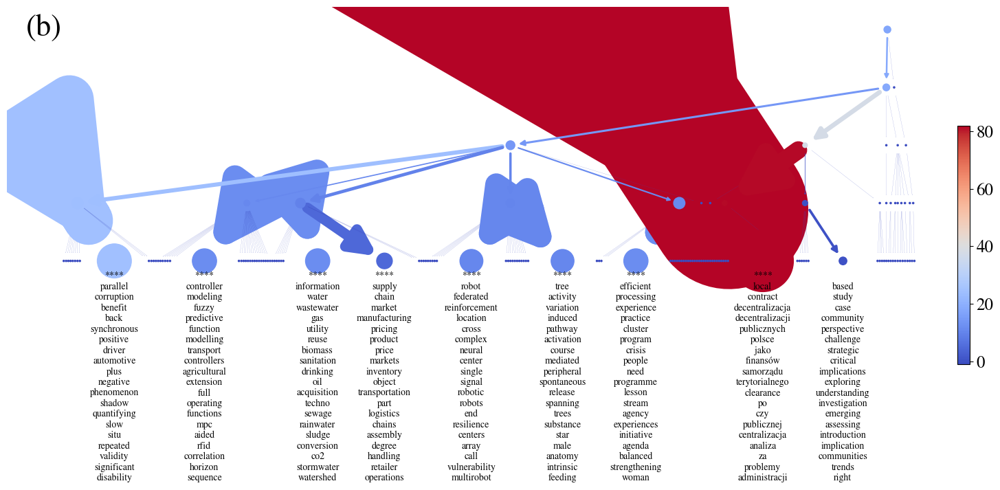

LEVEL 2 - CLUSTER 36



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['fractal', 'information', 'controller', 'activation', 'based', 'local', 'neural', 'processing', 'parallel'] 

---> TOPIC 39		normalized mixture proportion = 82.4741		mixture proportion = 0.0909
	31 WORDS - local - contract - decentralizacja - decentralizacji - publicznych - polsce - jako - finansów - samorządu - terytorialnego - clearance - po - czy - publicznej - centralizacja - analiza - za - problemy - administracji - przykładzie 

---> TOPIC 72		normalized mixture proportion = 22.4455		mixture proportion = 0.0909
	32 WORDS - parallel - corruption - benefit - back - synchronous - positive - driver - automotive - plus - negative - phenomenon - shadow - quantifying - slow - situ - repeated - validity - significant - disability - surplus 

---> TOPIC 71		normalized mixture proportion = 12.8924		mixture proportion = 0.0909
	152 WORDS - information - water - wastewater - gas - utility - reuse - biomass - sanitation - drinking - oil - acquisitio

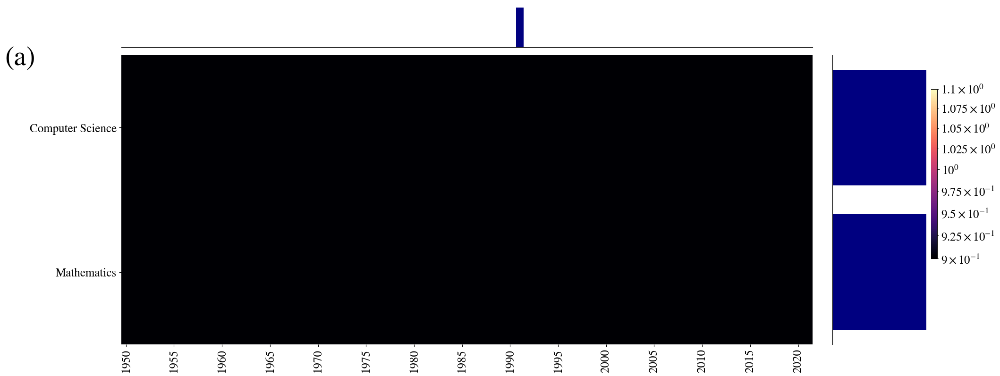

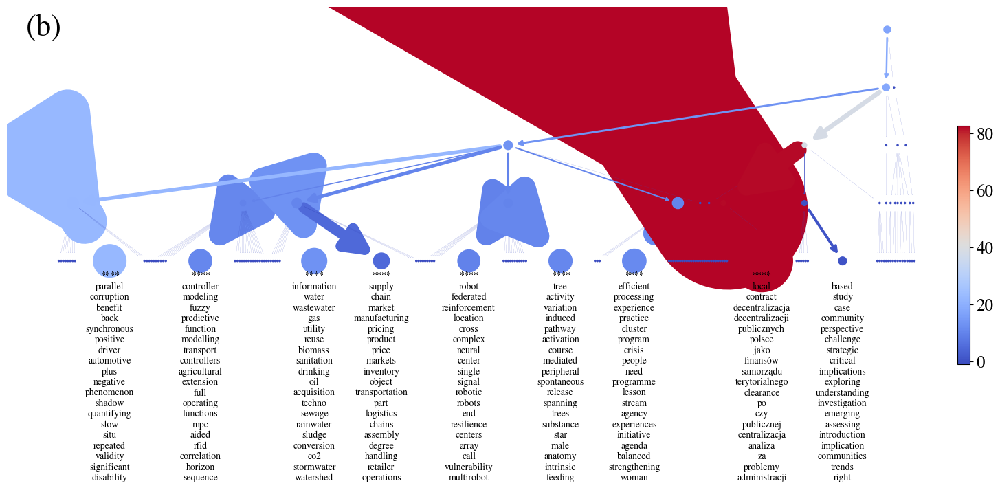







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 18



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['grid', 'voltage', 'smart', 'microgrids', 'dc', 'microgrid', 'electric', 'centralized', 'frequency', 'agent', 'charging', 'storage', 'islanded', 'wind', 'algorithm', 'ac', 'pv', 'networks', 'dispatch', 'analysis', 'grids', 'converter', 'scheme', 'protection', 'battery', 'inverter', 'reactive', 'droop', 'photovoltaic', 'considering', 'renewable', 'micro', 'plug', 'residential', 'electricity', 'secondary', 'side', 'electrical', 'restoration', 'generator', 'mode', 'plant', 'farm', 'penetration', 'source', 'inverters', 'solar', 'loads', 'turbine', 'flexible'] 

---> TOPIC 29		normalized mixture proportion = 1.9081		mixture proportion = 0.0842
	477 WORDS - centralized - survey - sector - voltage - microgrids - frequency - electricity - electric - microgrid - renewable - dc - plant - wind - link - testing - micro - solar - charging - residential - test 

---> TOPIC 73		normalized mixture proportion = 1.6875		mixture proportion = 0.0051
	19 WORDS - 

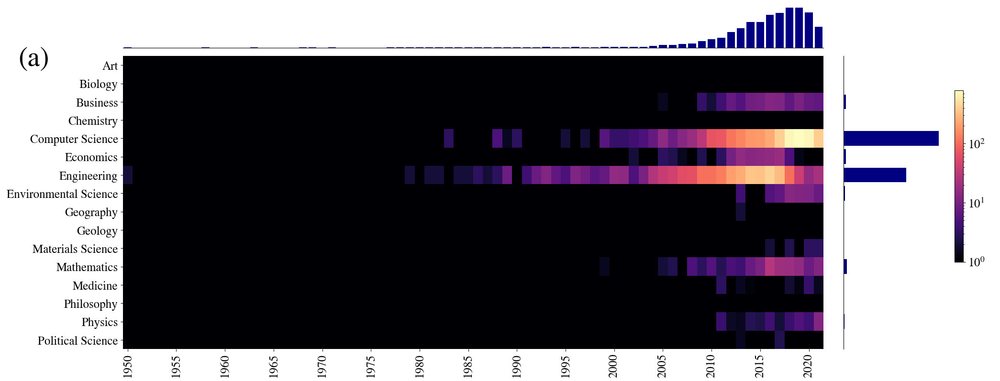

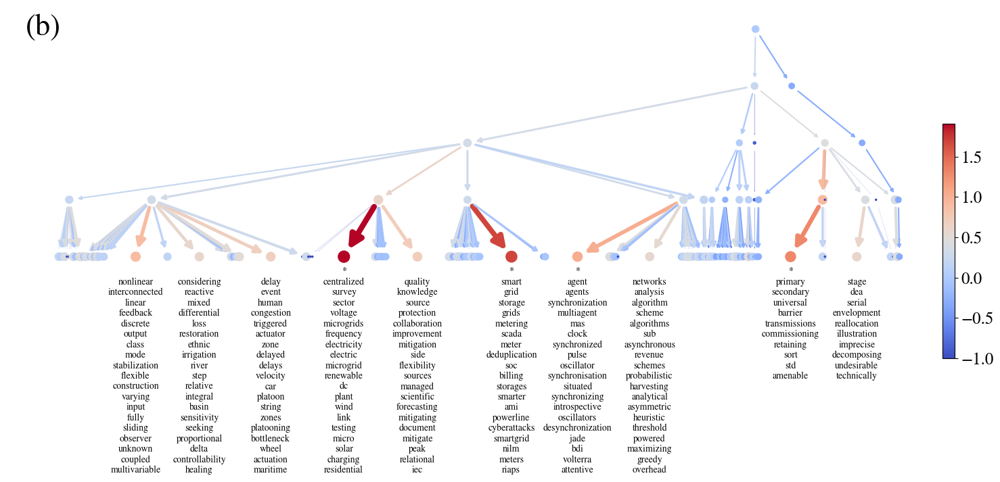

LEVEL 2 - CLUSTER 38



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['grid', 'voltage', 'smart', 'microgrids', 'dc', 'microgrid', 'electric', 'centralized', 'frequency', 'agent', 'charging', 'storage', 'islanded', 'wind', 'ac', 'pv', 'active', 'dispatch', 'grids', 'converter', 'regulation', 'protection', 'battery', 'inverter', 'droop', 'photovoltaic', 'renewable', 'micro', 'plug', 'residential', 'electricity', 'secondary', 'side', 'electrical', 'generator', 'mode', 'plant', 'farm', 'penetration', 'source', 'inverters', 'solar', 'loads', 'turbine', 'flexible', 'primary', 'interconnected', 'flexibility', 'ev', 'converters'] 

---> TOPIC 29		normalized mixture proportion = 2.1474		mixture proportion = 0.0842
	477 WORDS - centralized - survey - sector - voltage - microgrids - frequency - electricity - electric - microgrid - renewable - dc - plant - wind - link - testing - micro - solar - charging - residential - test 

---> TOPIC 73		normalized mixture proportion = 1.6031		mixture proportion = 0.0051
	19 WORDS - s

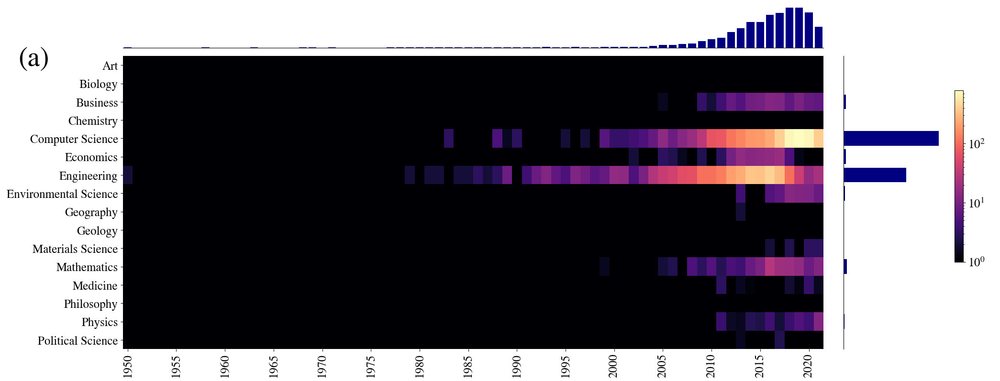

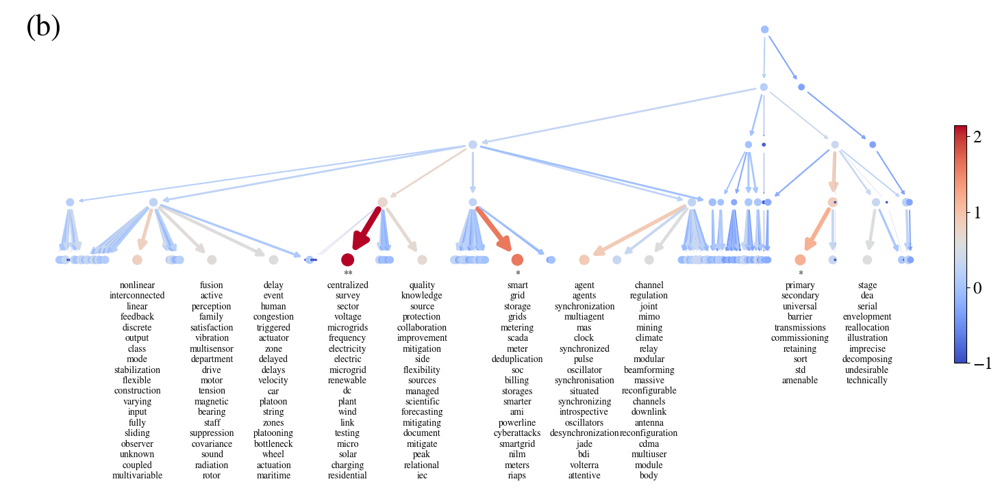







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 19



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['conference', 'proceedings', 'science', 'journal', 'computer', 'workshop', 'september', 'revised', 'proceeding', 'august', 'symposium', 'february', 'december', 'november', 'june', 'july', 'control', 'grid', 'workshops', 'october', '5th', 'advances', 'march', 'agent', 'france', 'artificial', '7th', 'autonomous', '11th', 'agents', 'methods', '6th', 'design', 'acm', 'annual', 'smart', '8th', '16th', 'intelligence', 'formal', 'issn', 'amsterdam', 'seoul', 'held', 'vienna', '2nd', 'th', '10th', 'birmingham', 'learning'] 

---> TOPIC 59		normalized mixture proportion = 6.0693		mixture proportion = 0.1094
	224 WORDS - organizational - innovation - world - relationship - centric - corporate - emergence - adoption - technological - company - examination - interest - conference - organisational - multinational - managerial - style - employee - orientation - exploratory 

---> TOPIC 28		normalized mixture proportion = 3.9787		mixture proportion = 0.0176

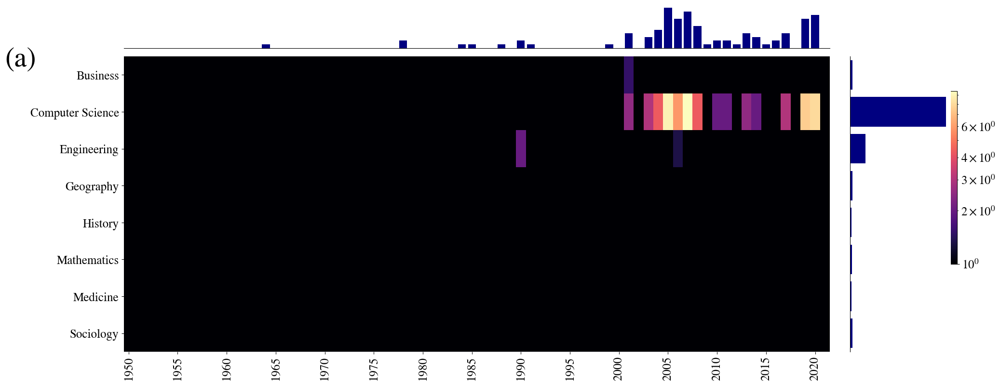

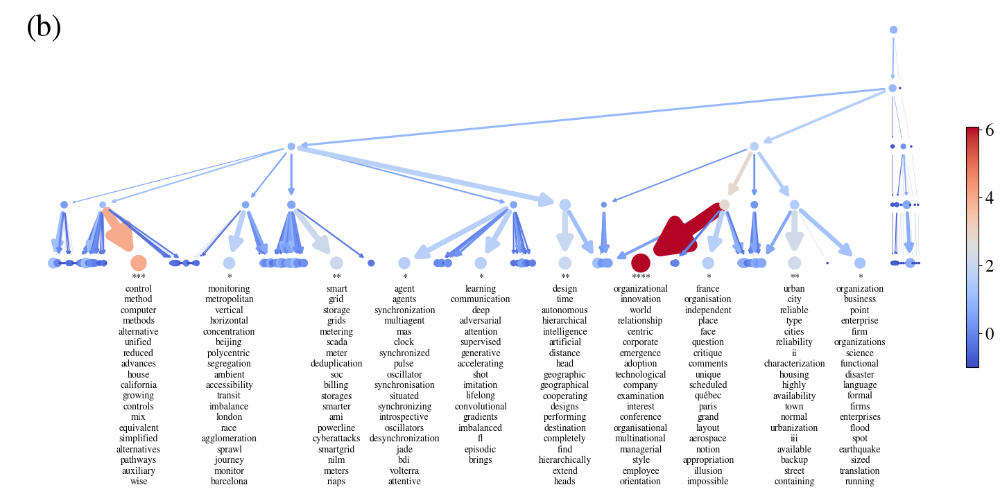

LEVEL 2 - CLUSTER 39



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['conference', 'proceedings', 'science', 'journal', 'computer', 'workshop', 'september', 'revised', 'proceeding', 'august', 'symposium', 'february', 'december', 'november', 'june', 'july', 'control', 'grid', 'workshops', 'october', '5th', 'advances', 'march', 'agent', 'france', 'artificial', '7th', 'autonomous', '11th', 'agents', 'methods', '6th', 'design', 'acm', 'annual', 'smart', '8th', '16th', 'intelligence', 'formal', 'issn', 'amsterdam', 'seoul', 'held', 'vienna', '2nd', 'th', '10th', 'birmingham', 'learning'] 

---> TOPIC 59		normalized mixture proportion = 6.4440		mixture proportion = 0.1094
	224 WORDS - organizational - innovation - world - relationship - centric - corporate - emergence - adoption - technological - company - examination - interest - conference - organisational - multinational - managerial - style - employee - orientation - exploratory 

---> TOPIC 28		normalized mixture proportion = 3.1423		mixture proportion = 0.0176

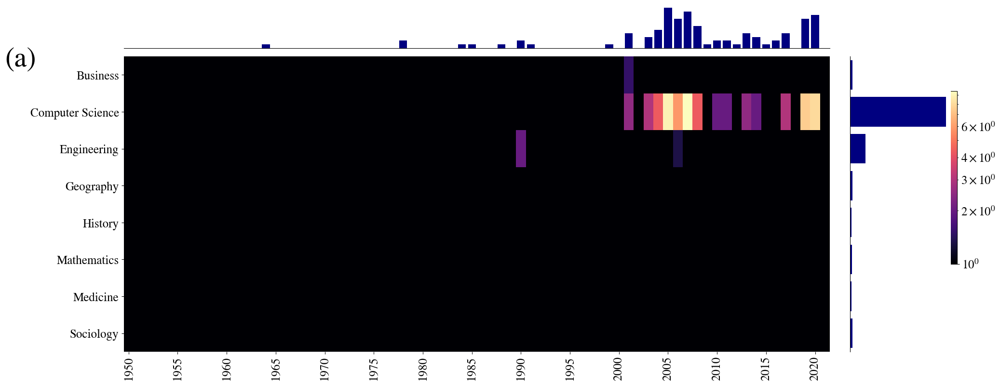

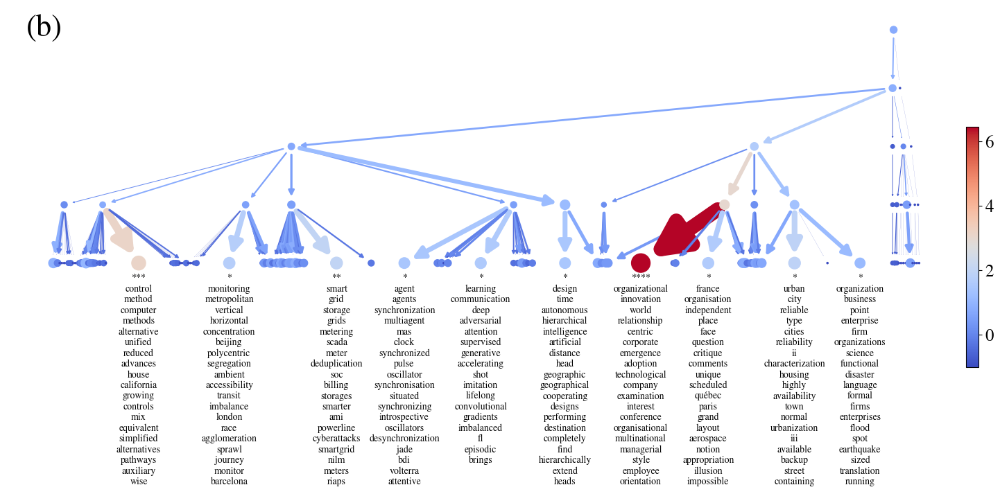







---------------------------------------------------------------------------






LEVEL 3 - CLUSTER 20



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['problem', 'agent', 'transportation', 'logistics', 'design', 'time', 'delivery', 'pickup', 'container', 'planning', 'freight', 'mechanism', 'windows', 'intermodal', 'allocation', 'solving', 'truckload', 'profit', 'real', 'passenger', 'operations', 'auction', 'taxi', 'delegate', 'negotiation', 'supply', 'pricing', 'strategy', 'agents', 'truck', 'multiagent', 'decision', 'mas', 'inventory', 'problems', 'exchange', 'resource', 'logistic', 'multicommodity', 'carriers', 'allocating', 'transshipment', 'learning', 'hierarchical', 'search', 'strategies', 'chain', 'solve', 'shipping', 'deep'] 

---> TOPIC 68		normalized mixture proportion = 4.0476		mixture proportion = 0.0085
	11 WORDS - strategy - capacity - strategies - military - disruption - shaping - differentiated - demands - dtn - interruption - disrupted 

---> TOPIC 55		normalized mixture proportion = 3.7767		mixture proportion = 0.0107
	19 WORDS - agent - agents - synchronization - multiagen

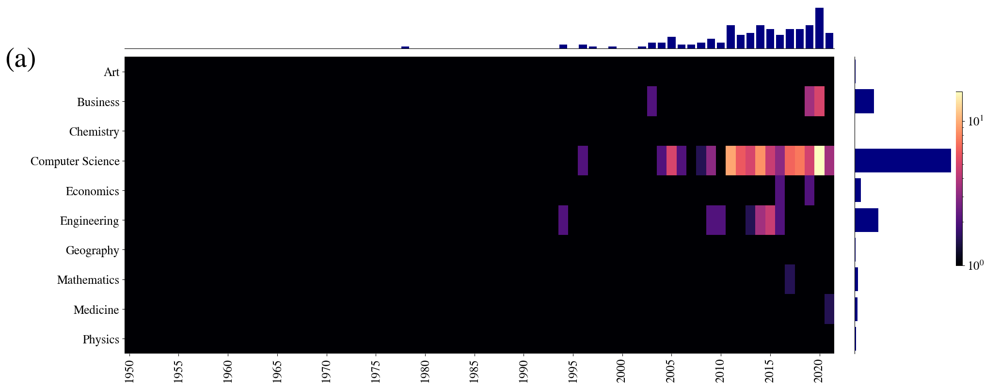

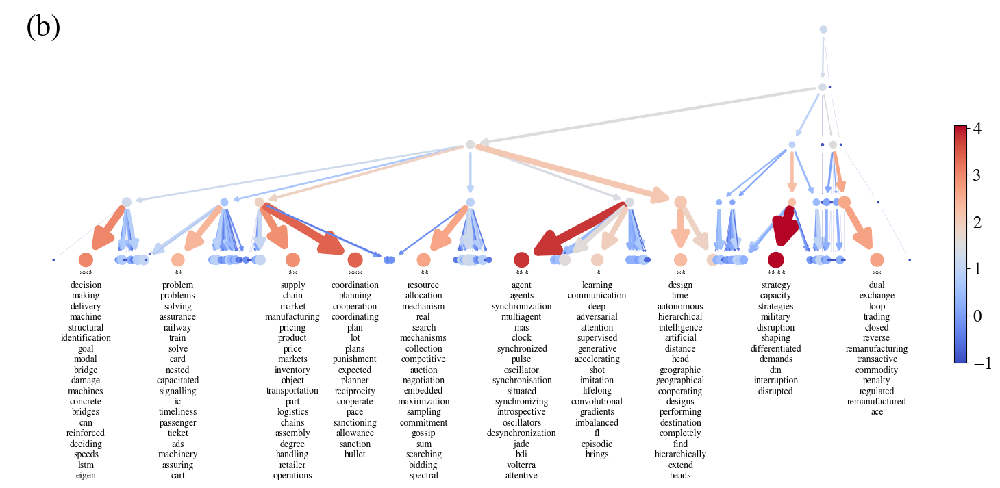

LEVEL 2 - CLUSTER 40



/tmp/2197422.1.all.q/ipykernel_19081/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['problem', 'agent', 'transportation', 'logistics', 'design', 'time', 'delivery', 'pickup', 'container', 'planning', 'freight', 'mechanism', 'windows', 'intermodal', 'allocation', 'solving', 'truckload', 'profit', 'real', 'passenger', 'operations', 'auction', 'taxi', 'delegate', 'negotiation', 'supply', 'pricing', 'strategy', 'agents', 'truck', 'multiagent', 'decision', 'mas', 'inventory', 'problems', 'exchange', 'resource', 'logistic', 'multicommodity', 'carriers', 'allocating', 'transshipment', 'learning', 'hierarchical', 'search', 'strategies', 'chain', 'solve', 'shipping', 'deep'] 

---> TOPIC 55		normalized mixture proportion = 3.4883		mixture proportion = 0.0107
	19 WORDS - agent - agents - synchronization - multiagent - mas - clock - synchronized - pulse - oscillator - synchronisation - situated - synchronizing - introspective - oscillators - desynchronization - jade - bdi - volterra - attentive 

---> TOPIC 68		normalized mixture propo

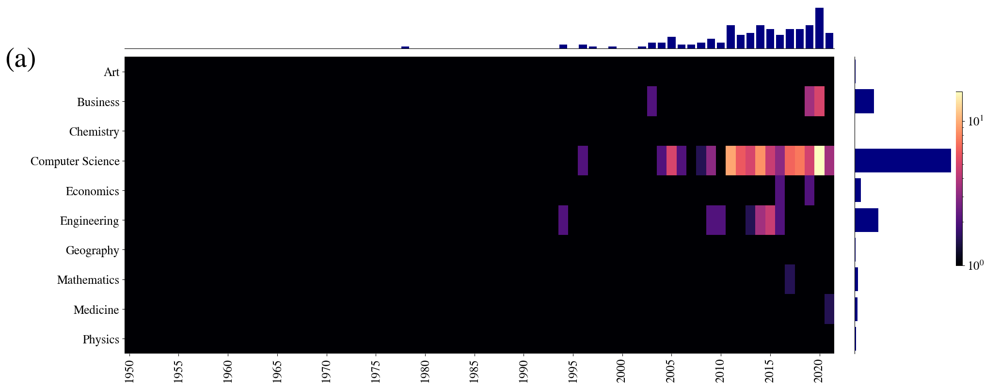

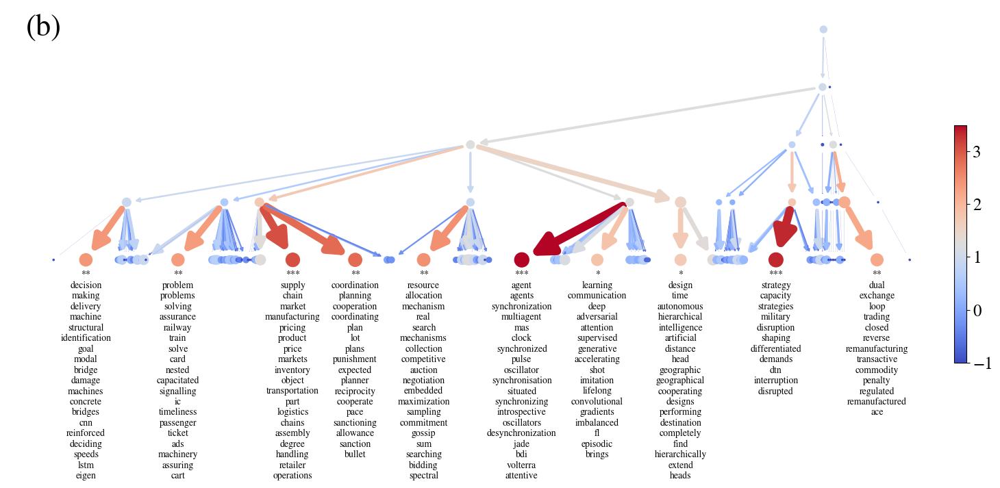

In [42]:
lev=3
centralities_to_print = ['citations_overall','in_degree','eigenvector','betweenness','closeness','pagerank','katz']
clusters = np.unique(list(name2partition_by_level[lev].values()))
# partition = 2
for cluster in clusters:
    print("\n\n\n\n\n\n---------------------------------------------------------------------------\n\n\n\n\n\n")
    x = analyse_cluster(lev = lev, top_level_topics=6, bottom_level_topics = 2, cluster=cluster, threshold=0.2,  time_window=10, centralities_to_print=centralities_to_print, 
                 max_num_topics_to_represent = 10, num_most_frequent_words = 50, num_papers_to_show = 1, do_sample_knowledge_flow = True,
                 multiplicator_size_nodes=50, multiplicator_size_edges=0.04, multiplicator_ypos=0.25, fontsize_graph=10,
                    colorbar_log_heatmap=True)
    for child in hierarchy_docs[lev][cluster]:
        x = analyse_cluster(lev = lev-1, top_level_topics=6, bottom_level_topics = 2, cluster=child, threshold=0.2,  time_window=10, centralities_to_print=centralities_to_print, 
                 max_num_topics_to_represent = 10, num_most_frequent_words = 50, num_papers_to_show = 1, do_sample_knowledge_flow = True,
                 multiplicator_size_nodes=50, multiplicator_size_edges=0.04, multiplicator_ypos=0.25, fontsize_graph=10,
                                    colorbar_log_heatmap=True, )


### Keyword annotation

In [59]:
def get_first_keyword(string):
    # String is like this: "blockchain\ntechnology\ncomputing\nIOT\nsecurity"
    # Return blockchain and the rest of the words
    return string.split("\n")[0], "\n".join(string.split("\n")[1:])

def get_keywords_hierachy(keywords_clusters,lev,cluster,hierarchy_clusters,no_words=-1, bottom_level = 2,call_number = 1,threshold_num_papers = 100):
    if call_number == 1:
        for level in list(keywords_clusters.keys()):
            if level > bottom_level:
                del keywords_clusters[level]
    children = hierarchy_clusters[lev][cluster].copy()
    for child in children:
        if lev-1 > bottom_level and ((lev-1 not in keywords_clusters) or (child not in keywords_clusters[lev-1])):
            keywords_clusters = get_keywords_hierachy(keywords_clusters,lev-1,child,hierarchy_clusters,no_words=no_words, call_number=call_number+1,threshold_num_papers=threshold_num_papers)
    tmp = {child:keywords_clusters[lev-1][child] if lev-1 in keywords_clusters and child in keywords_clusters[lev-1] else "" for child in children}
    chosen_keywords = []
    if no_words == -1:
        no_words = 10000000
    while len(chosen_keywords) < no_words and len([len(string) for string in tmp.values()]) > 0 and np.max([len(string) for string in tmp.values()]) > 0:
        for child,string in tmp.items():
            first_keyword,tmp[child] = get_first_keyword(string)
            if len(first_keyword) != 0 and first_keyword not in chosen_keywords:
                chosen_keywords.append(first_keyword)
            if len(chosen_keywords) >= no_words:
                break
    if lev not in keywords_clusters:
        keywords_clusters[lev] = {}
    keywords_clusters[int(lev)][int(cluster)] = "\n".join(chosen_keywords)
    return keywords_clusters

In [60]:
# For each level (2 and 3) we identify the most important words that identify the cluster
keywords_clusters = {int(2):{x:"" for x in hierarchy_docs[2].keys()}}

In [86]:
def annotated_keyword_clusters(threshold_num_papers,use_only_first_keyword = False):
    # For each level (2 and 3) we identify the most important words that identify the cluster
    keywords_clusters = {int(2):{x:"" for x in hierarchy_docs[2].keys()}}
    
    # Lev 3 Cluster 0
    keywords_clusters[2][32] = "game theory\nnash equilibrium" # 121 papers
    keywords_clusters[2][18] = "routing\nallocation\ncongestion" # 909 papers
    keywords_clusters[2][26] = "robot swarms\nsupply chain" # 4120 papers
    keywords_clusters[2][20] = "planning\ngame theory" # 693 papers
    # Lev 3 Cluster 1
    keywords_clusters[2][0] = "control theory\nnonlinear dynamics" # 8634 papers
    keywords_clusters[2][27] = "navigation\nflocking\nformation" # 9661 papers
    keywords_clusters[2][28] = "discrete-event systems\ndecision making" # 1463 papers
    # Lev 3 Cluster 2
    keywords_clusters[2][1] = "governance\nfiscal federalism\ngovernment\ndevelopment" # 19371 papers
    keywords_clusters[2][2] = "natural resources\neducation\ngovernance" # 20674 papers
    # Lev 3 Cluster 3
    keywords_clusters[2][24] = "cybersecurity\npeer2peer\nfault tolearance\nattacks" # 15189 papers
    keywords_clusters[2][3] = "cloud\nsecurity" # 3248 papers
    # Lev 3 Cluster 4        
    keywords_clusters[2][4] = "routing" # 1278 papers
    keywords_clusters[2][6] = "renewable energy\nwastewater\nenvironment" # 8348 papers
    keywords_clusters[2][31] = "portoguese\nlatin america" # 5760 papers
    # Lev 3 Cluster 5
    keywords_clusters[2][7] = "smart grids\nenergy trading\nblockchain" # 867 papers
    # Lev 3 Cluster 6
    keywords_clusters[2][8] = "blockchain\ncryptocurrency\nethereum\nbitcoin" # 9634 papers
    keywords_clusters[2][9] = "" # ONLY 3 papers
    # Lev 3 Cluster 7
    keywords_clusters[2][10] = "algebra\nhealthcare\nsymptoms" # 6291 papers
    keywords_clusters[2][29] = "hospitals\nHIV\ncancer\nsurgery" # 6052 papers
    # Lev 3 Cluster 8
    keywords_clusters[2][11] = "control theory\nequilibrium" # 926 papers
    keywords_clusters[2][12] = "statistical learning\noptimization\ndetection" # 3065 papers
    keywords_clusters[2][13] = "heterogeneity\nlinks\nweb\nhealth" # 1887 papers
    # Lev 3 Cluster 9   
    keywords_clusters[2][14] = "networks\nconnectivity\nsyncronization\nrouting\ntopology" # 3058 papers
    keywords_clusters[2][15] = "investments\nmoney\nrisk\nalgorithm" # 8669 papers
    # Lev 3 Cluster 10
    keywords_clusters[2][16] = "cellular networks\ncommunication\nradio" # 12446 papers
    keywords_clusters[2][17] = "wireless\nlocalization" # 1262 papers
    keywords_clusters[2][37] = "routing\nprotocols\nsecurity" # 5096 papers
    # Lev 3 Cluster 11
    keywords_clusters[2][23] = "edge-computing\ncloud-computing" # 2970 papers
    # Lev 3 Cluster 12 
    keywords_clusters[2][33] = "" # ONLY 37 papers
    keywords_clusters[2][19] = "federated learning\ndeep learning\nadversarial networks" # 1565 papers
    keywords_clusters[2][21] = "french" # ONLY 441 papers
    # Lev 3 Cluster 13
    keywords_clusters[2][30] = "spanish" # 1251 papers
    keywords_clusters[2][22] = "wireless\ncybersecurity\nallocation\ndecision making" # 915 papers
    # Lev 3 Cluster 14  
    keywords_clusters[2][25] = "supply chain\nmanufacturing\npricing" # 3938 papers
    keywords_clusters[2][5] = "social network analysis\norganizations\nfirms" # 6437 papers
    # Lev 3 Cluster 15 
    keywords_clusters[2][35] = "" # ONLY 3 papers
    # Lev 3 Cluster 16
    keywords_clusters[2][34] = "industry\nfirm\norganization\nsupply chains" # 1251 papers
    # Lev 3 Cluster 17 
    keywords_clusters[2][36] = "" # ONLY 2 papers
    # Lev 3 Cluster 18
    keywords_clusters[2][38] = "electricity\ngrids" # 8090 papers
    # Lev 3 Cluster 19 
    keywords_clusters[2][39] = "conference proceedings" # ONLY 146 papers
    # Lev 3 Cluster 20 
    keywords_clusters[2][40] = "transportation" # ONLY 160 papers
    
    
    if use_only_first_keyword == True:
        # Keep only the first keyword
        original_keywords_clusters = copy.deepcopy(keywords_clusters)
        # Change manually some of the papers to get a better one keyword
        original_keywords_clusters[2][11] = "equilibrium"
        original_keywords_clusters[2][13] = "web&health"
        keywords_clusters = {int(2):{x:get_first_keyword(y)[0] for x,y in original_keywords_clusters[2].items()}}
        
    
    # Now put empty strings for each cluster with not enough papers (< threshold)
    keywords_clusters[2] = {int(x):y if len([t for t in name2partition_by_level[2].keys() if name2partition_by_level[2][t]==x]) >= threshold_num_papers else "" for x,y in keywords_clusters[2].items()}
    return keywords_clusters

In [87]:
threshold_num_papers = 0
keywords_clusters = annotated_keyword_clusters(threshold_num_papers, use_only_first_keyword=False)
keywords_clusters = get_keywords_hierachy(keywords_clusters, 6, 0, hierarchy_docs, no_words=20,threshold_num_papers = threshold_num_papers)

# DUMP KEYWORDS
with open(os.path.join(results_folder,'keywords.json'), 'w') as json_file:
    json.dump(keywords_clusters, json_file)
keywords_clusters

{2: {0: 'control theory\nnonlinear dynamics',
  1: 'governance\nfiscal federalism\ngovernment\ndevelopment',
  2: 'natural resources\neducation\ngovernance',
  3: 'cloud\nsecurity',
  4: 'routing',
  5: 'social network analysis\norganizations\nfirms',
  6: 'renewable energy\nwastewater\nenvironment',
  7: 'smart grids\nenergy trading\nblockchain',
  8: 'blockchain\ncryptocurrency\nethereum\nbitcoin',
  9: '',
  10: 'algebra\nhealthcare\nsymptoms',
  11: 'control theory\nequilibrium',
  12: 'statistical learning\noptimization\ndetection',
  13: 'heterogeneity\nlinks\nweb\nhealth',
  14: 'networks\nconnectivity\nsyncronization\nrouting\ntopology',
  15: 'investments\nmoney\nrisk\nalgorithm',
  16: 'cellular networks\ncommunication\nradio',
  17: 'wireless\nlocalization',
  18: 'routing\nallocation\ncongestion',
  19: 'federated learning\ndeep learning\nadversarial networks',
  20: 'planning\ngame theory',
  21: 'french',
  22: 'wireless\ncybersecurity\nallocation\ndecision making',
  23:

In [88]:
threshold_num_papers = 0
keywords_clusters_onekeyword = annotated_keyword_clusters(threshold_num_papers,use_only_first_keyword=True)
keywords_clusters_onekeyword = get_keywords_hierachy(keywords_clusters_onekeyword, 6, 0, hierarchy_docs, no_words=20,threshold_num_papers = threshold_num_papers)

# DUMP KEYWORDS
with open(os.path.join(results_folder,'keywords_onekeyword_lev2.json'), 'w') as json_file:
    json.dump(keywords_clusters_onekeyword, json_file)
keywords_clusters_onekeyword

{2: {0: 'control theory',
  1: 'governance',
  2: 'natural resources',
  3: 'cloud',
  4: 'routing',
  5: 'social network analysis',
  6: 'renewable energy',
  7: 'smart grids',
  8: 'blockchain',
  9: '',
  10: 'algebra',
  11: 'equilibrium',
  12: 'statistical learning',
  13: 'web&health',
  14: 'networks',
  15: 'investments',
  16: 'cellular networks',
  17: 'wireless',
  18: 'routing',
  19: 'federated learning',
  20: 'planning',
  21: 'french',
  22: 'wireless',
  23: 'edge-computing',
  24: 'cybersecurity',
  25: 'supply chain',
  26: 'robot swarms',
  27: 'navigation',
  28: 'discrete-event systems',
  29: 'hospitals',
  30: 'spanish',
  31: 'portoguese',
  32: 'game theory',
  33: '',
  34: 'industry',
  35: '',
  36: '',
  37: 'routing',
  38: 'electricity',
  39: 'conference proceedings',
  40: 'transportation'},
 3: {0: 'game theory\nrouting\nrobot swarms\nplanning',
  3: 'cybersecurity\ncloud',
  5: 'smart grids',
  6: 'blockchain',
  12: 'federated learning\nfrench',
  

### Print level 1 clusters of Blockchain

LEVEL 2 - CLUSTER 8



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'smart', 'iot', 'privacy', 'bitcoin', 'secure', 'internet', 'digital', 'sharing', 'things', 'applications', 'contracts', 'blockchains', 'ethereum', 'trust', 'authentication', 'storage', 'identity', 'preserving', 'ledger', 'proof', 'enabled', 'computing', 'cryptocurrency', 'transaction', 'edge', 'payment', 'cryptocurrencies', 'new', 'trusted', 'tracing', 'industry', 'key', 'currency', 'securing', 'private', 'contact', 'anonymous', 'transactions', 'vehicular', 'intelligent', 'lightweight', 'ecosystem', 'crypto', 'integrity', 'hyperledger', 'verifiable', 'devices', 'permissioned', 'personal'] 

---> TOPIC 47		normalized mixture proportion = 1.6931		mixture proportion = 0.0104
	56 WORDS - virtual - bitcoin - incentive - transaction - route - payment - pre - cryptocurrency - currency - transactions - cryptocurrencies - fundamental - crypto - cash - compatible - currencies - payments - collusion - assets - coin 

---> TOPIC 13		normal

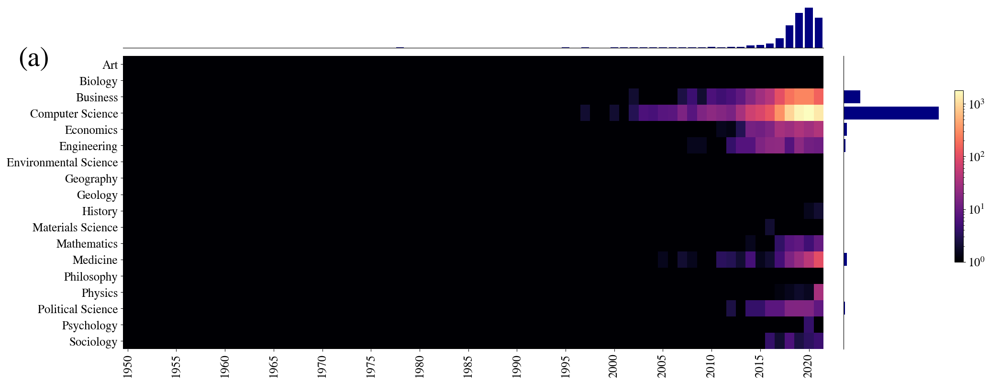

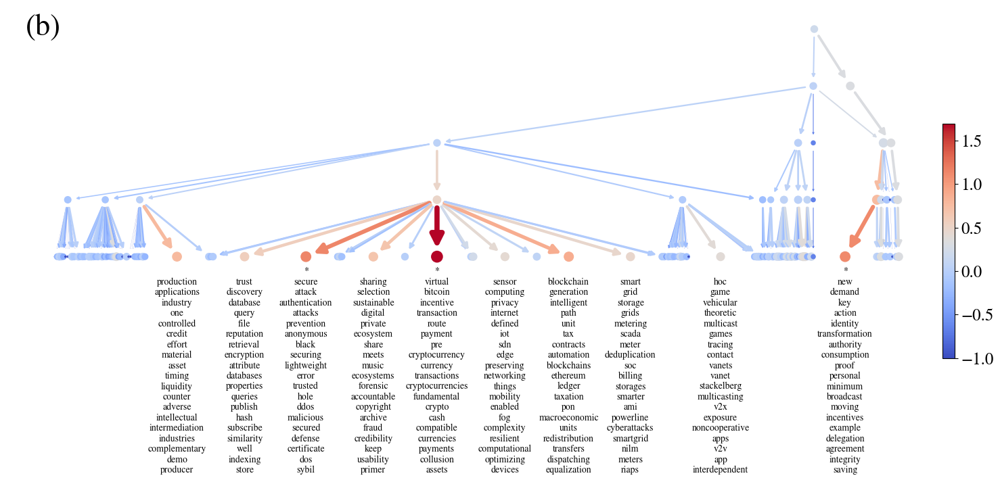

LEVEL 1 - CLUSTER 40



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'bitcoin', 'voting', 'proof', 'secure', 'ethereum', 'blockchains', 'contracts', 'transaction', 'cryptocurrency', 'payment', 'anonymous', 'authentication', 'ledger', 'peer', 'transactions', 'cryptocurrencies', 'identity', 'stake', 'byzantine', 'sharding', 'signature', 'trusted', 'verifiable', 'token', 'p2p', 'pki', 'permissionless', 'dag', 'anonymity', 'signatures', 'payments', 'lightning', 'pow', 'certificate', 'lightweight', 'oracle', 'dns', 'cryptography', 'asset', 'trustless', 'proofs', 'permissioned', 'ledgers', 'currency', 'securing', 'name', 'cash', 'incentives', 'solidity'] 

---> TOPIC 347		normalized mixture proportion = 9.1335		mixture proportion = 0.0101
	30 WORDS - bitcoin - cryptocurrency - currency - cryptocurrencies - fundamental - crypto - currencies - coin - pools - dao - wallet - bitcoins - miner - sentiment - offerings - fintech - libra - wallets - laundering - daos 

---> TOPIC 306		normalized mixture proport

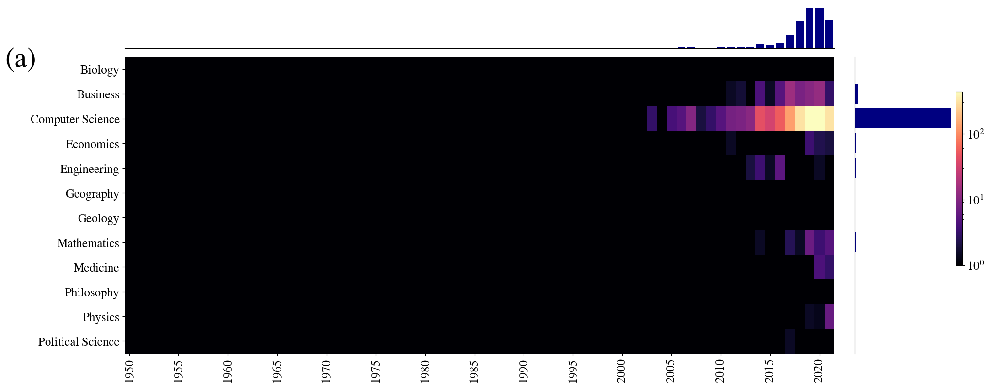

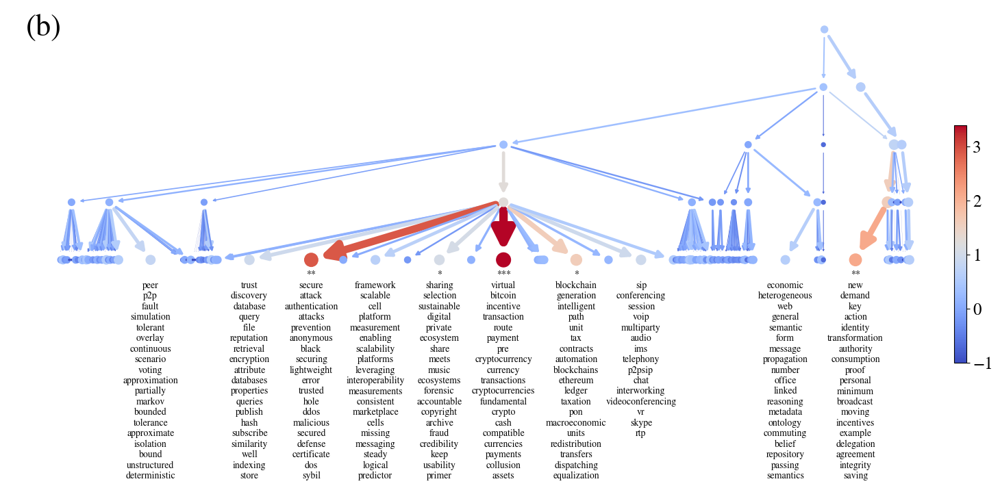

LEVEL 1 - CLUSTER 10



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'identity', 'digital', 'healthcare', 'ledger', 'contracts', 'ethereum', 'secure', 'sovereign', 'blockchains', 'covid', 'bitcoin', 'hyperledger', 'care', 'authentication', 'ecosystem', 'personal', 'verifiable', 'medical', 'payment', 'transaction', 'credentials', 'identifiers', 'permissioned', 'proof', 'cryptocurrency', 'trusted', 'certificate', 'cybersecurity', 'cryptocurrencies', 'electronic', 'transactions', 'preprint', 'credential', 'securing', 'pandemic', 'identities', 'ecosystems', 'record', 'gdpr', 'trustworthy', 'biometric', 'certificates', 'trustless', 'crowdfunding', 'donation', 'ledgers', 'anonymous', 'medicine', 'currency'] 

---> TOPIC 306		normalized mixture proportion = 9.5542		mixture proportion = 0.0153
	39 WORDS - blockchain - contracts - blockchains - ethereum - ledger - hyperledger - ipfs - permissioned - cybersecurity - ledgers - trustless - tokens - gdpr - dlt - interplanetary - iota - dapp - immutable - crow

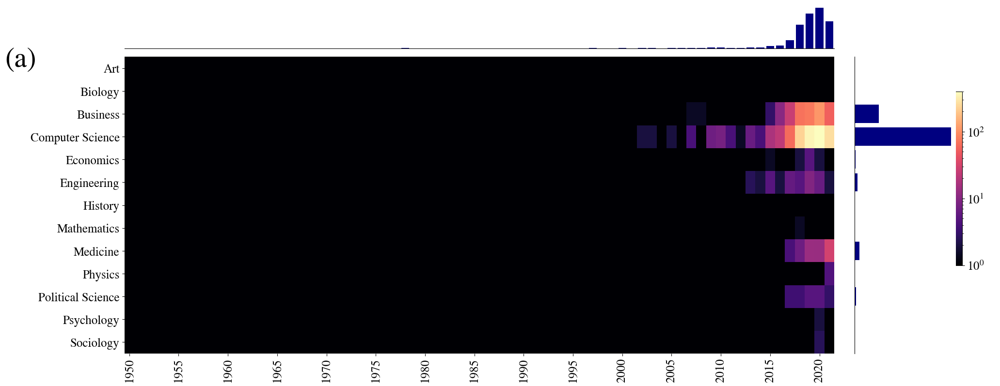

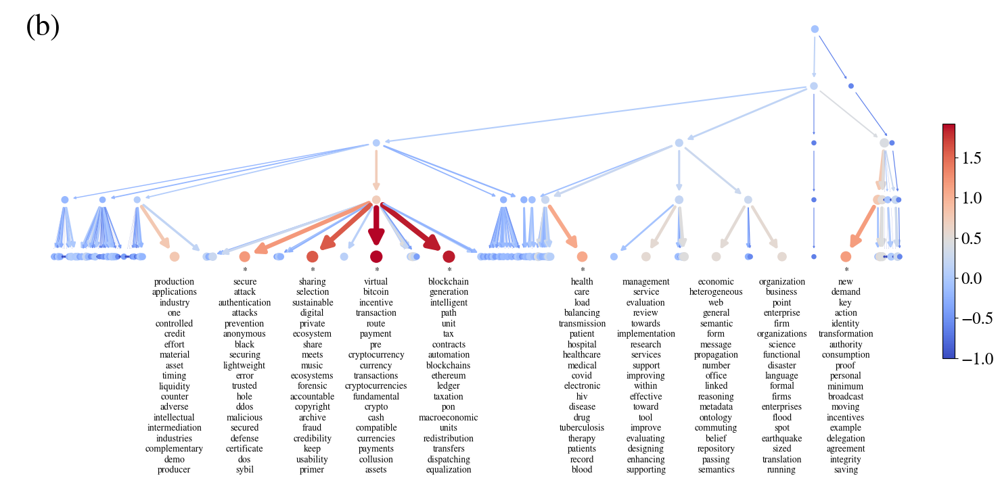

LEVEL 1 - CLUSTER 81



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'healthcare', 'electronic', 'medical', 'record', 'secure', 'food', 'records', 'manufacturing', 'logistics', 'personal', 'agriculture', 'ledger', 'authentication', 'securing', 'ehr', 'hyperledger', 'integrity', 'covid', 'ipfs', 'agri', 'care', 'contracts', 'use', 'signature', 'trusted', 'secured', 'permissioned', 'traceable', 'ethereum', 'transaction', 'provenance', 'emr', 'hospital', 'blockchains', 'iomt', 'biomedical', 'medicine', 'ensure', 'trustworthy', 'lightweight', 'medrec', 'consent', 'cash', 'encryption', 'attribute', 'ensuring', 'farming', 'logistic', 'storing'] 

---> TOPIC 306		normalized mixture proportion = 9.8453		mixture proportion = 0.0157
	39 WORDS - blockchain - contracts - blockchains - ethereum - ledger - hyperledger - ipfs - permissioned - cybersecurity - ledgers - trustless - tokens - gdpr - dlt - interplanetary - iota - dapp - immutable - crowdfunding - incentivized 

---> TOPIC 278		normalized mixture pro

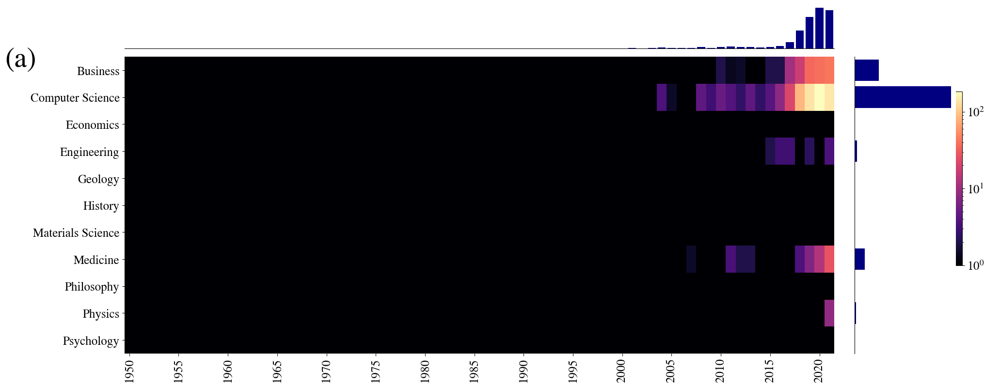

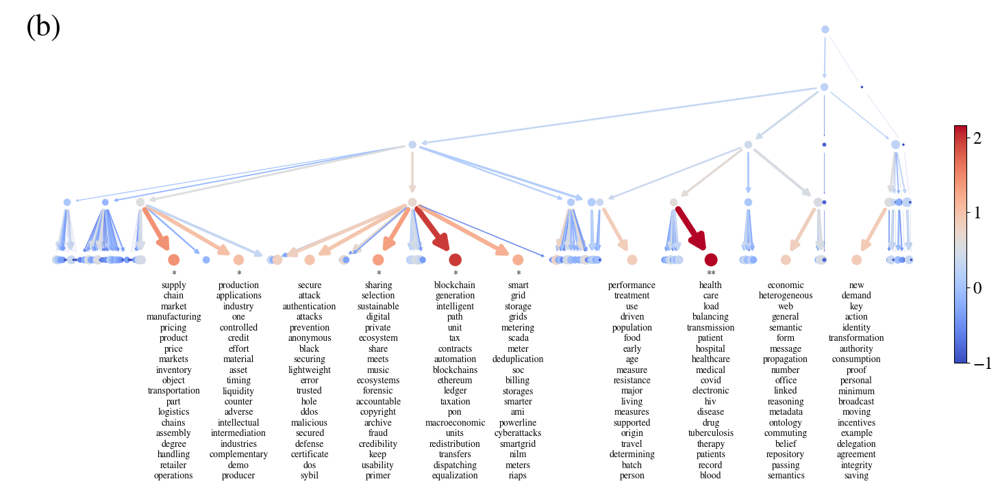

LEVEL 1 - CLUSTER 121



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'iot', 'secure', 'things', 'security', 'cloud', 'authentication', 'edge', 'enabled', 'vehicular', 'fog', 'trusted', 'lightweight', 'ledger', 'devices', 'contracts', 'securing', 'blockchains', 'ipfs', 'integrity', 'ethereum', 'encryption', 'attribute', 'thing', 'trustworthy', 'provenance', 'vanets', 'proof', 'permissioned', 'auditing', 'secured', 'vanet', 'hoc', 'personal', 'anonymous', 'empowered', 'encrypted', 'hyperledger', '6g', 'cybersecurity', 'iov', 'm2m', 'ledgers', 'iiot', 'interplanetary', 'gdpr', 'v2x', 'firmware', 'forensics', 'offloading'] 

---> TOPIC 306		normalized mixture proportion = 10.3373		mixture proportion = 0.0164
	39 WORDS - blockchain - contracts - blockchains - ethereum - ledger - hyperledger - ipfs - permissioned - cybersecurity - ledgers - trustless - tokens - gdpr - dlt - interplanetary - iota - dapp - immutable - crowdfunding - incentivized 

---> TOPIC 154		normalized mixture proportion = 7.0640		m

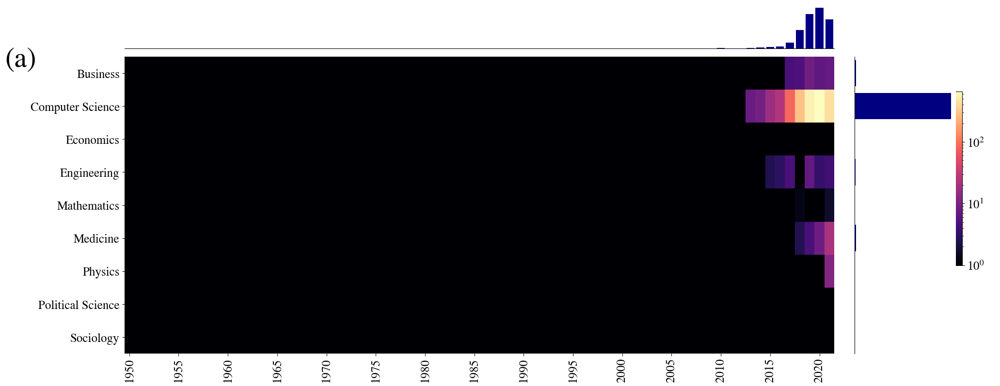

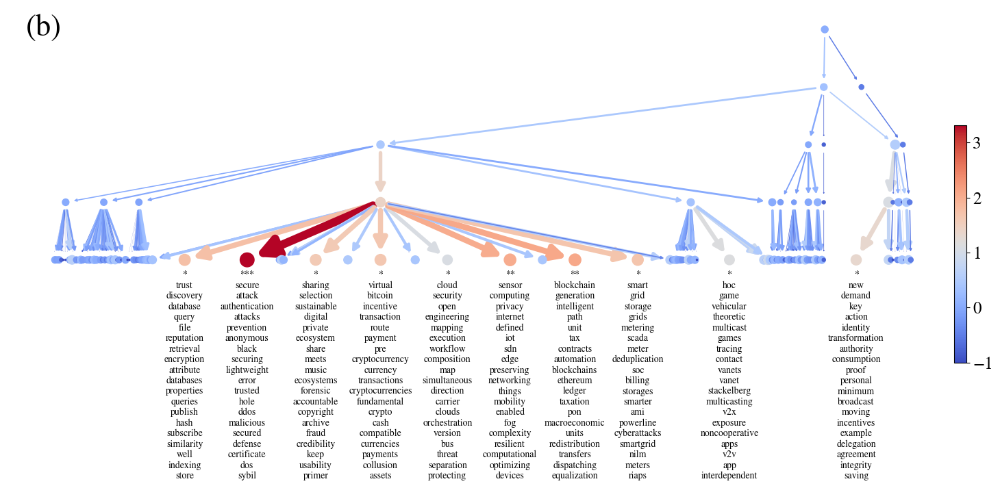

LEVEL 1 - CLUSTER 90



/tmp/2207198.1.all.q/ipykernel_5963/66089762.py:311: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout(rect=rect)


50 MOST FREQUENT WORDS IN THE TOPICS ----> ['blockchain', 'bitcoin', 'digital', 'cryptocurrency', 'financial', 'cryptocurrencies', 'currency', 'money', 'finance', 'economy', 'covid', 'crypto', 'defi', 'blockchains', 'currencies', 'payment', 'contracts', 'peer', 'exchanges', 'bank', 'economics', 'coin', 'ecosystem', 'ledger', 'dao', 'token', 'asset', 'transaction', 'banking', 'makers', 'ethereum', 'assets', 'transactions', 'ledgers', 'pandemic', 'liquidity', 'stablecoins', 'libra', 'offerings', 'tokens', 'payments', 'trustless', 'stablecoin', 'volatility', 'economies', 'icos', 'fintech', 'cash', 'dlt', 'sok'] 

---> TOPIC 347		normalized mixture proportion = 10.5665		mixture proportion = 0.0115
	30 WORDS - bitcoin - cryptocurrency - currency - cryptocurrencies - fundamental - crypto - currencies - coin - pools - dao - wallet - bitcoins - miner - sentiment - offerings - fintech - libra - wallets - laundering - daos 

---> TOPIC 306		normalized mixture proportion = 6.0183		mixture proport

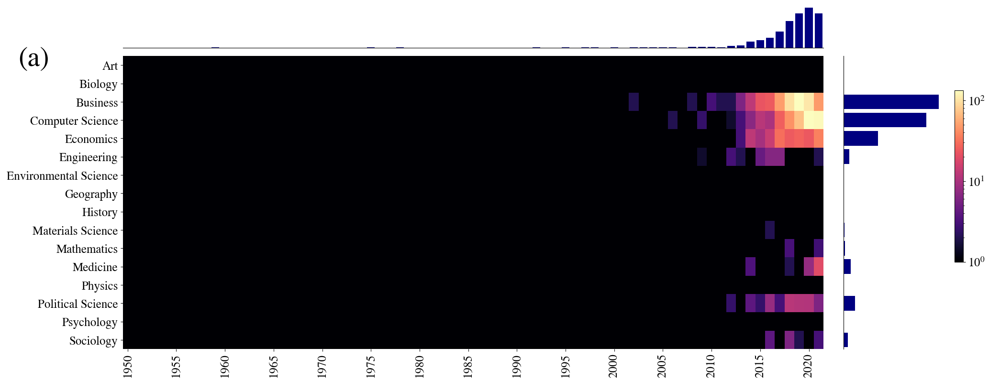

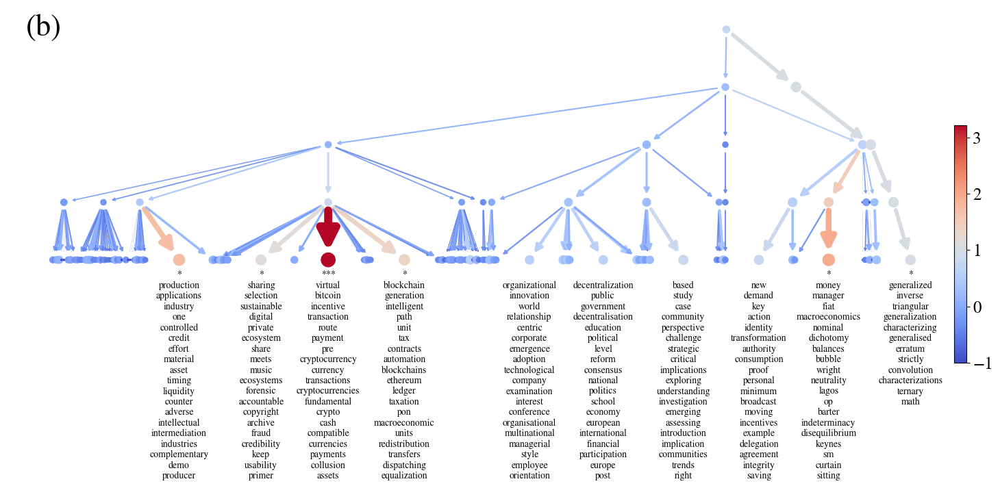

In [74]:
cluster = 8
lev = 2
centralities_to_print = ['citations_overall','in_degree','eigenvector','betweenness','closeness','pagerank','katz']

x = analyse_cluster(lev = lev, top_level_topics=6, bottom_level_topics = 2, cluster=cluster, centralities_to_print=centralities_to_print, 
                 max_num_topics_to_represent = 10, num_most_frequent_words = 50, num_papers_to_show = 1, do_sample_knowledge_flow = True,
                 multiplicator_size_nodes=50, multiplicator_size_edges=0.04, multiplicator_ypos=0.25, fontsize_graph=10,
                    colorbar_log_heatmap=True)
for child in hierarchy_docs[lev][cluster]:
    x = analyse_cluster(lev = lev-1, top_level_topics=6, bottom_level_topics = 1, cluster=child, centralities_to_print=centralities_to_print, 
             max_num_topics_to_represent = 10, num_most_frequent_words = 50, num_papers_to_show = 1, do_sample_knowledge_flow = False,
             multiplicator_size_nodes=50, multiplicator_size_edges=0.04, multiplicator_ypos=0.25, fontsize_graph=10,
                                colorbar_log_heatmap=True, )

### Clusters hierarchy network

In [89]:
def create_hierarchy_network_docs(partition, top_level, bottom_level, 
                             num_words_to_represent, ax, fig,
                             threshold_num_papers = 100, max_num_clusters_to_represent=1000,
                             multiplicator_size_nodes=1, multiplicator_size_edges=1,
                             multiplicator_ypos=0.1,
                             fontsize = 10, num_spaces = 200,
                             do_barplot = True,
                             number_bars = 9,
                             MAX_CHARS = 15):
    
    if top_level > max(list(hierarchy_words.keys())):
        top_level = max(list(hierarchy_words.keys())) + 1
    cmap = matplotlib.cm.get_cmap('magma')#('winter') coolwarm
    # Let's create a tree undirected network
    G = nx.DiGraph()
    # this is just for drawing
    node_size = {} # key is node name
    edge_size = {} # key is tuple of source,target
    
    # let's find the root at the top_level of topics as the one with highest normalized mixture proportion with the chosen cluster
    root = partition
    root_name = name_node(top_level,root)
    node_size[root_name] = len([x for x in name2partition_by_level[top_level].keys() if name2partition_by_level[top_level][x]==root]) * multiplicator_size_nodes #get_mixture_proportion_between_cluster_and_topic(level_partition, partition, top_level_topics, root) * multiplicator_size_nodes
    G.add_node(root_name)
    
            

    # this is just to remember which nodes have been selected at each level
    selected_nodes_by_level = {top_level:[root]}
    
    # Let's add all the children until bottom_level from root, saving node_size of each node as the normalized mixture proportion
    # ACHTUNG: All names are of the type level_index, then they will be changed!
    for l in range(top_level, bottom_level,-1):
        selected_nodes_by_level[l-1] = []
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_docs[l])
            m2 = min(hierarchy_docs[l-1])
            
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_docs[l][i+m])) - m2
            selected_nodes_by_level[l-1] += list(children)
            
            for child in children:
                child_name = name_node(l-1,child)
                node_size[child_name] = len([x for x in name2partition_by_level[l-1].keys() if name2partition_by_level[l-1][x]==child]) * multiplicator_size_nodes # get_mixture_proportion_between_cluster_and_topic(level_partition, partition, l-1, child) * multiplicator_size_nodes
    
    # There are nodes with negative node_size, so in order to display all of them correctly let's subtract the minimum
    min_node_size_old = min(list(node_size.values()))
    max_node_size_old = max(list(node_size.values()))
    node_size_old = node_size.copy()
    node_size = {x:y - min_node_size_old + multiplicator_size_nodes*0.05 for x,y in node_size.items()}
    min_node_size = min(list(node_size.values()))
    max_node_size = max(list(node_size.values()))
    
    edge_size_sum = {}
    edge_counter = {}
    node_colors = {}
    for l in range(bottom_level+1,top_level+1):
        # Let's highlight the top 10 topics at the bottom level, changing their names to the list of words in their topic
        if l-1 == bottom_level:
            leaves = {}
            for i in selected_nodes_by_level[l]:
                m = min(hierarchy_docs[l])
                m2 = min(hierarchy_docs[l-1])
                # topics at lower level in the hierarchy from the superior node
                children = np.array(list(hierarchy_docs[l][i+m])) - m2
                for child in children:
                    child_name = name_node(l-1,child)
                    if node_size_old[child_name] > 0:
                        leaves[child_name] = node_size_old[child_name]
            leaves = pd.Series(leaves)
            highlighted_leaves = set(leaves.loc[leaves>threshold_num_papers*multiplicator_size_nodes].sort_values(ascending=False).iloc[:max_num_clusters_to_represent].index.values)
            
        # Let's add all of these nodes in the Graph, using their new names
        for i in selected_nodes_by_level[l]:
            m = min(hierarchy_docs[l])
            m2 = min(hierarchy_docs[l-1])
            # topics at lower level in the hierarchy from the superior node
            children = np.array(list(hierarchy_docs[l][i+m])) - m2
            sum_weights_children = 0
            # Let's add the nodes
            child_names = []
            father_name = name_node(l,i)
            for child in children:    
                child_name = name_node(l-1,child)
                if l-1 == bottom_level:
                    if child_name in highlighted_leaves and len(keywords_clusters[l-1][child]) > 0:
                        # Let's change previous label with the list of keywords
                        list_labels = keywords_clusters[l-1][child].split("\n")[:num_words_to_represent]
                        # Add also number of cluster
                        new_child_name = child_name + '\n' + "\n" + child_name[2:] + name_node(l-1,child, list_labels = list_labels, num_spaces=num_spaces)
                        node_size[new_child_name] = node_size[child_name]
                        del node_size[child_name]
                        highlighted_leaves.remove(child_name)
                        child_name = new_child_name
                        highlighted_leaves.add(new_child_name)
                    node_colors[child_name] = (np.log(node_size[child_name]))/(np.log(max_node_size))
                child_names.append(child_name)
                sum_weights_children += node_size[child_name]
                G.add_node(child_name)
            node_colors[father_name] = (np.log(node_size[father_name]))/(np.log(max_node_size)) # np.sum([node_colors[child_name]*node_size[child_name] for child_name in child_names])/sum_weights_children
            
                
            # Let's add the edges
            edge_size_sum[father_name] = 0
            edge_counter[father_name] = 0
            for child_name in child_names:
                if l == bottom_level+1:
                    edge_size[(father_name,child_name)] = node_size[child_name] - min_node_size + 1
                else:
                    edge_size[(father_name,child_name)] = edge_size_sum[child_name] #/ edge_counter[child_name]
                edge_size_sum[father_name] += edge_size[(father_name,child_name)]
                edge_counter[father_name] += 1
                G.add_edge(father_name,child_name)
            
    
    # DRAWING
    pos = graphviz_layout(G, prog='dot')#{"fontsize":fontsize, "labelfontsize":fontsize})
    y_pos = sorted(list(set([_[1] for _ in list(pos.values())])))

    y_pos_max = y_pos[-1]
    y_pos_min = y_pos[0]
    y_pos_min_new = y_pos_min + (y_pos_max-y_pos_min)*multiplicator_ypos
    y_pos_dict = {y_pos_min:y_pos_min_new, y_pos_max:y_pos_max}
    no_mid_y = len(y_pos[1:-1])
    for index,y in enumerate(y_pos[1:-1]):
        y_pos_dict[y] = y_pos_min_new + (y_pos_max - y_pos_min_new)/(no_mid_y+1)*(index+1)
    for k,v in pos.items():
        pos[k] = (v[0],y_pos_dict[v[1]])
    nx.draw_networkx_nodes(G,pos,node_size=[node_size[node] for node in pos.keys()],ax=ax,node_color=[cmap(node_colors[node]) for node in pos.keys()])
    
    counter = 0
    pos_old = pos.copy()
    for node,(x,y) in pos.copy().items():
        if len(node)>10:
            counter += 1
            if counter % 2 == 0:
                pos[node[:node.index("\n")]+"\n"+"\n"+"|\n"*number_bars + node[node.index("\n") + 2:]] = pos[node]
                del pos[node]
    
    labels = {x:x[x.index("\n")+1:].replace(" nan ","").replace("  ","").replace(" ","-\n-") if len(x)>10 else "" for x in pos.keys()}
    
    labels = {}
    for x in pos.keys():
        if len(x)>10:
            final_label = ""
            lines = x[x.index("\n")+1:].replace(" nan ","").replace("  ","").split("\n")
            for line in lines:
                words = line.split(" ")
                tmp_word = ""
                
                counter = 0
                while counter < len(words):
                    word = words[counter]
                    if (len(tmp_word + word) <= MAX_CHARS) or len(tmp_word)==0:
                        tmp_word += word + " "
                        counter += 1
                    else:
                        tmp_word = tmp_word[:-1] + "-\n-"
                        final_label += tmp_word
                        tmp_word = ""
                final_label += tmp_word + "\n"
                
            labels[x] = final_label
        else:
            labels[x] = ""
        
    l = nx.draw_networkx_labels(G,pos,font_size=fontsize, font_color = 'black',font_family="STIXGeneral",labels=labels, verticalalignment="top",  ax=ax)

    for i,edge in enumerate(G.edges()):
        nx.draw_networkx_edges(G, pos_old, edgelist=[edge], width=np.log(edge_size[edge])* multiplicator_size_edges, arrowsize=np.log(edge_size[edge])* multiplicator_size_edges * 5,
                               edge_color = cmap(node_colors[edge[1]]),ax=ax)#arrowstyle='fancy')
    ax.axis('off')
    pos_y_values = [_[1] for _ in pos.values()]
    ax.set_ylim([min(pos_y_values)*0,max(pos_y_values)*1.05])
    
    vmin = min(node_size_old.values())/multiplicator_size_nodes
    vmax = max(node_size_old.values())/multiplicator_size_nodes
    
    if do_barplot:
        fig.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.LogNorm(vmin=vmin,vmax=vmax), cmap=cmap), ax=ax,shrink=0.5,pad=0.) # Normalize
        
    os.makedirs(paper_figures_folder+"cluster_analysis/",exist_ok=True)
    fig.savefig(paper_figures_folder + f"cluster_analysis/hierarchy_clusters_top_level_{top_level}_cluster_{cluster}_threshold_{threshold_num_papers}.pdf")
    if not do_barplot:
        return pos, vmin, vmax
    return pos

/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/matplotlib/patches.py:3024: RuntimeWarning: invalid value encountered in double_scalars
  cos_t, sin_t = head_length / head_dist, head_width / head_dist
/data/home/ahw701/env_enrico/envs/gt/lib/python3.9/site-packages/matplotlib/patches.py:3024: RuntimeWarning: invalid value encountered in double_scalars
  cos_t, sin_t = head_length / head_dist, head_width / head_dist


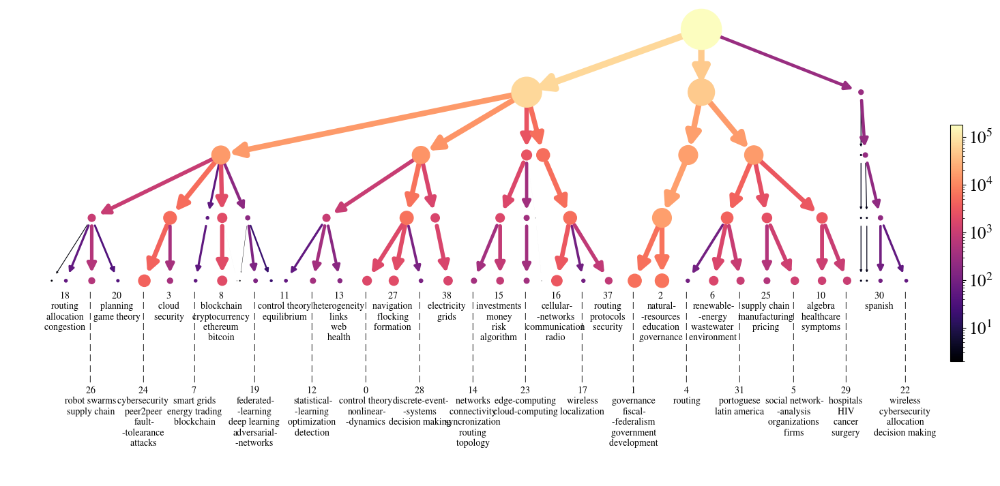

In [90]:
figsize=(21,9)
fig = plt.figure(figsize=figsize)
ax = plt.gca()
# plt.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.Normalize(vmin=0,vmax=1)), ax=ax,shrink=0.5,pad=0.,fraction=0.2)
pos = create_hierarchy_network_docs(partition=0, top_level=6, bottom_level=2, 
                             max_num_clusters_to_represent=10000, num_words_to_represent=20, 
                             multiplicator_size_nodes=.01, multiplicator_size_edges=1, multiplicator_ypos=0.30,
                             fontsize = 10, ax=ax, fig=fig, threshold_num_papers = 500, num_spaces=50)

## SI figure for annotation

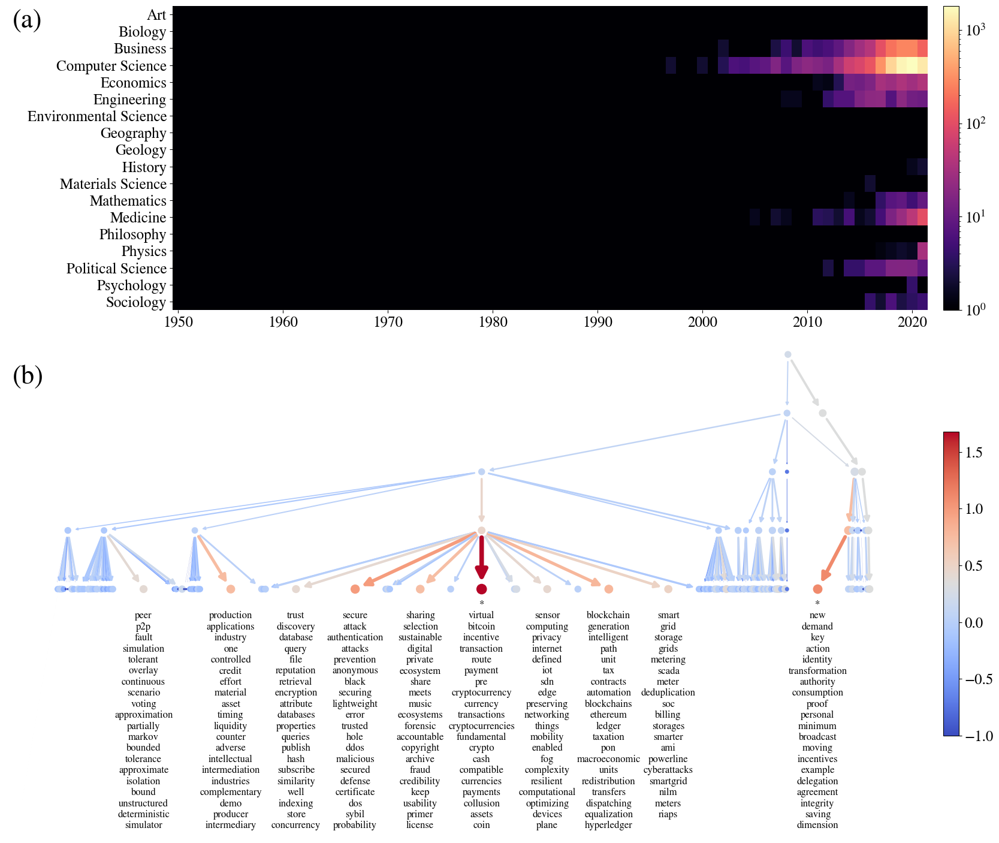

In [49]:
lev = 3
top_level_topics=6
bottom_level_topics = 2
cluster=6
threshold=0.2


fig = plt.figure(figsize = (21,18))

outer = gridspec.GridSpec(nrows=2, ncols=1,height_ratios=[0.9,1.5],hspace=0.05)
inner = gridspec.GridSpecFromSubplotSpec(1, 3,
                        subplot_spec=outer[0],width_ratios=[4,20,1],wspace=0.05)

ax = plt.Subplot(fig, inner[1])

data = year_cluster_field_no_papers_df_by_level[lev].copy()
fig,ax = heatmap(df=data, fixed_labels=["cluster"], x_label="year", y_label="field", values_label="no_papers", 
        costrains_equal={"cluster":set([cluster]), "year":set(range(1950,2022))}, colorbar_log = True, use_keywords=False, do_barplot=False,
                     fig = fig,ax=ax)
fig.add_subplot(ax)
ax.set_xticks([x+0.5 for x in range(0,2022-1950,10)])
ax.set_xticklabels(range(1950,2022,10),rotation = 0)

# Add colorbar
ax_cmap = plt.Subplot(fig, inner[2])
vmin = max(1,data.no_papers.unique().min())
vmax = data.no_papers.unique().max()
cb = fig.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax), cmap=plt.get_cmap("magma")), ax=ax_cmap,shrink=1,pad=0., fraction=1,orientation="vertical")
ax_cmap.tick_params(labelsize=20) 
ax_cmap.axis('off')
fig.add_subplot(ax_cmap)


fig.text(0.13, 0.86, "(a)", fontsize=32, transform=fig.transFigure,color="black")


# fig,ax = heatmap(df=data, fixed_labels=["cluster"], x_label="year", y_label="field", values_label="no_papers", 
#         costrains_equal={"cluster":set([partition]), "year":set(range(1950,2022))}, colorbar_log = colorbar_log_heatmap, use_keywords=False, do_barplot=False,
#                      fig = fig,ax=ax)
# # fig.add_subplot(ax)


inner = gridspec.GridSpecFromSubplotSpec(1, 2,
                        subplot_spec=outer[1],width_ratios=[20,1],wspace=0.05)
ax = plt.Subplot(fig, inner[0])
cmap, vmin, vmax = create_hierarchy_network_topics(level_partition=lev, partition=cluster, top_level_topics=top_level_topics, bottom_level_topics=bottom_level_topics, 
                         max_num_topics_to_represent=10, num_words_to_represent=20, 
                         multiplicator_size_nodes=50, multiplicator_size_edges=0.04, 
                         multiplicator_ypos=0.285, fontsize = 12, ax=ax)

fig.add_subplot(ax)
inner = gridspec.GridSpecFromSubplotSpec(1, 3,
                        subplot_spec=outer[1],width_ratios=[4,20,1],wspace=0.05)
ax_cmap = plt.Subplot(fig, inner[2])
fig.colorbar(matplotlib.cm.ScalarMappable(norm=matplotlib.colors.Normalize(vmin=vmin,vmax=vmax), cmap=cmap), ax=ax_cmap,shrink=0.9/1.5,pad=0., fraction=1,orientation="vertical")
ax_cmap.tick_params(labelsize=20) 
ax_cmap.axis('off')
fig.add_subplot(ax_cmap)

fig.text(0.13, 0.53, "(b)", fontsize=32, transform=fig.transFigure,color="black")
fig.savefig(f"{paper_figures_folder}FigureSI_annotation_blockchain.pdf",bbox_inches='tight')
fig.savefig(f"{paper_figures_folder}FigureSI_annotation_blockchain.png",bbox_inches='tight')